In [ ]:
#  Imports principaux
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import json
from pathlib import Path
import os

#  Accès aux dossiers du projet (depuis n'importe où dans le notebook)
while not (Path.cwd() / "data").exists():
    os.chdir("..")
BASE_DIR = Path.cwd()

#  Dossiers utiles
DATA_DIR = BASE_DIR / "data"
TRANSFORMED_DIR = DATA_DIR / "transformed_data"
MODIFIED_DIR = DATA_DIR / "modified_data"
MODELS_DIR = BASE_DIR / "models" / "Quantile" / "lightgbm_quantile"

#  Fréquence à analyser
FREQ = "daily"
suffixe = "withoutlags"
#  Chargement des fichiers d'entraînement
df = pd.read_csv(TRANSFORMED_DIR / f"train_{FREQ}_lightgbm_quantile_{suffixe}.csv")
df_raw = pd.read_csv(MODIFIED_DIR / f"train_{FREQ}.csv")
df_raw["date"] = pd.to_datetime(df_raw["date"])
df["date"] = df_raw["date"]  # Ajout de la date dans le dataframe transformé

#  Chargement des métriques
with open(MODELS_DIR / f"metrics_{FREQ}_{suffixe}.json") as f:
    metrics = pd.read_json(f)

#  Chargement des prédictions
preds_path = MODELS_DIR / f"preds_{FREQ}_direct_{suffixe}.csv"
df_preds = pd.read_csv(preds_path)
df_preds["date"] = pd.to_datetime(df_preds["date"])

#  Chargement des vraies valeurs de test pour comparaison
df_test_raw = pd.read_csv(MODIFIED_DIR / f"test_{FREQ}.csv")
df_test_raw["date"] = pd.to_datetime(df_test_raw["date"])

#  Fusion prédictions + vérité terrain
df_visu = pd.merge(
    df_preds,
    df_test_raw[["date", "insee_region", "conso_elec_mw", "conso_gaz_mw"]],
    on=["date", "insee_region"],
    how="left"
)

#  Aperçu rapide
df_visu.head(10)


,date,insee_region,conso_elec_mw_q5,conso_elec_mw_q50,conso_elec_mw_q95,conso_gaz_mw_q5,conso_gaz_mw_q50,conso_gaz_mw_q95,conso_elec_mw,conso_gaz_mw
0,2022-01-23,32,289733.512412,324088.787921,358101.211994,229038.946937,273260.718936,336307.207719,306155.0,303728.0
1,2022-01-23,27,124639.546969,136245.155319,161968.244629,82227.381937,97413.973129,146927.501605,140415.0,103124.0
2,2022-01-23,24,122326.520821,137056.006633,153031.407080,64503.929833,71885.593798,121704.421395,138688.0,77697.0
3,2022-01-23,11,263026.765738,362961.278086,502649.082723,94035.880642,251287.256157,406217.837054,480374.0,406747.0
4,2022-01-23,52,158727.377949,174004.396719,206116.097106,78276.167661,98283.977577,162346.234959,189539.0,115611.0
5,2022-01-24,93,268296.173657,296322.469951,283412.231990,120149.752270,187122.593628,220559.783415,301679.0,179587.0
6,2022-01-24,84,385165.801617,485860.220760,513687.729941,215154.698752,288287.077643,322507.283854,502549.0,286309.0
7,2022-01-24,76,276669.071333,291180.448827,313149.613936,106379.067476,121146.727045,147857.840232,305049.0,114423.0
8,2022-01-24,75,295355.924327,338724.036599,372147.291725,143197.688620,170592.325388,252117.342669,354884.0,170134.0
9,2022-01-24,53,158664.662214,170590.143662,192600.679167,71037.292529,79763.125611,90835.370361,188379.0,107560.0


In [26]:
df_visu.shape

(9929, 10)

In [27]:
df.describe()

,conso_elec_mw,conso_gaz_mw,temperature_2m_max,temperature_2m_min,precipitation_sum,apparent_temperature_max,apparent_temperature_min,rain_sum,snowfall_sum,precipitation_hours,...,temp_mean,apparent_temp_mean,temp_range,wind_range,temp_radiation_interaction,sunrise_sunset_diff,radiation_et0_ratio,sunshine_ratio,sun_week_interaction,date
count,39715.000000,39715.000000,39715.000000,39715.000000,39715.000000,39715.000000,39715.000000,39715.000000,39715.000000,39715.000000,...,39715.000000,39715.000000,39715.000000,39715.000000,39715.000000,39715.000000,39715.000000,39715.000000,39715.000000,39715
mean,215700.569810,106299.492081,16.607453,8.730633,2.146096,14.741083,6.509817,2.102261,0.031552,3.995996,...,12.669043,10.625450,7.876820,19.356759,195.936090,43987.618784,5.702695,0.640213,1.916253,2017-07-13 07:00:03.172604672
min,59666.000000,6564.000000,-4.200000,-10.800000,0.000000,-10.600000,-15.400000,0.000000,0.000000,0.000000,...,-7.200000,-12.050000,0.500000,1.600000,-75.468000,28680.000000,0.344535,0.000000,0.000000,2013-01-01 00:00:00
25%,132952.500000,44830.500000,10.800000,4.100000,0.000000,7.500000,0.600000,0.000000,0.000000,0.000000,...,7.600000,4.200000,5.300000,14.100000,37.905000,35040.000000,4.647796,0.449984,0.392768,2015-04-08 00:00:00
50%,197237.000000,82294.000000,16.200000,8.700000,0.200000,14.100000,6.100000,0.100000,0.000000,1.000000,...,12.350000,10.000000,7.400000,18.200000,135.408000,44040.000000,5.484315,0.771572,1.682638,2017-07-13 00:00:00
75%,277637.500000,136853.500000,22.000000,13.500000,2.300000,21.400000,12.400000,2.300000,0.000000,7.000000,...,17.650000,16.800000,10.100000,23.200000,311.243000,52860.000000,6.568159,0.888966,3.210662,2019-10-19 00:00:00
max,657007.000000,623689.000000,40.900000,25.700000,89.400000,42.600000,30.800000,89.400000,16.170000,24.000000,...,32.550000,34.400000,21.400000,68.800000,943.715500,59340.000000,15.717546,0.931298,5.587675,2022-01-23 00:00:00
std,101667.685967,86961.961254,7.507012,6.119886,4.329319,9.097482,7.553494,4.293355,0.319909,5.405276,...,6.638008,8.153669,3.371032,7.593419,187.074052,9330.881082,1.750483,0.300159,1.664195,NaN


In [ ]:
#  Extraire les informations temporelles
df_visu["month"] = df_visu["date"].dt.month
df_visu["weekday"] = df_visu["date"].dt.weekday
df_visu["dayofyear"] = df_visu["date"].dt.dayofyear

#  Ajout des saisons
df_visu["season"] = pd.cut(
    df_visu["month"],
    bins=[0, 3, 6, 9, 12],
    labels=["hiver", "printemps", "été", "automne"],
    include_lowest=True
)

#  Aperçu des ajouts
df_visu[["date", "month", "weekday", "season"]].head()


,date,month,weekday,season
0,2022-01-23,1,6,hiver
1,2022-01-23,1,6,hiver
2,2022-01-23,1,6,hiver
3,2022-01-23,1,6,hiver
4,2022-01-23,1,6,hiver


C:\Users\arnov\AppData\Local\Temp\ipykernel_25328\2283901193.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=rmse_df, x="Quantile", y="rmse", palette="viridis")


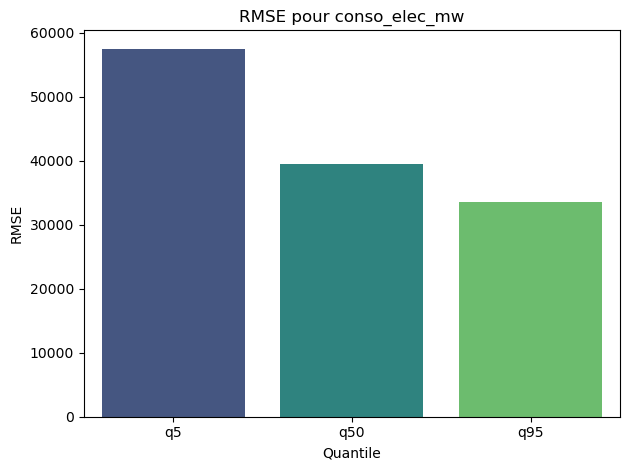

C:\Users\arnov\AppData\Local\Temp\ipykernel_25328\2283901193.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=rmse_df, x="Quantile", y="rmse", palette="viridis")


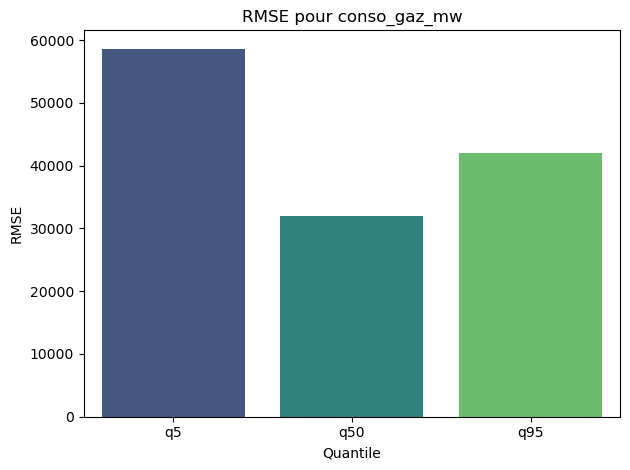

In [ ]:

#  Affiche les barplots des RMSE par quantile pour chaque target
for target in metrics.columns:
    # On extrait les valeurs de RMSE
    subdict = metrics[target].to_dict()
    rmse_df = pd.DataFrame.from_dict(subdict, orient="index")
    rmse_df["Quantile"] = rmse_df.index

    #  Plot
    sns.barplot(data=rmse_df, x="Quantile", y="rmse", palette="viridis")
    plt.title(f"RMSE pour {target}")
    plt.ylabel("RMSE")
    plt.xlabel("Quantile")
    plt.tight_layout()
    plt.show()


C:\Users\arnov\AppData\Local\Temp\ipykernel_25328\164563367.py:28: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=season_df, x="season", y="mae", palette="pastel")


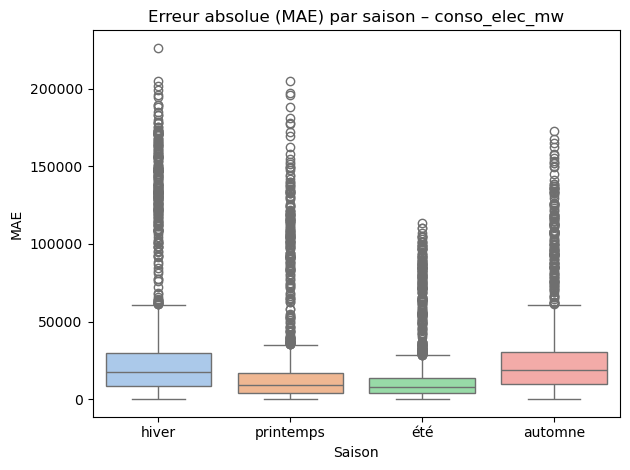

C:\Users\arnov\AppData\Local\Temp\ipykernel_25328\164563367.py:28: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=season_df, x="season", y="mae", palette="pastel")


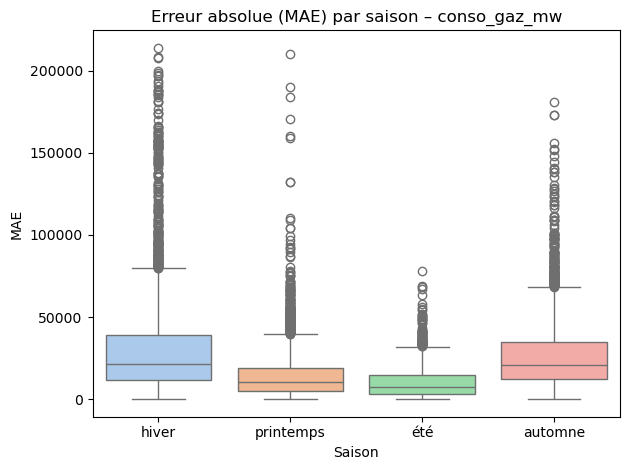

In [ ]:
from data_processing.transformation import transform_lightgbm_quantile

#  Chargement et transformation des données test
df_raw = pd.read_csv(MODIFIED_DIR / f"test_{FREQ}.csv")
df_raw["date"] = pd.to_datetime(df_raw["date"])
df = transform_lightgbm_quantile(df_raw.copy(), frequency=FREQ, save=False,lags=False)
df["date"] = df_raw["date"]  # pour conserver la date

#  Ajout infos temporelles
df["month"] = df["date"].dt.month
df["season"] = pd.cut(df["month"],
                      bins=[0, 3, 6, 9, 12],
                      labels=["hiver", "printemps", "été", "automne"],
                      include_lowest=True)

#  Calcul MAE q50 par saison
for target in ["conso_elec_mw", "conso_gaz_mw"]:
    true_vals = df[target].values
    pred_vals = df_visu[f"{target}_q50"].values

    if len(true_vals) != len(pred_vals):
        print(f" Erreur : taille différente pour {target} — true: {len(true_vals)}, pred: {len(pred_vals)}")
        continue

    mae = np.abs(true_vals - pred_vals)
    season_df = pd.DataFrame({"season": df["season"], "mae": mae})

    sns.boxplot(data=season_df, x="season", y="mae", palette="pastel")
    plt.title(f"Erreur absolue (MAE) par saison – {target}")
    plt.ylabel("MAE")
    plt.xlabel("Saison")
    plt.tight_layout()
    plt.show()


In [31]:
import matplotlib.pyplot as plt

def plot_predictions_split(df, y_true, preds_dict, target, step=10):
    """
    Affiche 4 sous-graphiques :
    - Quantile 5
    - Quantile 50 (médiane)
    - Quantile 95
    - Intervalle de prédiction (q10 à q90) + vérité
    """

    dates = df["date"].iloc[::step]
    true_values = y_true.iloc[::step]
    q5 = preds_dict["q5"].iloc[::step]
    q50 = preds_dict["q50"].iloc[::step]
    q95 = preds_dict["q95"].iloc[::step]

    fig, axs = plt.subplots(2, 2, figsize=(15, 10))
    fig.suptitle(f"Prédictions quantiles – {target}", fontsize=16)

    # Couleur douce pour la vérité
    true_color = "#444444"

    axs[0, 0].plot(dates, q5, label="q5", color="blue", alpha=0.6)
    axs[0, 0].plot(dates, true_values, label="Vérité", linestyle="--", color=true_color, linewidth=1, alpha=0.8)
    axs[0, 0].set_title("Quantile 5")
    axs[0, 0].legend()
    axs[0, 0].grid(alpha=0.3)

    axs[0, 1].plot(dates, q50, label="q50", color="orange", alpha=0.6)
    axs[0, 1].plot(dates, true_values, label="Vérité", linestyle="--", color=true_color, linewidth=1, alpha=0.8)
    axs[0, 1].set_title("Quantile 50 (médiane)")
    axs[0, 1].legend()
    axs[0, 1].grid(alpha=0.3)

    axs[1, 0].plot(dates, q95, label="q95", color="green", alpha=0.6)
    axs[1, 0].plot(dates, true_values, label="Vérité", linestyle="--", color=true_color, linewidth=1, alpha=0.8)
    axs[1, 0].set_title("Quantile 90")
    axs[1, 0].legend()
    axs[1, 0].grid(alpha=0.3)

    axs[1, 1].fill_between(dates, q5, q95, color="gray", alpha=0.3, label="Intervalle q10–q90")
    axs[1, 1].plot(dates, q50, label="q50", color="orange", linewidth=1.5)
    axs[1, 1].plot(dates, true_values, label="Vérité", linestyle="--", color=true_color, linewidth=1, alpha=0.8)
    axs[1, 1].set_title("Incertitude (q10–q90)")
    axs[1, 1].legend()
    axs[1, 1].grid(alpha=0.3)

    for ax in axs.flat:
        ax.set_xlabel("Date")
        ax.set_ylabel("Valeur")

    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()


📍 Région 32 – conso_elec_mw


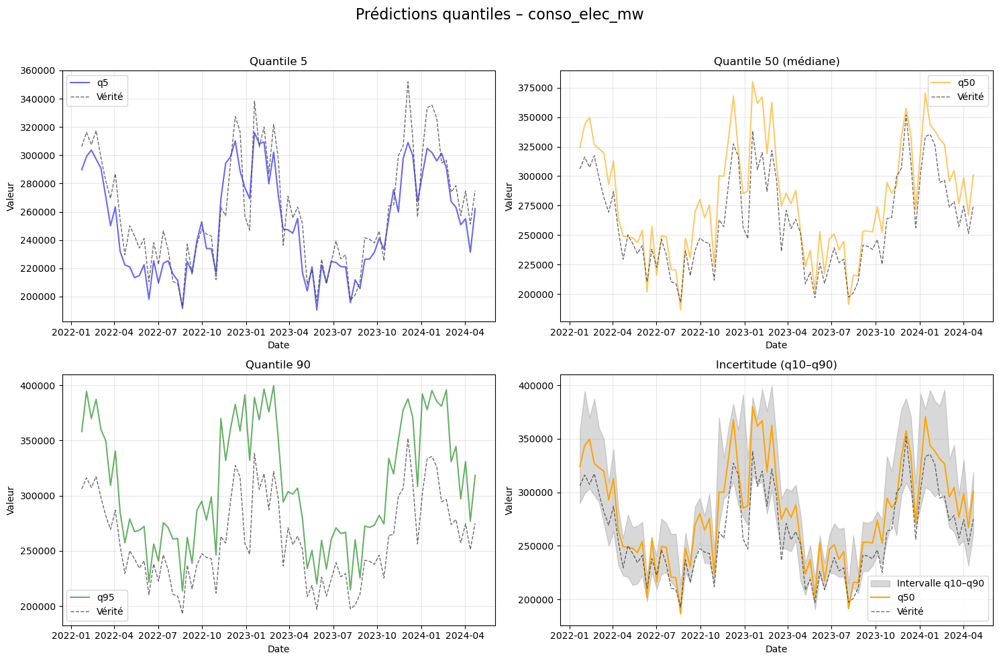

📍 Région 27 – conso_elec_mw


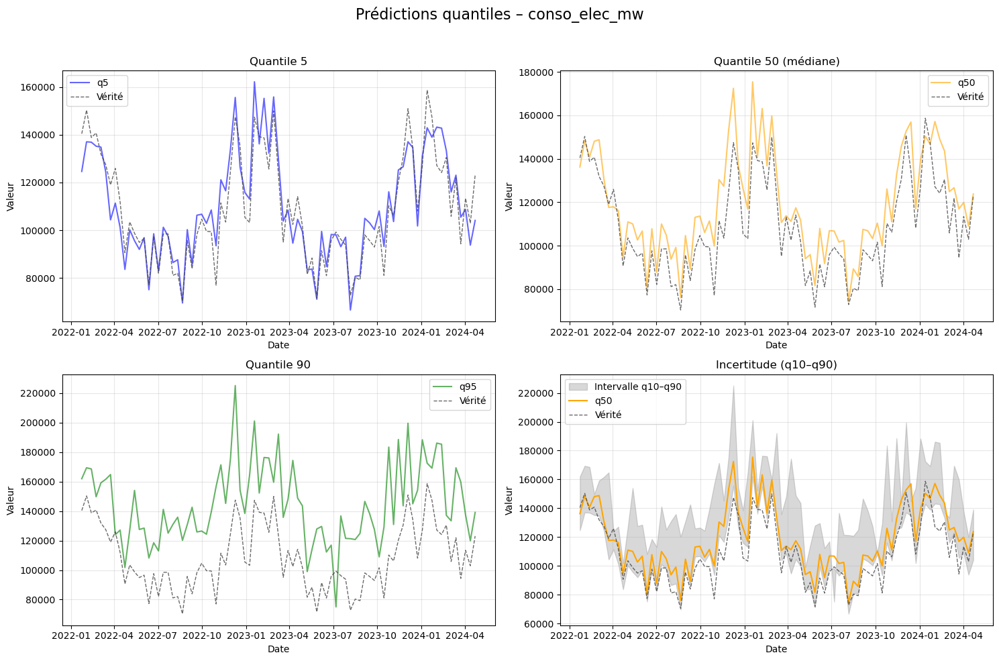

📍 Région 24 – conso_elec_mw


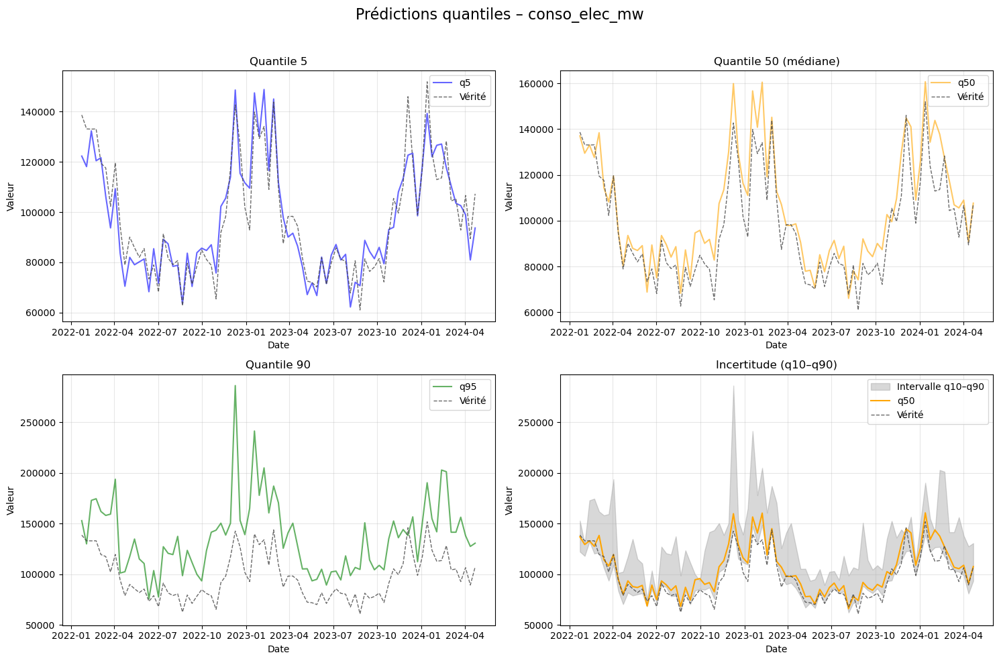

📍 Région 11 – conso_elec_mw


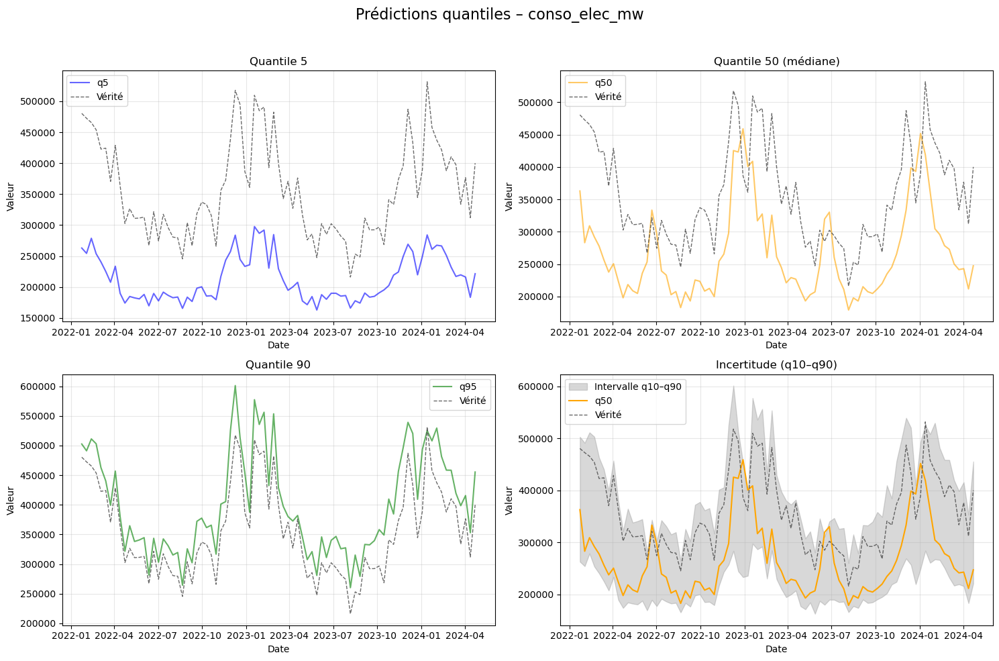

📍 Région 52 – conso_elec_mw


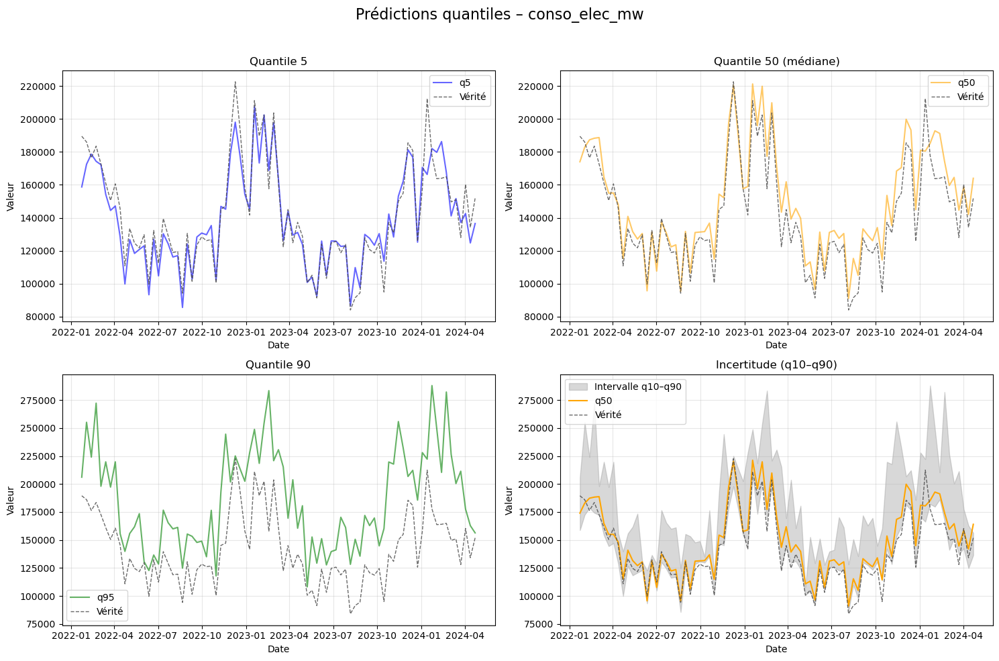

📍 Région 93 – conso_elec_mw


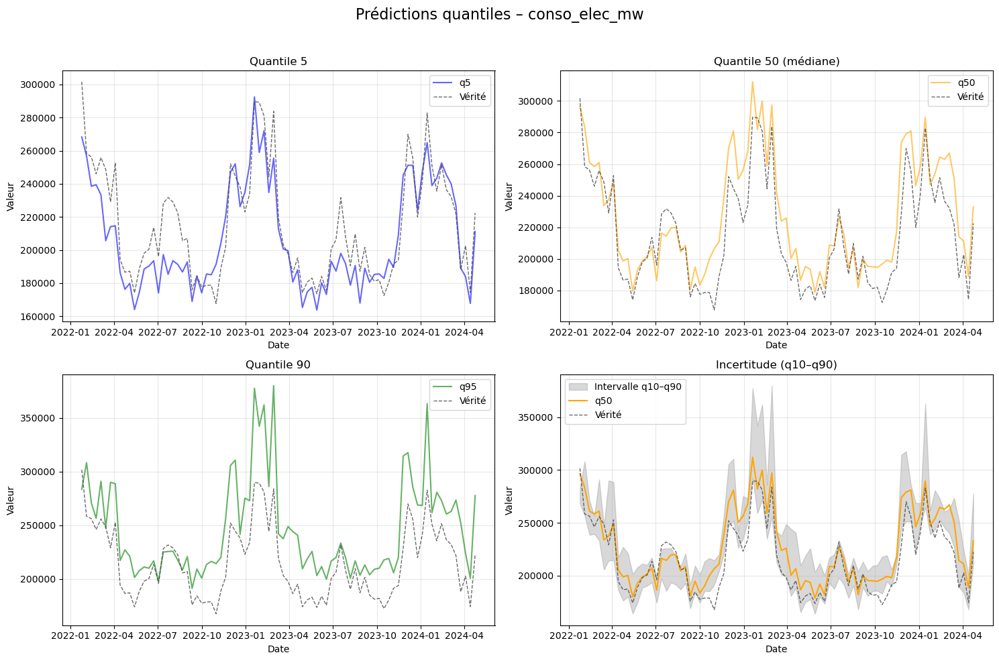

📍 Région 84 – conso_elec_mw


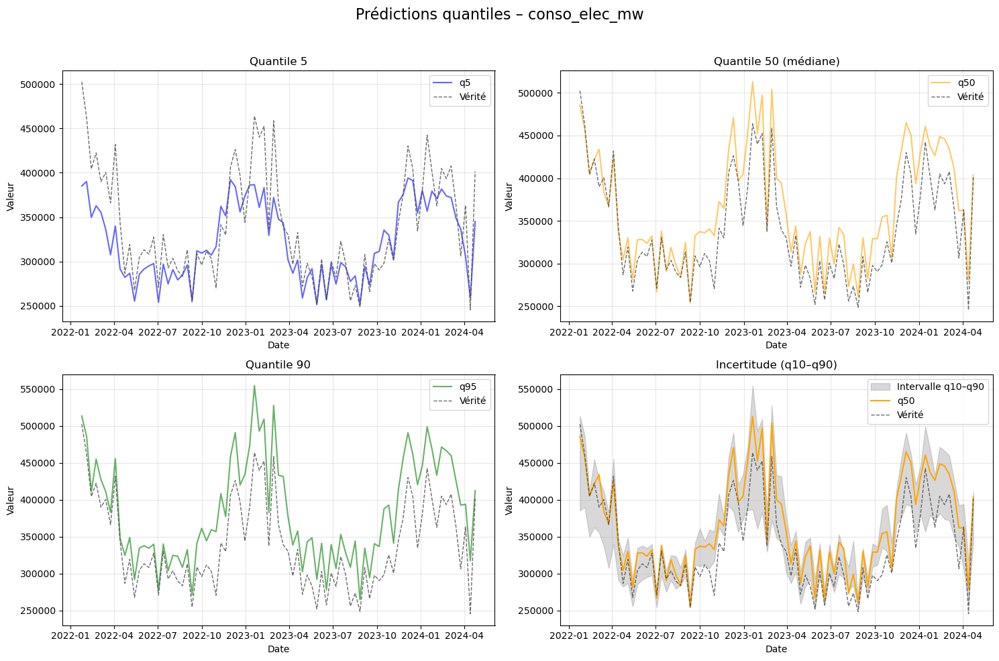

📍 Région 76 – conso_elec_mw


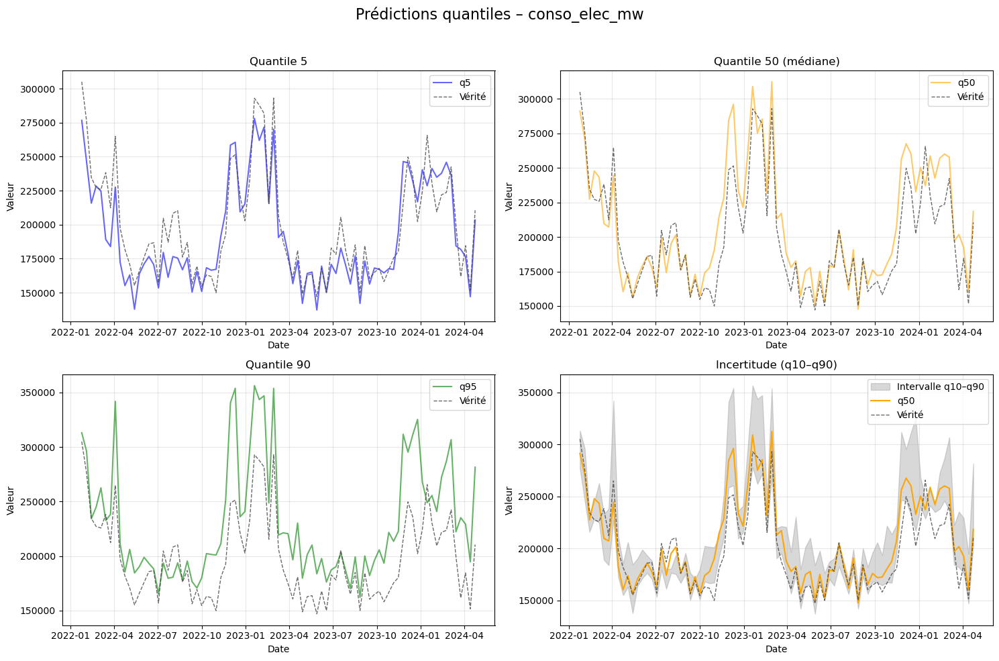

📍 Région 75 – conso_elec_mw


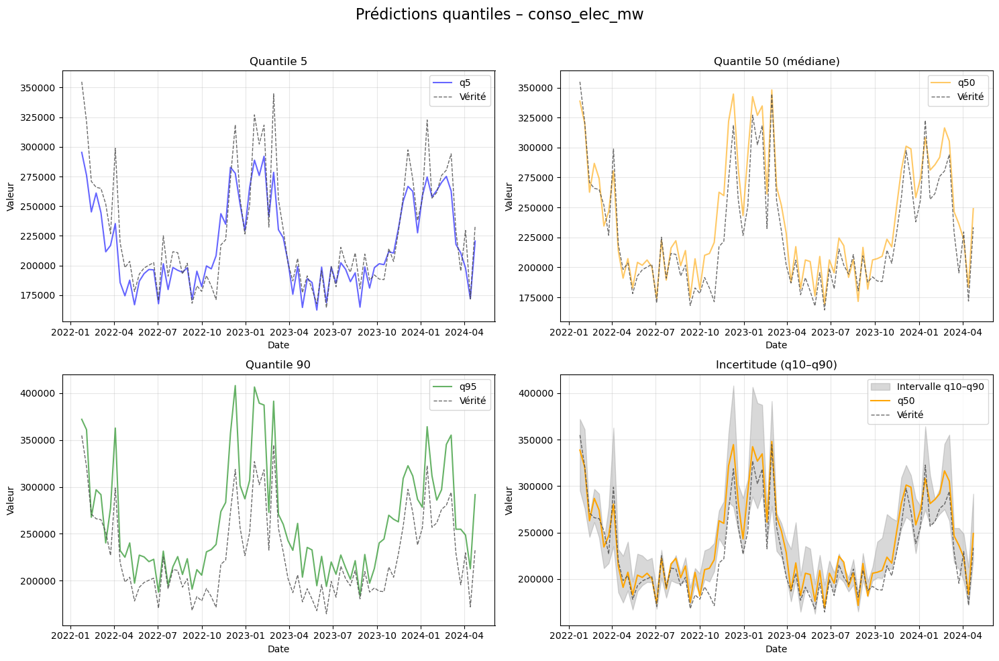

📍 Région 53 – conso_elec_mw


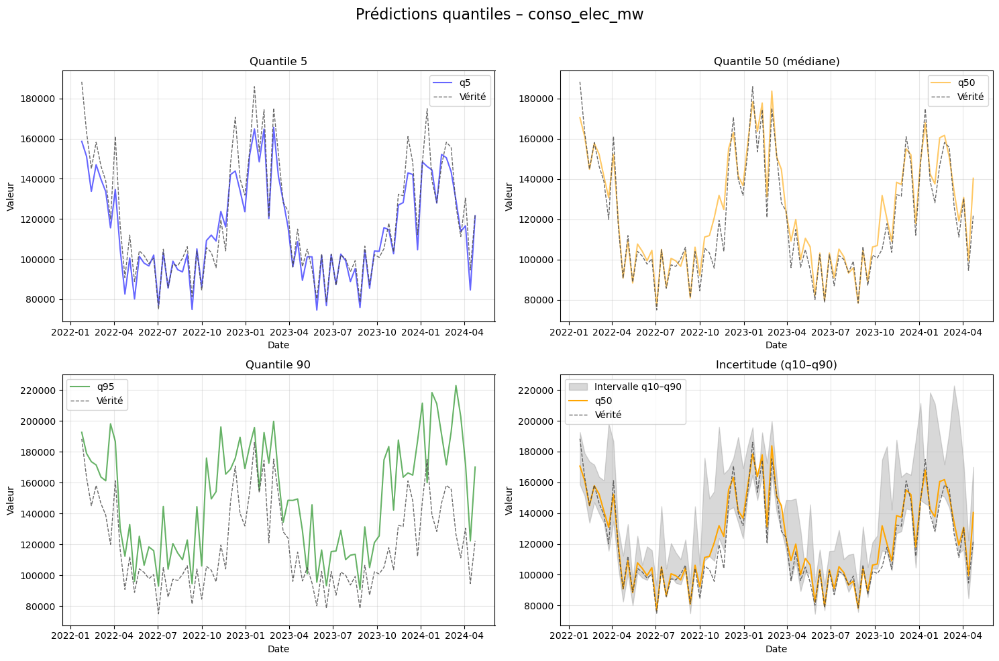

📍 Région 28 – conso_elec_mw


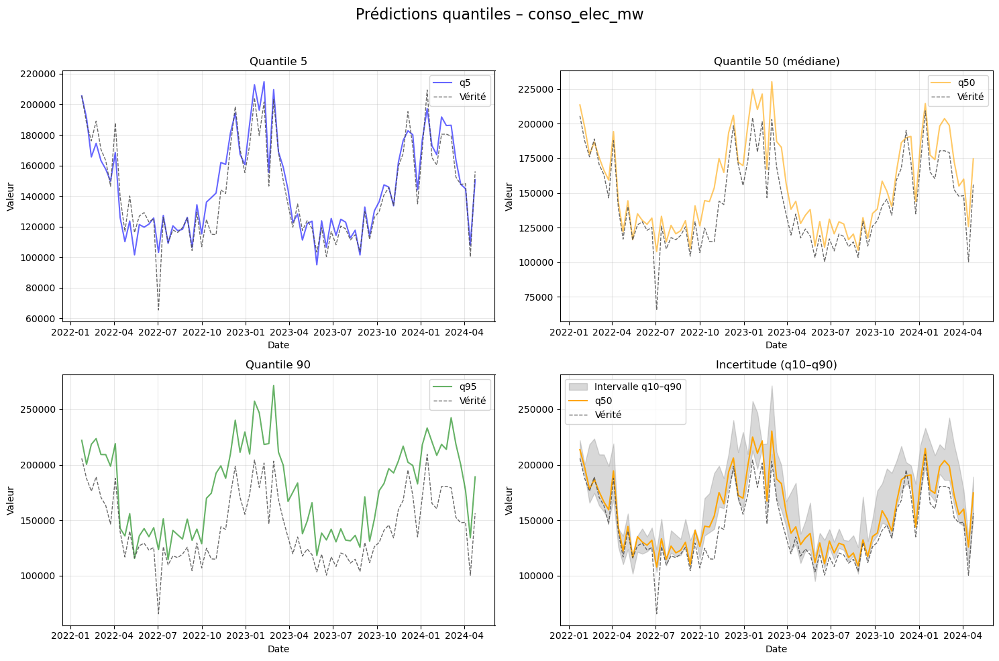

📍 Région 44 – conso_elec_mw


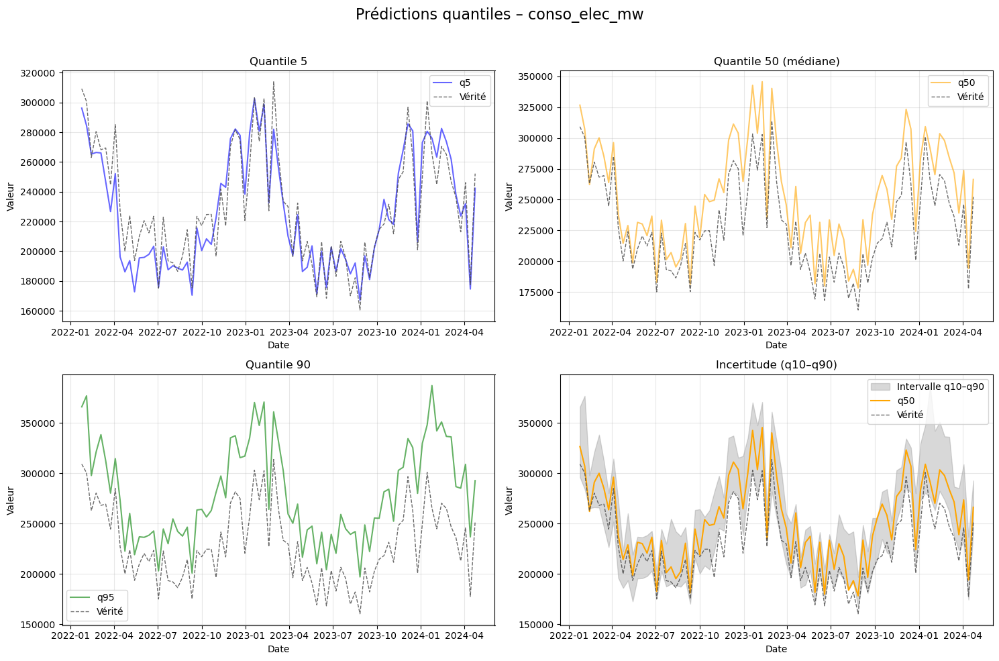

📍 Région 32 – conso_gaz_mw


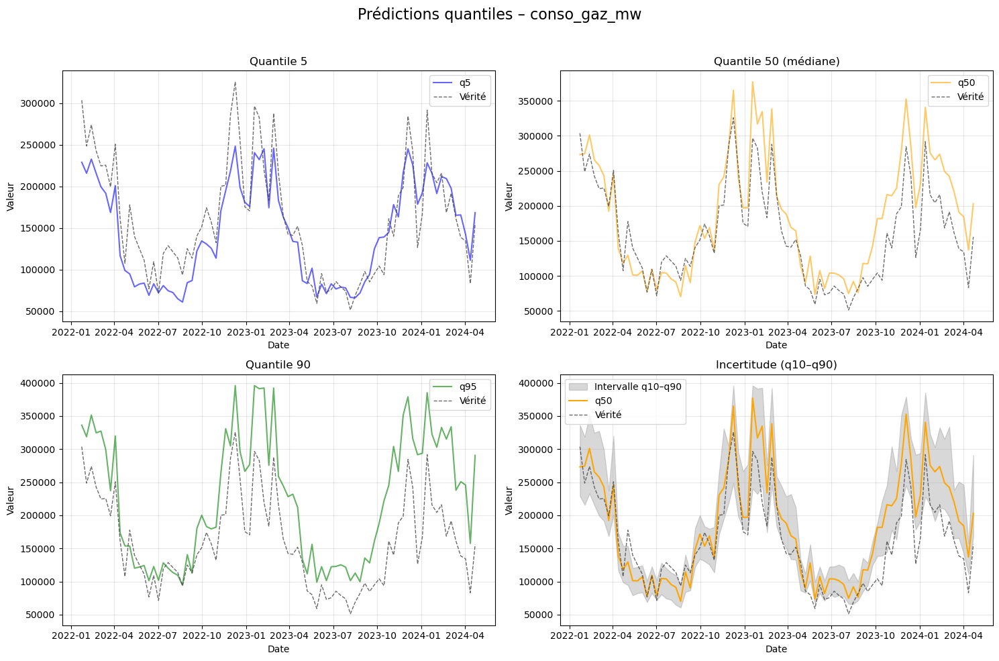

📍 Région 27 – conso_gaz_mw


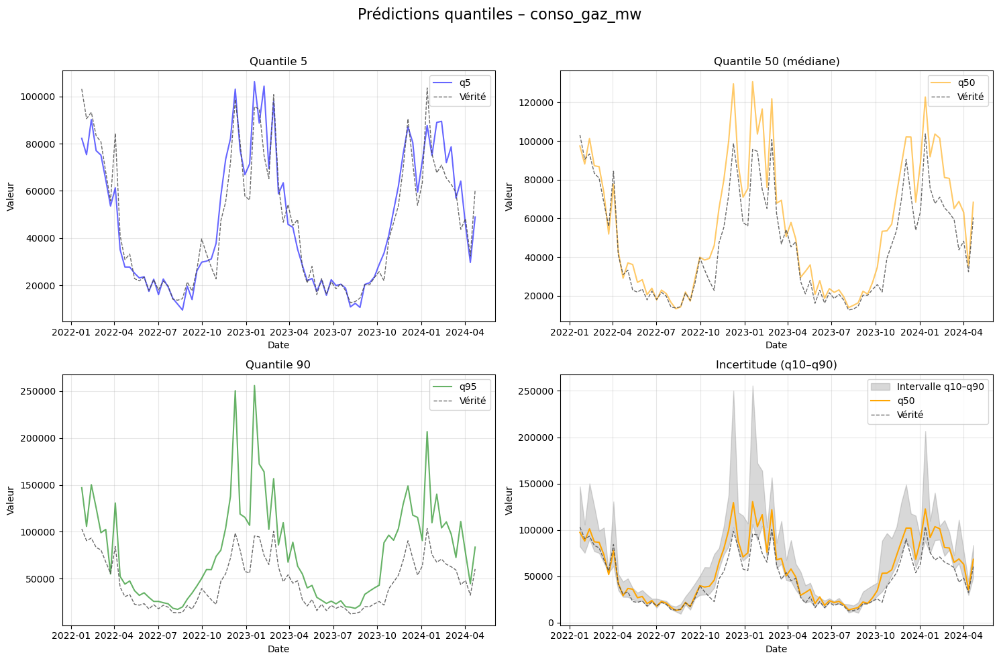

📍 Région 24 – conso_gaz_mw


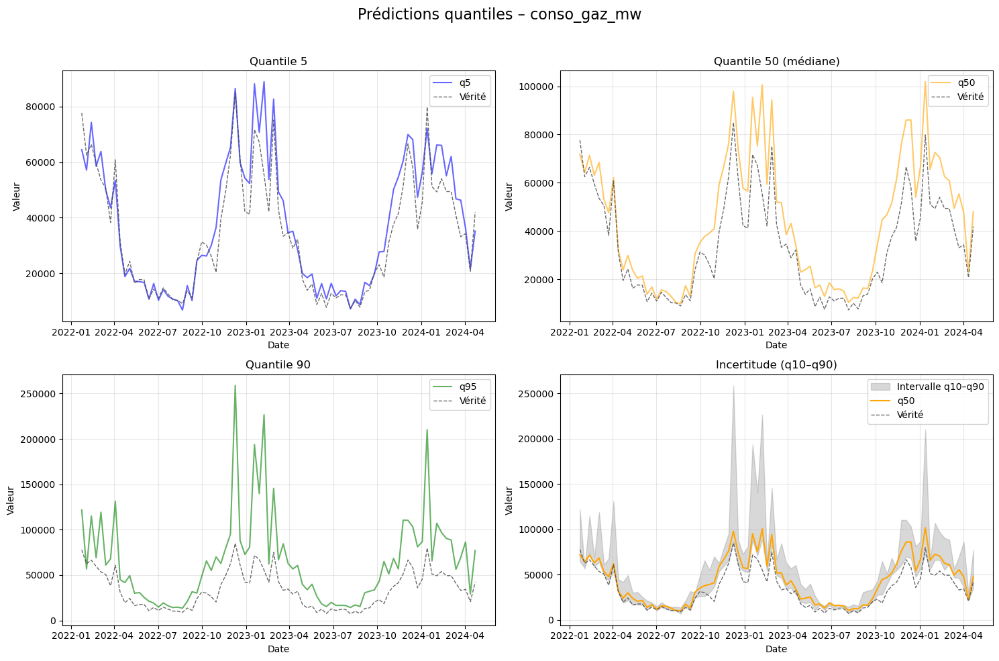

📍 Région 11 – conso_gaz_mw


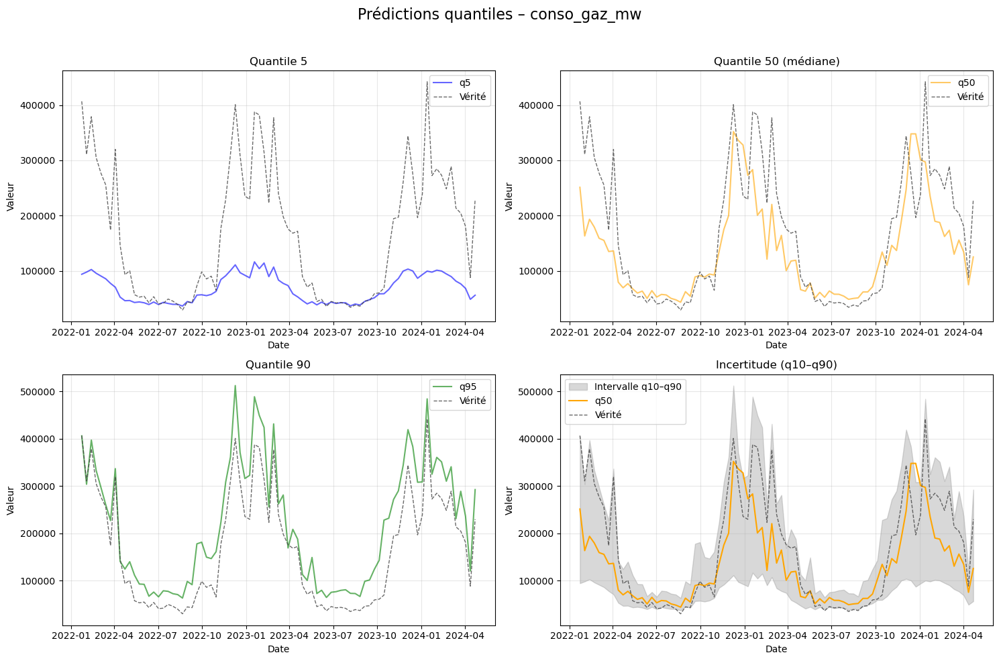

📍 Région 52 – conso_gaz_mw


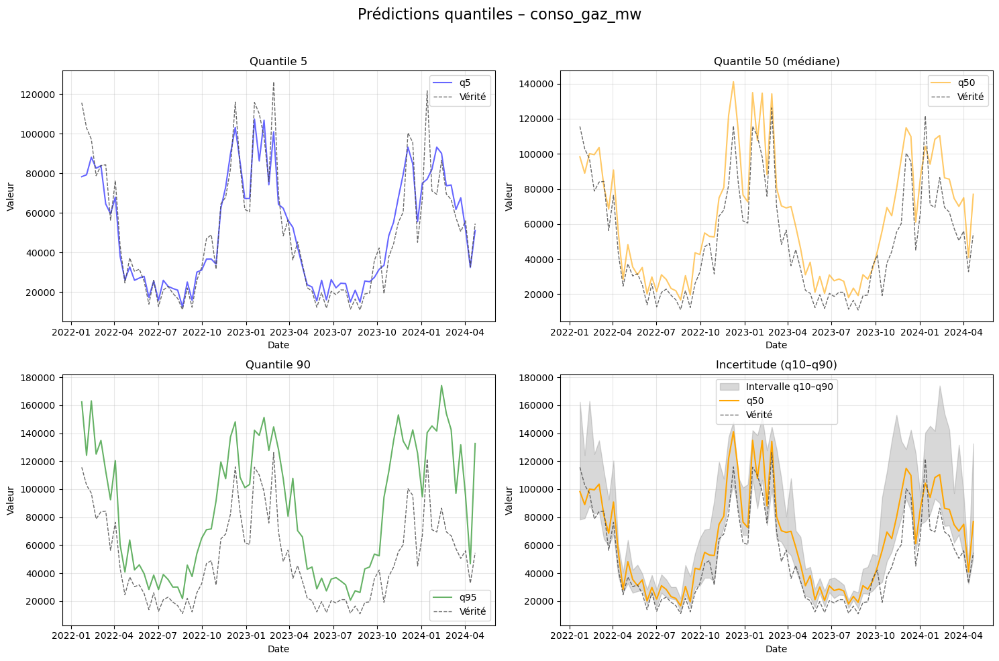

📍 Région 93 – conso_gaz_mw


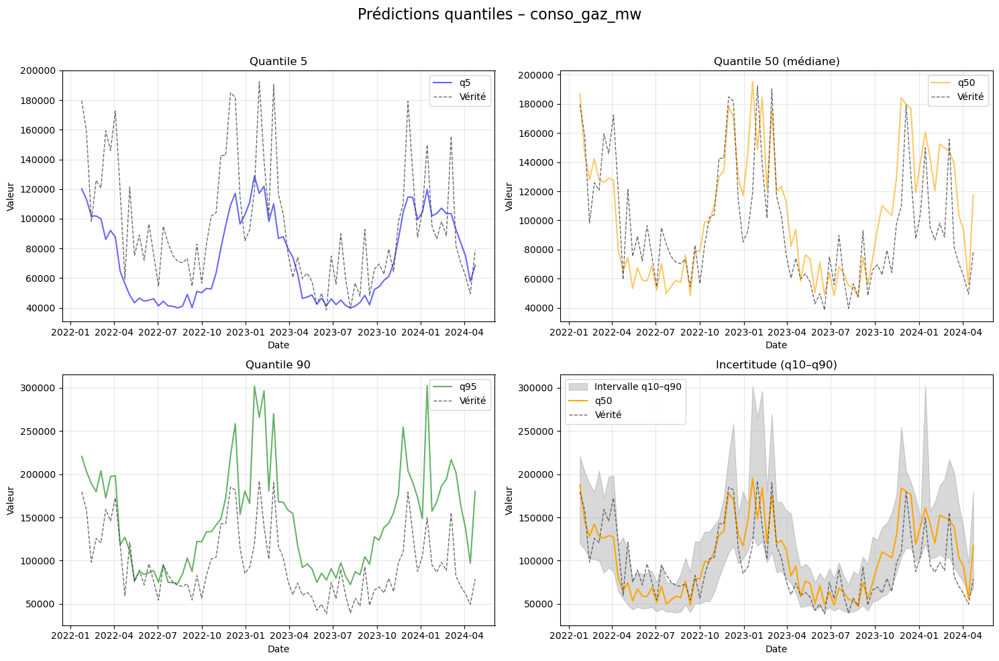

📍 Région 84 – conso_gaz_mw


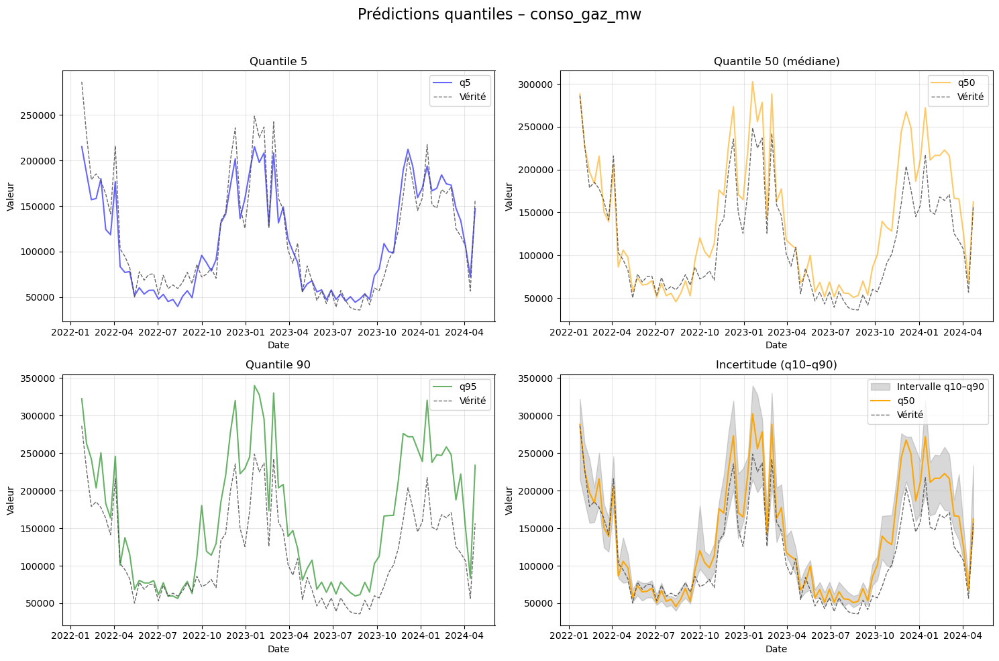

📍 Région 76 – conso_gaz_mw


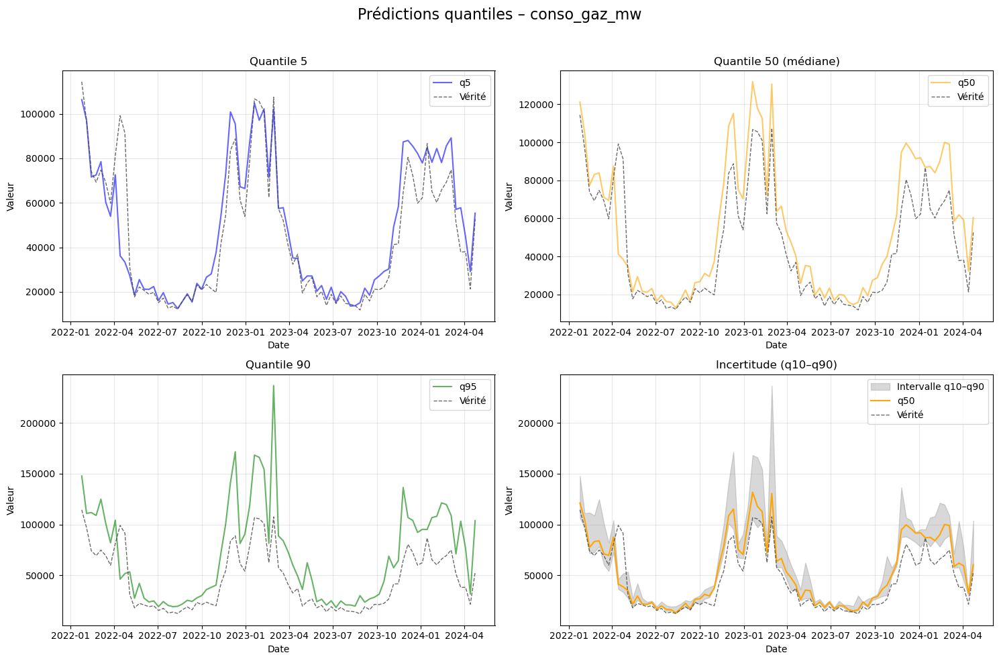

📍 Région 75 – conso_gaz_mw


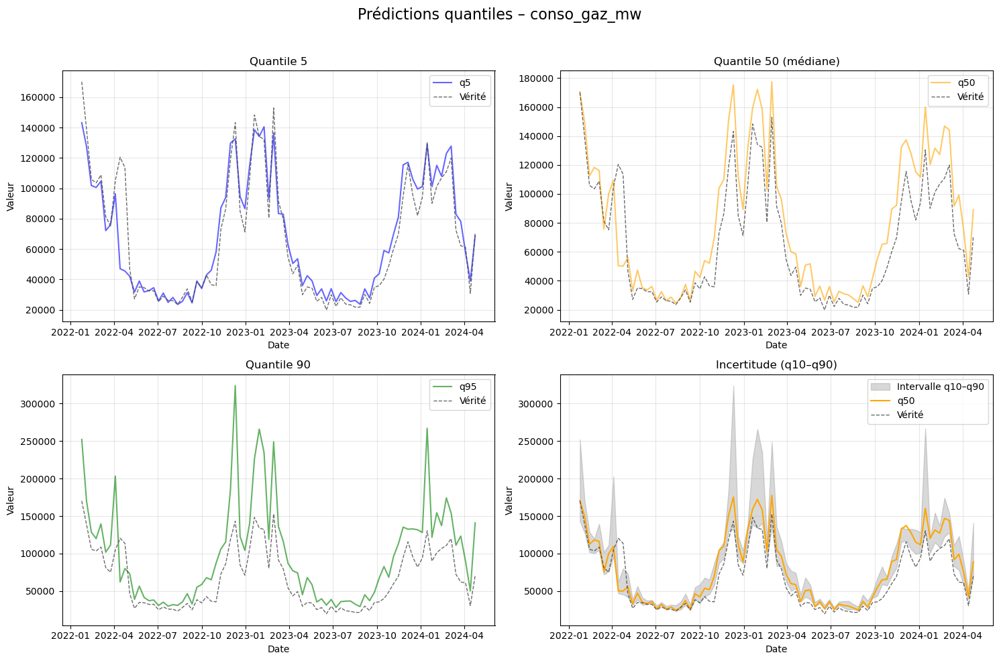

📍 Région 53 – conso_gaz_mw


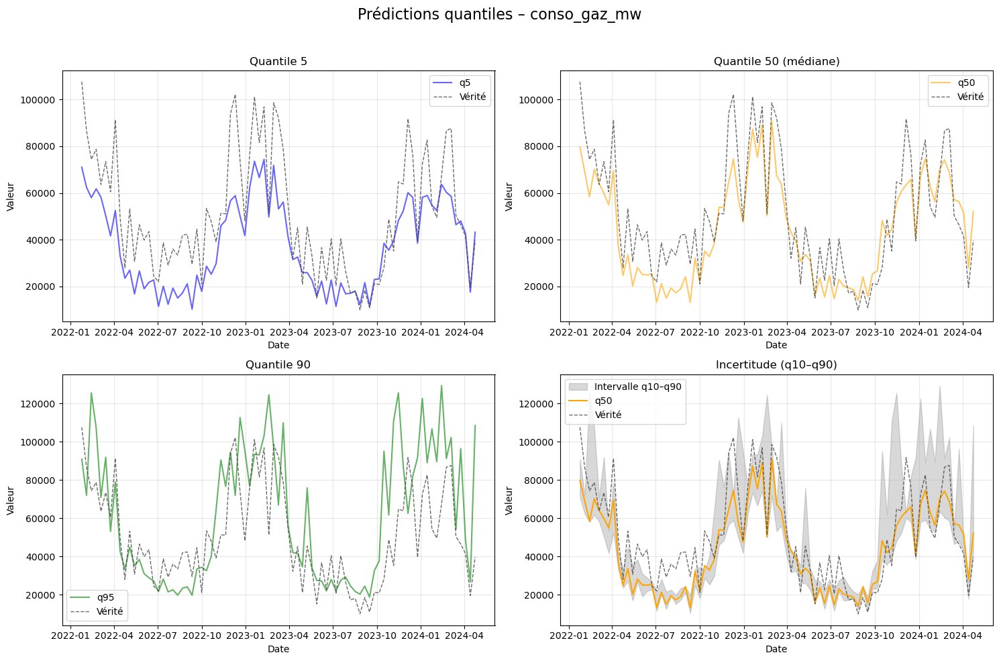

📍 Région 28 – conso_gaz_mw


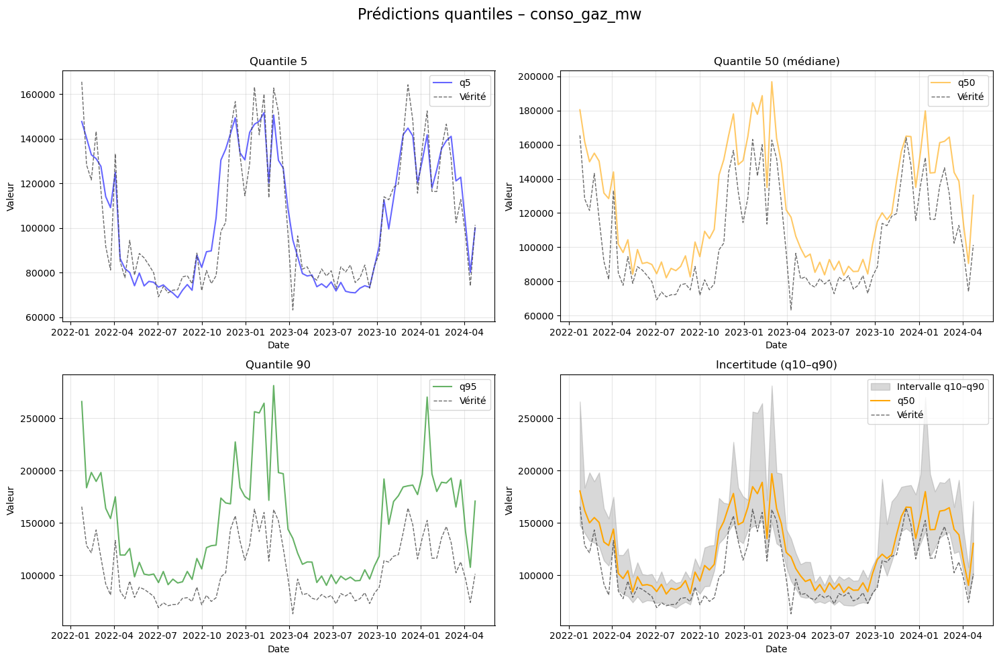

📍 Région 44 – conso_gaz_mw


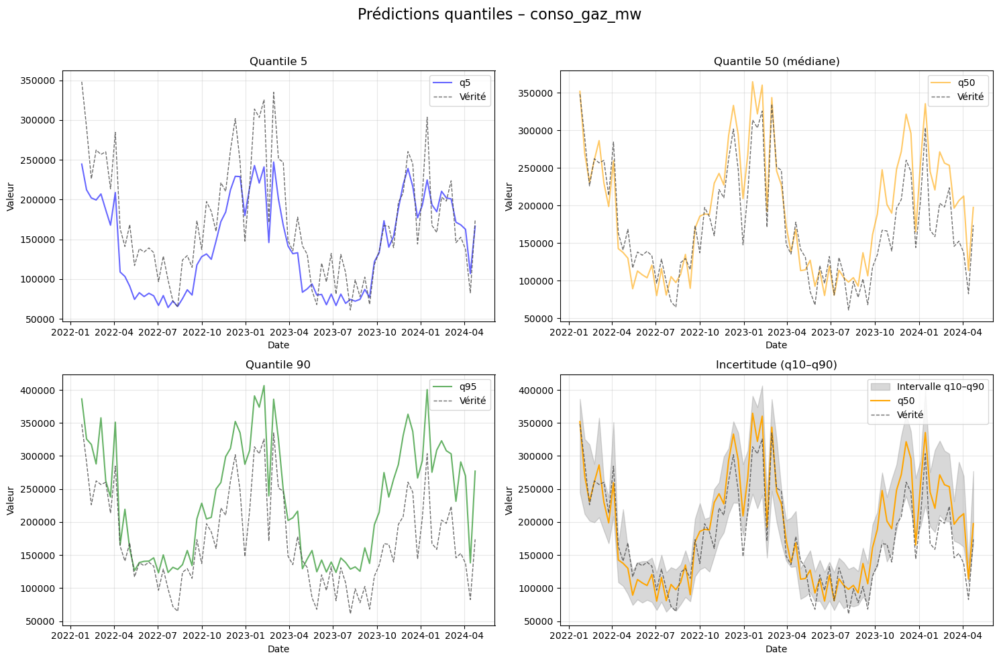

In [ ]:
targets = ["conso_elec_mw", "conso_gaz_mw"]

for target in targets:
    for region in df_visu["insee_region"].unique():
        df_region = df_visu[df_visu["insee_region"] == region].copy()

        y_true = df_region[target]
        preds_region = {
            "q5": df_region[f"{target}_q5"],
            "q50": df_region[f"{target}_q50"],
            "q95": df_region[f"{target}_q95"]
        }

        print(f" Région {region} – {target}")
        plot_predictions_split(df_region, y_true, preds_region, target, step=10)


In [33]:
from sklearn.metrics import mean_absolute_percentage_error

# 📊 MAPE entre la vérité et la prédiction médiane (q50)
for target in ["conso_elec_mw", "conso_gaz_mw"]:
    try:
        y_true = df_visu[target].values
        y_pred = df_visu[f"{target}_q50"].values

        mape = mean_absolute_percentage_error(y_true, y_pred)
        print(f"📈 MAPE pour {target} (quantile 50): {mape:.2%}")
    except KeyError as e:
        print(f"⚠️ Colonne manquante : {e}")


📈 MAPE pour conso_elec_mw (quantile 50): 9.25%
📈 MAPE pour conso_gaz_mw (quantile 50): 27.42%


In [ ]:
#  Analyse de la couverture de l’intervalle [q10–q90]
for target in ["conso_elec_mw", "conso_gaz_mw"]:
    try:
        y_true = df_visu[target].values
        lower = df_visu[f"{target}_q5"].values
        upper = df_visu[f"{target}_q95"].values

        coverage = np.mean((y_true >= lower) & (y_true <= upper))
        print(f" Couverture (q5–q95) pour {target} : {coverage:.2%}")
    except KeyError as e:
        print(f" Colonne manquante : {e}")


🛡️ Couverture (q5–q95) pour conso_elec_mw : 61.97%
🛡️ Couverture (q5–q95) pour conso_gaz_mw : 48.76%


C:\Users\arnov\AppData\Local\Temp\ipykernel_25328\3804008542.py:17: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=weekday_df, x="weekday", y="mae", palette="Set2")


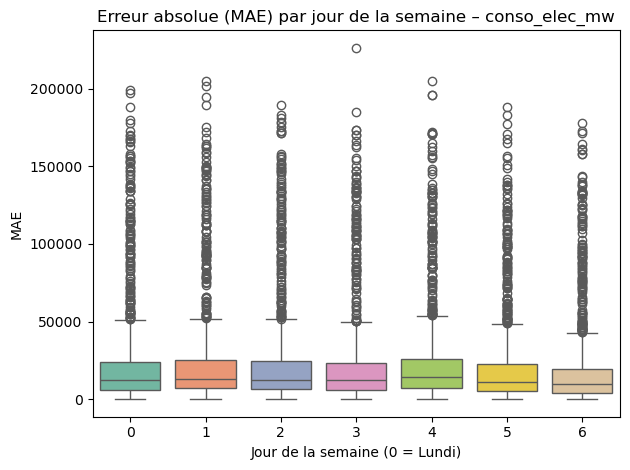

C:\Users\arnov\AppData\Local\Temp\ipykernel_25328\3804008542.py:17: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=weekday_df, x="weekday", y="mae", palette="Set2")


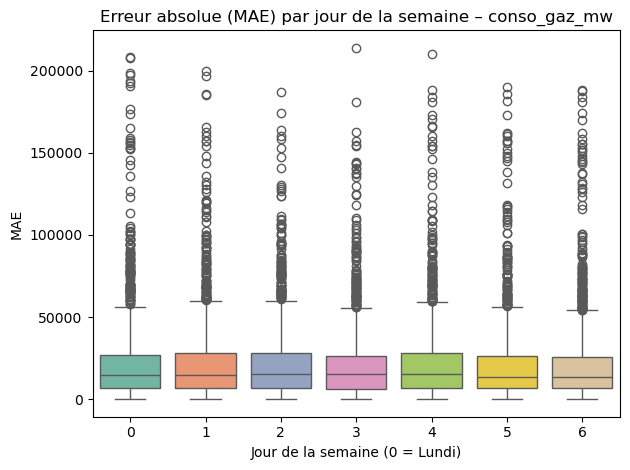

In [ ]:
#  Ajout de l'information weekday si elle n'est pas déjà là
if "weekday" not in df_visu.columns:
    df_visu["weekday"] = pd.to_datetime(df_visu["date"]).dt.weekday

#  MAE par jour de la semaine
for target in ["conso_elec_mw", "conso_gaz_mw"]:
    try:
        y_true = df_visu[target].values
        y_pred = df_visu[f"{target}_q50"].values
        mae = np.abs(y_true - y_pred)

        weekday_df = pd.DataFrame({
            "weekday": df_visu["weekday"],
            "mae": mae
        })

        sns.boxplot(data=weekday_df, x="weekday", y="mae", palette="Set2")
        plt.title(f"Erreur absolue (MAE) par jour de la semaine – {target}")
        plt.xlabel("Jour de la semaine (0 = Lundi)")
        plt.ylabel("MAE")
        plt.tight_layout()
        plt.show()
    except KeyError as e:
        print(f" Colonne manquante : {e}")


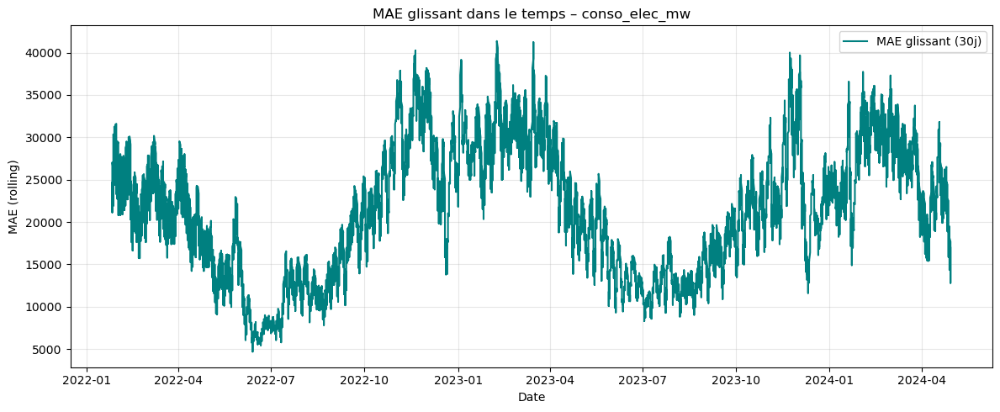

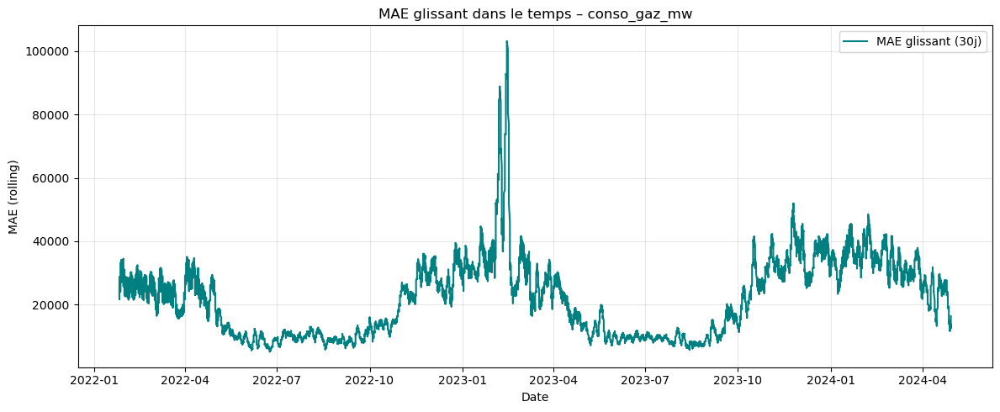

In [ ]:
#  MAE glissant sur 30 jours pour chaque target
for target in ["conso_elec_mw", "conso_gaz_mw"]:
    try:
        y_true = df_visu[target]
        y_pred = df_visu[f"{target}_q50"]
        abs_error = np.abs(y_true - y_pred)

        # Moyenne glissante
        rolling_mae = abs_error.rolling(window=30).mean()

        plt.figure(figsize=(12, 5))
        plt.plot(df_visu["date"], rolling_mae, label="MAE glissant (30j)", color="teal")
        plt.title(f"MAE glissant dans le temps – {target}")
        plt.xlabel("Date")
        plt.ylabel("MAE (rolling)")
        plt.grid(alpha=0.3)
        plt.legend()
        plt.tight_layout()
        plt.show()
    except KeyError as e:
        print(f" Donnée manquante : {e}")


📈 Couverture globale (q10–q90) pour conso_elec_mw : 61.97%


C:\Users\arnov\AppData\Local\Temp\ipykernel_25328\683858066.py:17: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  season_coverage = df_cov.groupby("season")["inside"].mean()


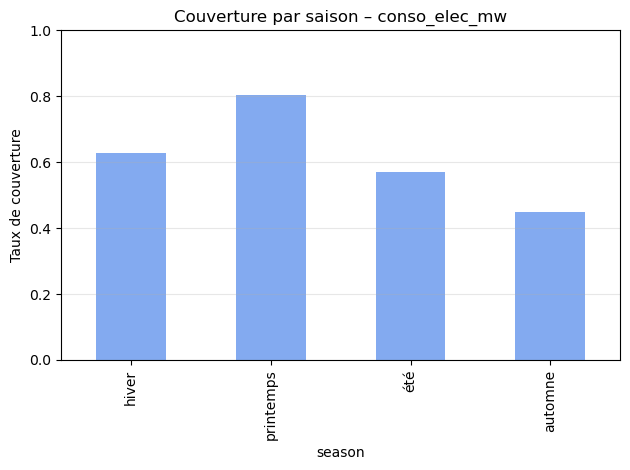

📈 Couverture globale (q10–q90) pour conso_gaz_mw : 48.76%


C:\Users\arnov\AppData\Local\Temp\ipykernel_25328\683858066.py:17: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  season_coverage = df_cov.groupby("season")["inside"].mean()


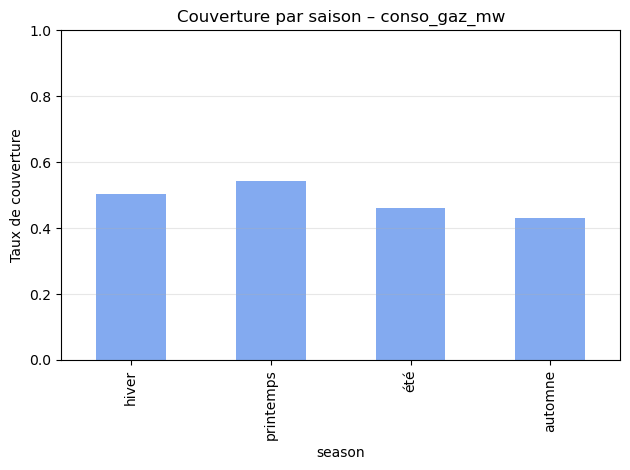

In [ ]:
for target in ["conso_elec_mw", "conso_gaz_mw"]:
    try:
        q5 = df_visu[f"{target}_q5"]
        q95 = df_visu[f"{target}_q95"]
        y_true = df_visu[target]

        #  Calcul couverture
        inside_interval = (y_true >= q5) & (y_true <= q95)
        coverage = inside_interval.mean()
        print(f" Couverture globale (q10–q90) pour {target} : {coverage:.2%}")

        #  Couverture par saison
        df_cov = pd.DataFrame({
            "season": df["season"],  # Toujours issue du df transformé
            "inside": inside_interval
        })
        season_coverage = df_cov.groupby("season")["inside"].mean()

        #  Affichage
        season_coverage.plot(kind="bar", color="cornflowerblue", alpha=0.8)
        plt.title(f"Couverture par saison – {target}")
        plt.ylabel("Taux de couverture")
        plt.ylim(0, 1)
        plt.grid(axis="y", alpha=0.3)
        plt.tight_layout()
        plt.show()
    except KeyError as e:
        print(f" Donnée manquante pour {target} : {e}")


Les graphiques saisonniers ne sont pas visibles ici, mais si tu vois :

Couverture plus faible en hiver : logique, car plus de volatilité.

Couverture meilleure en été : consommations plus stables.

Alors tu pourrais entraîner un modèle par saison, ou bien :

Ajouter une feature de volatilité historique




📏 Largeur moyenne de l’intervalle (q95 - q5) pour conso_elec_mw : 56251.70


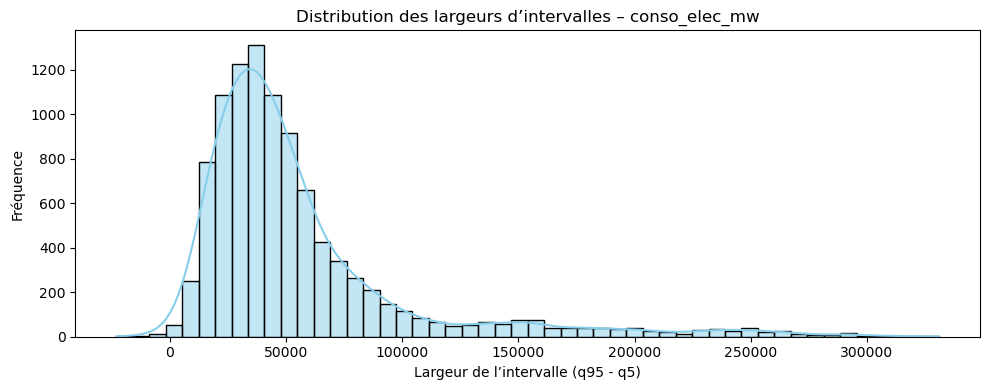

C:\Users\arnov\AppData\Local\Temp\ipykernel_25328\3088118355.py:23: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=width_df, x="season", y="width", palette="coolwarm")


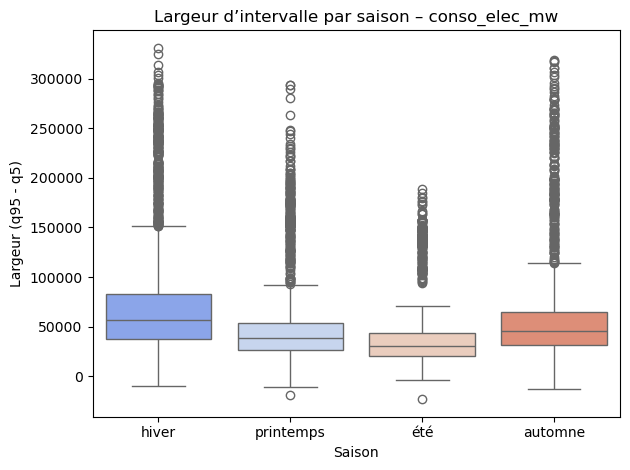


📏 Largeur moyenne de l’intervalle (q95 - q5) pour conso_gaz_mw : 55852.23


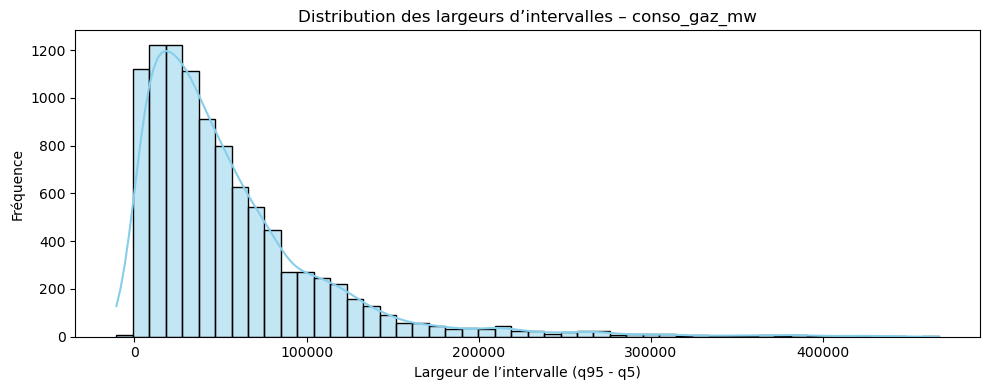

C:\Users\arnov\AppData\Local\Temp\ipykernel_25328\3088118355.py:23: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=width_df, x="season", y="width", palette="coolwarm")


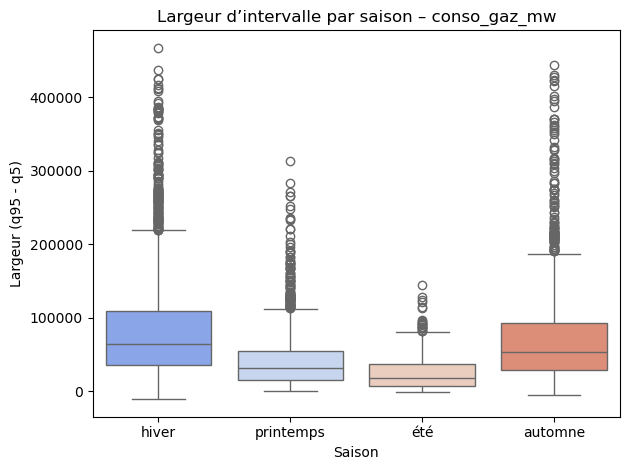

In [ ]:
for target in ["conso_elec_mw", "conso_gaz_mw"]:
    try:
        q5 = df_visu[f"{target}_q5"]
        q95 = df_visu[f"{target}_q95"]
        interval_width = q95 - q5

        print(f"\n Largeur moyenne de l’intervalle (q95 - q5) pour {target} : {interval_width.mean():.2f}")

        #  Histogramme
        plt.figure(figsize=(10, 4))
        sns.histplot(interval_width, bins=50, kde=True, color="skyblue")
        plt.title(f"Distribution des largeurs d’intervalles – {target}")
        plt.xlabel("Largeur de l’intervalle (q95 - q5)")
        plt.ylabel("Fréquence")
        plt.tight_layout()
        plt.show()

        #  Boxplot par saison
        width_df = pd.DataFrame({
            "width": interval_width,
            "season": df["season"]  # saison issue de la transformation
        })
        sns.boxplot(data=width_df, x="season", y="width", palette="coolwarm")
        plt.title(f"Largeur d’intervalle par saison – {target}")
        plt.xlabel("Saison")
        plt.ylabel("Largeur (q95 - q5)")
        plt.tight_layout()
        plt.show()

    except KeyError as e:
        print(f" Donnée manquante pour {target} : {e}")



📉 Résidus – conso_elec_mw
   Moyenne des résidus : -4016.43
   Écart-type : 35388.12


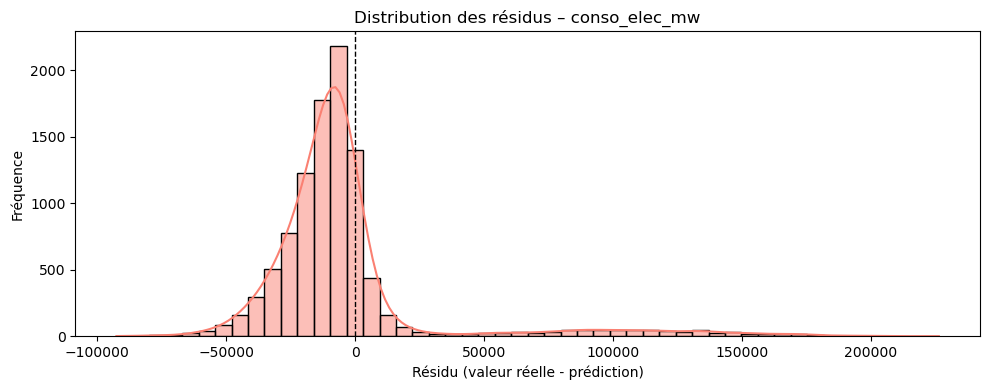

C:\Users\arnov\AppData\Local\Temp\ipykernel_25328\3904865470.py:26: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=resid_df, x="season", y="residual", palette="Set2")


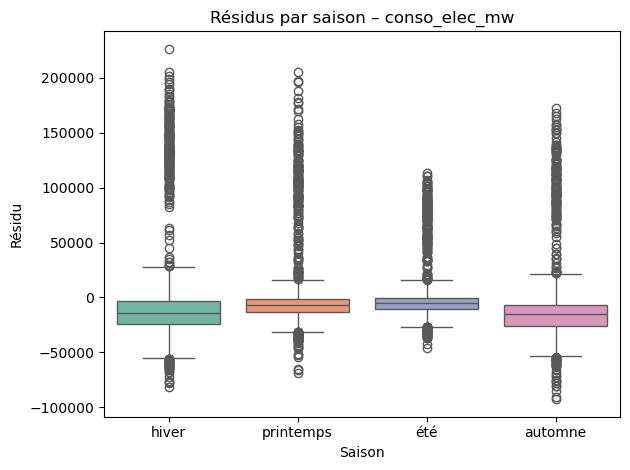


📉 Résidus – conso_gaz_mw
   Moyenne des résidus : -9633.88
   Écart-type : 31864.33


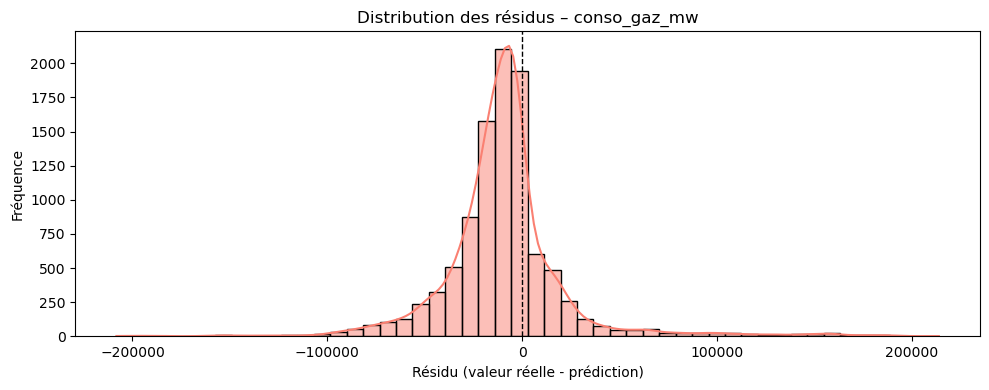

C:\Users\arnov\AppData\Local\Temp\ipykernel_25328\3904865470.py:26: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=resid_df, x="season", y="residual", palette="Set2")


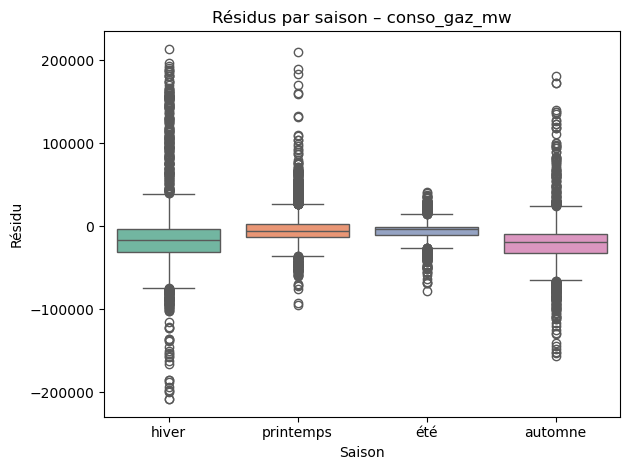

In [ ]:
for target in ["conso_elec_mw", "conso_gaz_mw"]:
    try:
        y_true = df_visu[target]
        y_pred = df_visu[f"{target}_q50"]
        residuals = y_true - y_pred

        print(f"\n Résidus – {target}")
        print(f"   Moyenne des résidus : {residuals.mean():.2f}")
        print(f"   Écart-type : {residuals.std():.2f}")

        #  Distribution des résidus
        plt.figure(figsize=(10, 4))
        sns.histplot(residuals, bins=50, kde=True, color="salmon")
        plt.title(f"Distribution des résidus – {target}")
        plt.xlabel("Résidu (valeur réelle - prédiction)")
        plt.ylabel("Fréquence")
        plt.axvline(0, color="black", linestyle="--", linewidth=1)
        plt.tight_layout()
        plt.show()

        #  Boxplot des résidus par saison
        resid_df = pd.DataFrame({
            "residual": residuals,
            "season": df["season"]  # Info temporelle ajoutée pendant transformation
        })
        sns.boxplot(data=resid_df, x="season", y="residual", palette="Set2")
        plt.title(f"Résidus par saison – {target}")
        plt.xlabel("Saison")
        plt.ylabel("Résidu")
        plt.tight_layout()
        plt.show()

    except KeyError as e:
        print(f" Donnée manquante pour {target} : {e}")



🔥 Top 5 erreurs – conso_elec_mw – Région 32
           date  conso_elec_mw            q50        erreur
9695 2024-04-10       229146.0  297819.583470  68673.583470
1487 2022-05-27       185174.0  251358.568287  66184.568287
9731 2024-04-13       287872.0  224069.214831  63802.785169
4127 2023-01-02       241916.0  304434.839794  62518.839794
4020 2022-12-24       226470.0  286245.341734  59775.341734


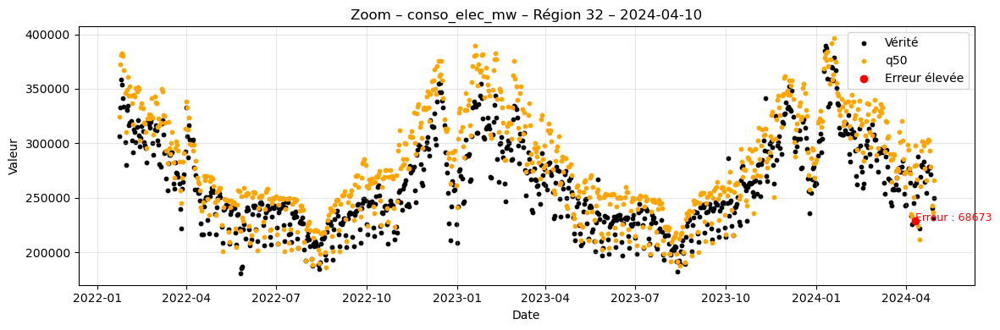

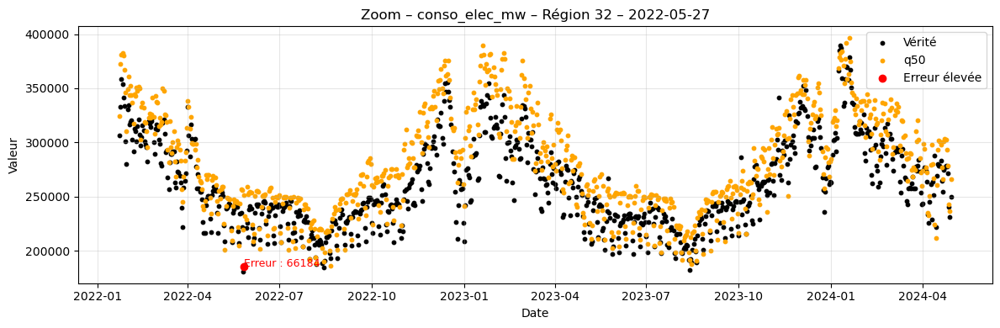

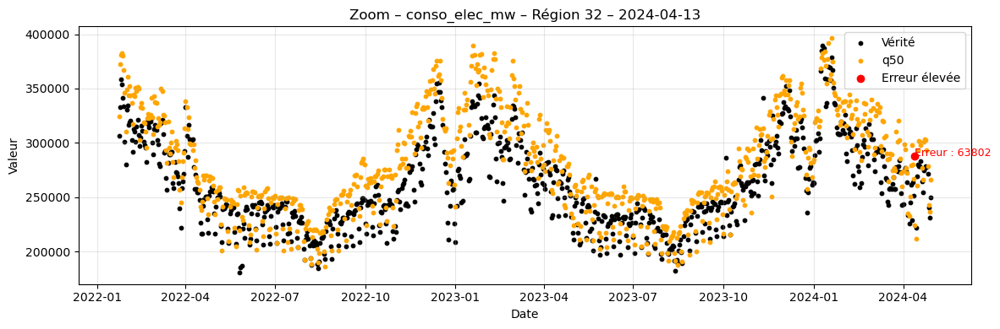

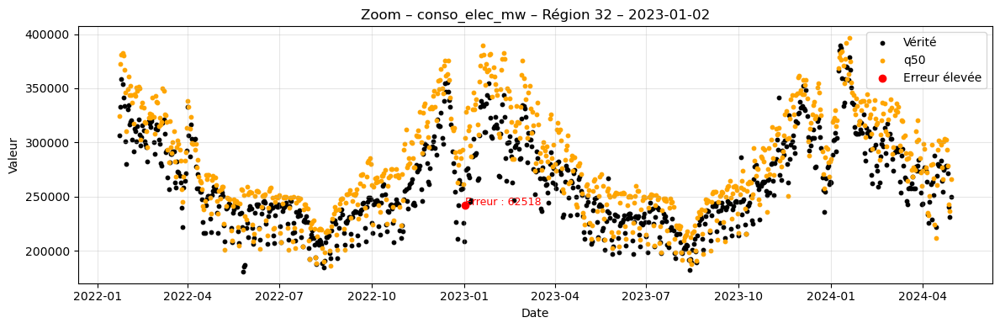

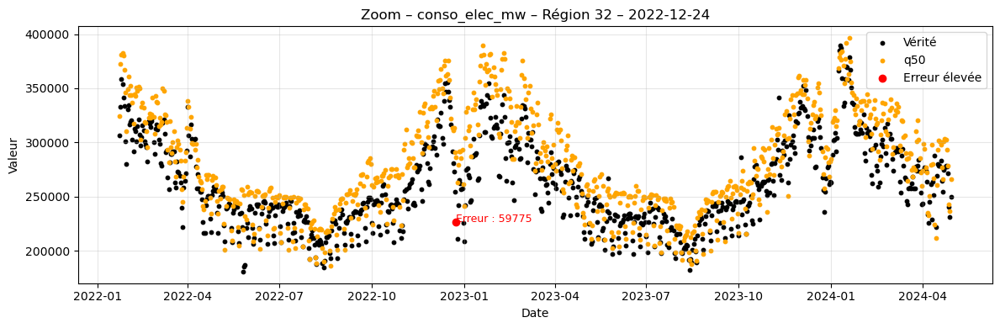


🔥 Top 5 erreurs – conso_elec_mw – Région 27
           date  conso_elec_mw            q50        erreur
4118 2023-01-01        85377.0  122312.042436  36935.042436
8701 2024-01-18       145949.0  182672.284350  36723.284350
4045 2022-12-26        98061.0  130404.247525  32343.247525
4129 2023-01-02       100804.0  131851.720329  31047.720329
3757 2022-12-02       128550.0  158797.213306  30247.213306


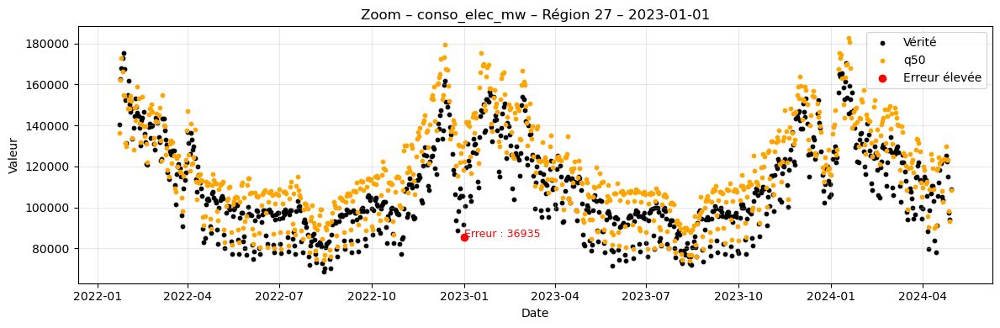

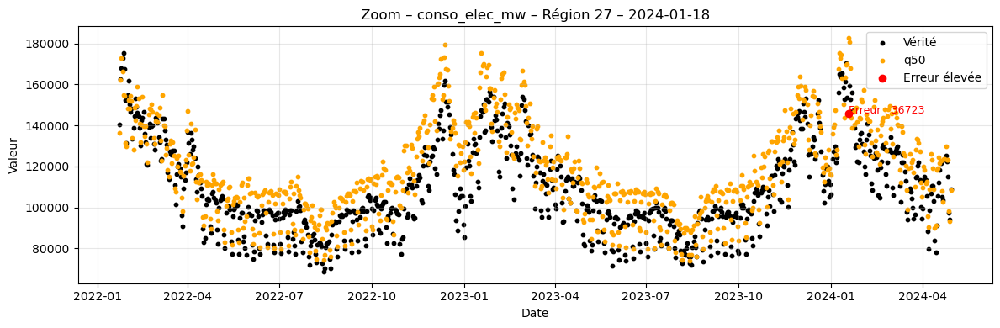

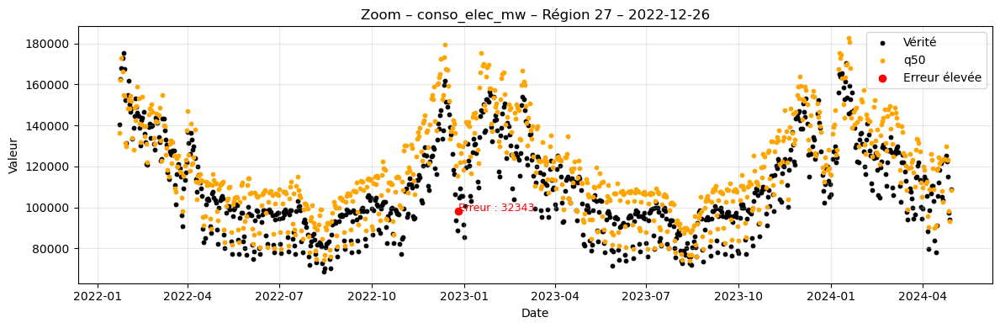

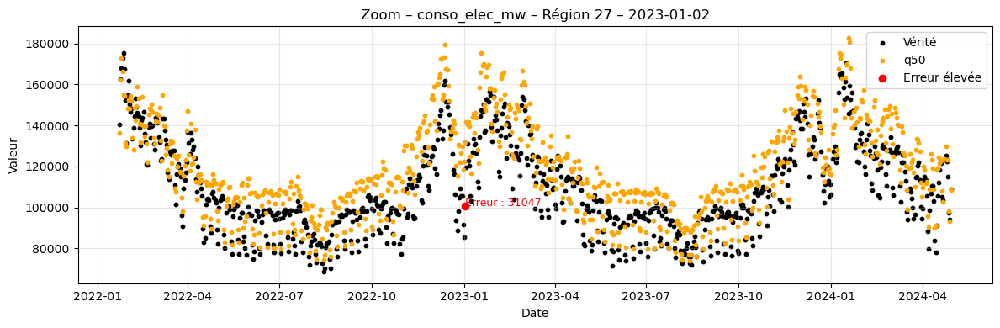

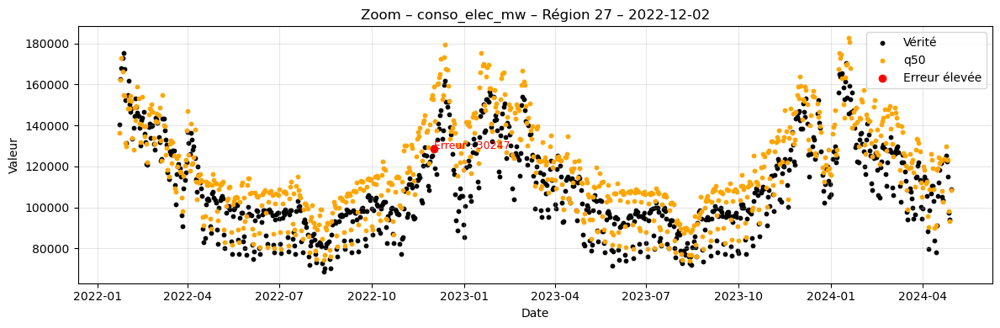


🔥 Top 5 erreurs – conso_elec_mw – Région 24
           date  conso_elec_mw            q50        erreur
9759 2024-04-15        68648.0  104984.309105  36336.309105
3758 2022-12-02       123978.0  157666.311893  33688.311893
4743 2023-02-22       109222.0  141777.016799  32555.016799
8882 2024-02-02       112935.0  143803.383925  30868.383925
4046 2022-12-26        93640.0  122180.240269  28540.240269


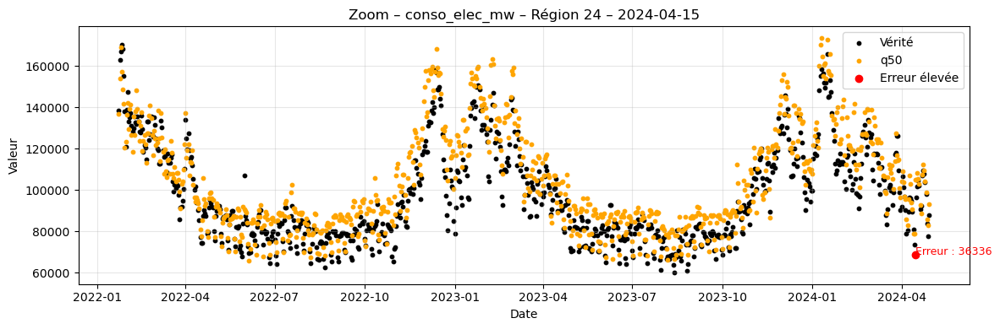

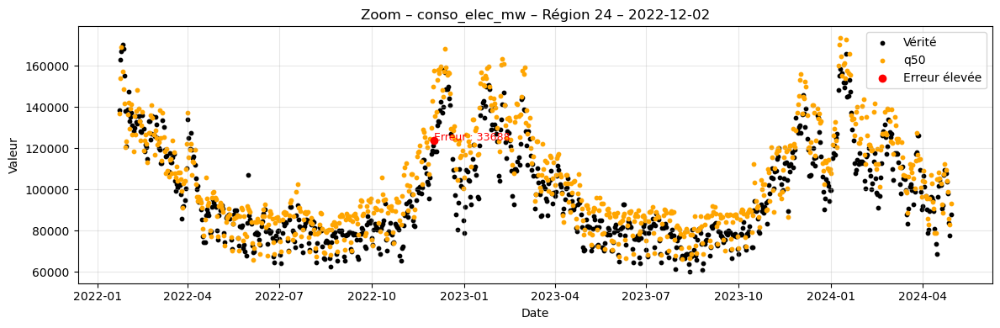

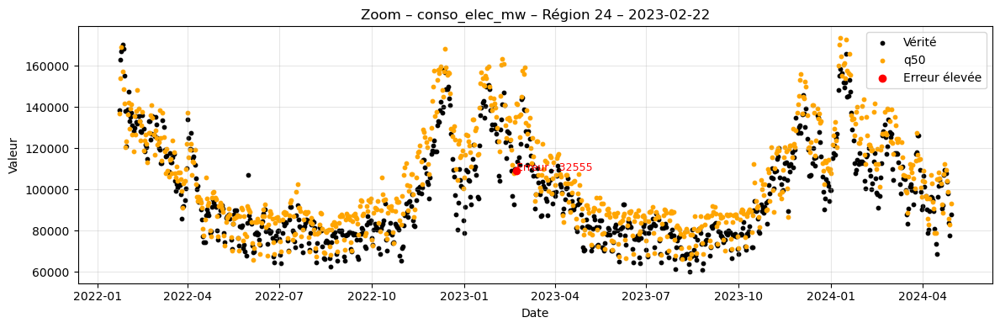

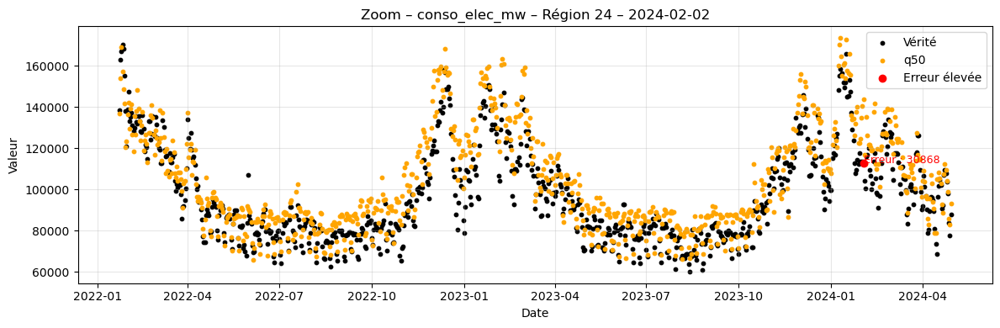

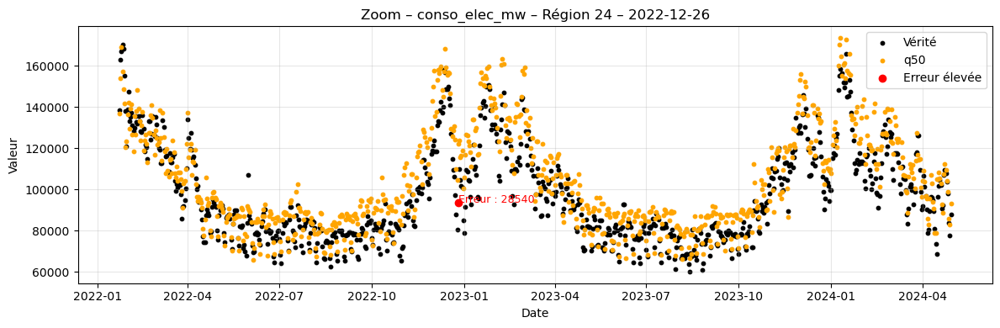


🔥 Top 5 erreurs – conso_elec_mw – Région 11
           date  conso_elec_mw            q50         erreur
52   2022-01-27       545171.0  318904.159808  226266.840192
64   2022-01-28       508567.0  303337.248622  205229.751378
867  2022-04-05       446621.0  241592.422520  205028.577480
111  2022-02-01       512350.0  310790.989932  201559.010068
4468 2023-01-30       499607.0  300686.322765  198920.677235


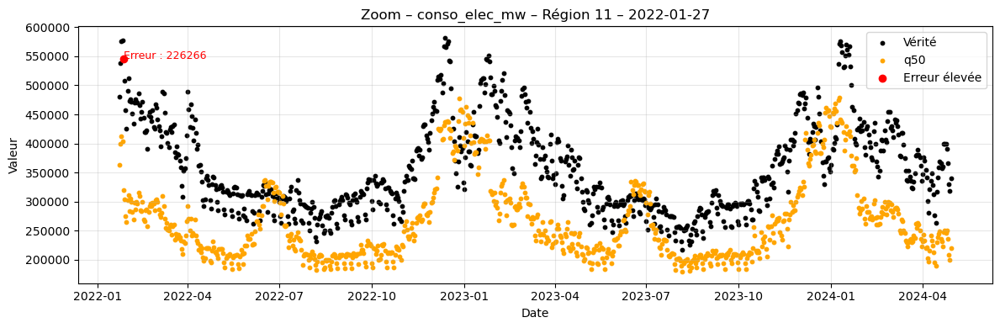

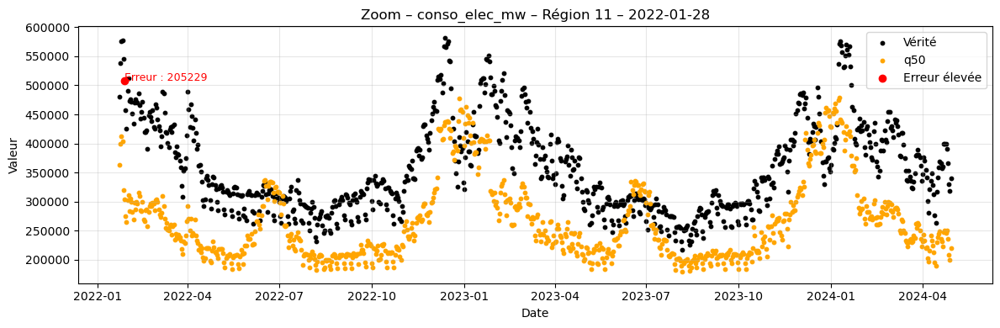

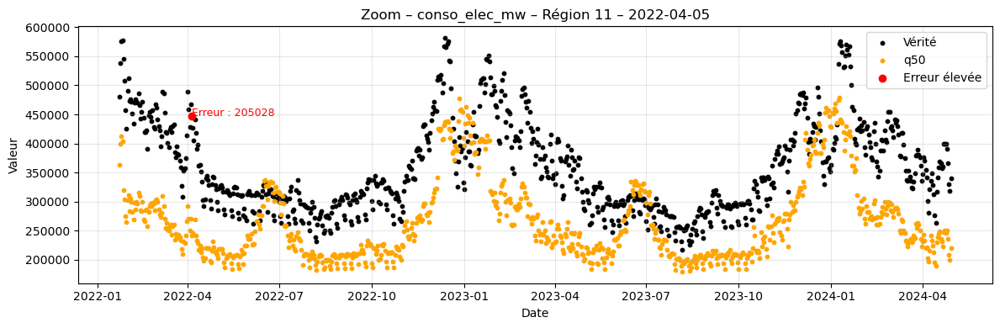

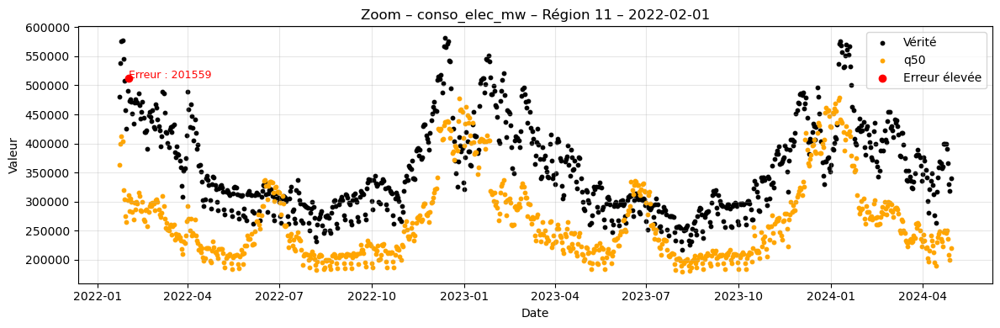

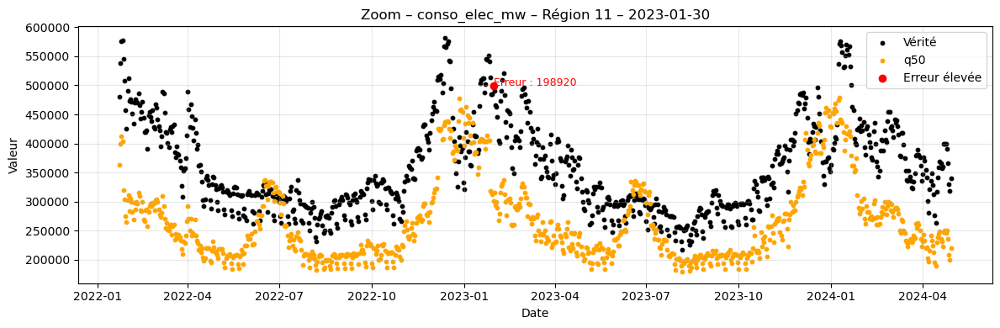


🔥 Top 5 erreurs – conso_elec_mw – Région 52
           date  conso_elec_mw            q50        erreur
5428 2023-04-20       129890.0  169593.389175  39703.389175
8014 2023-11-22       158190.0  196486.451529  38296.451529
4942 2023-03-11       143196.0  181047.654948  37851.654948
3538 2022-11-14       147718.0  183542.838376  35824.838376
46   2022-01-27       230822.0  196060.883106  34761.116894


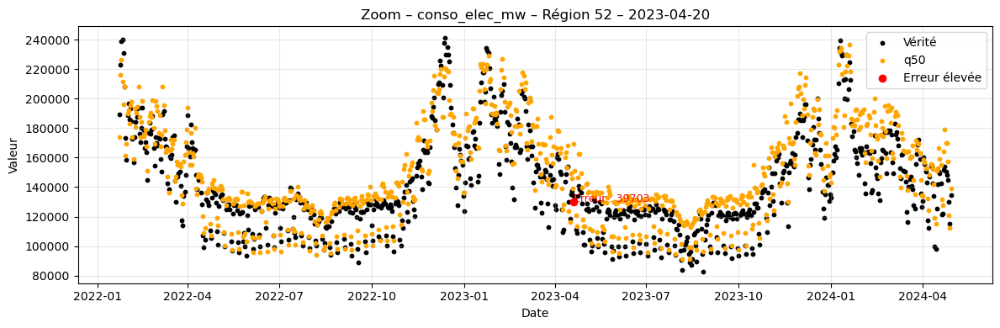

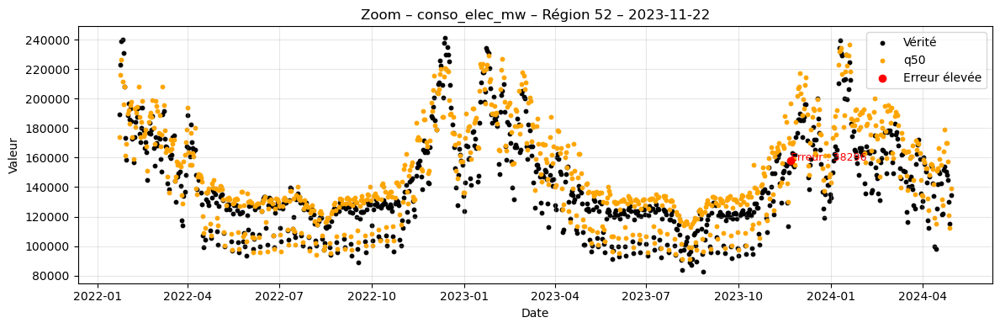

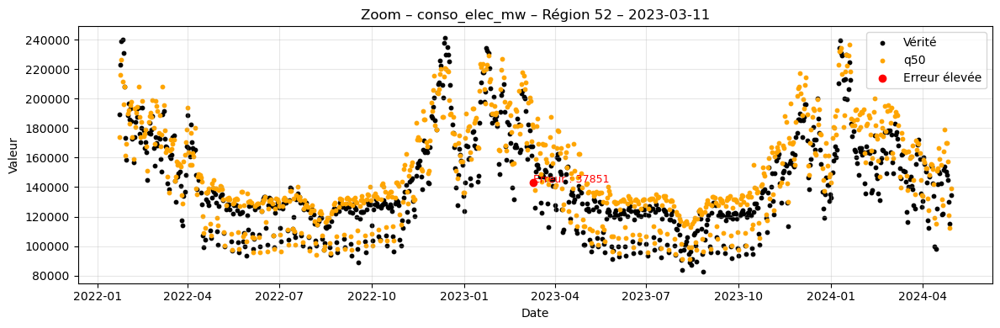

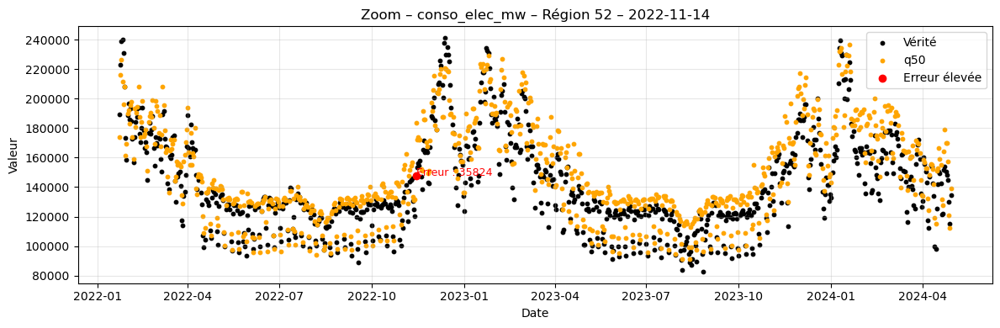

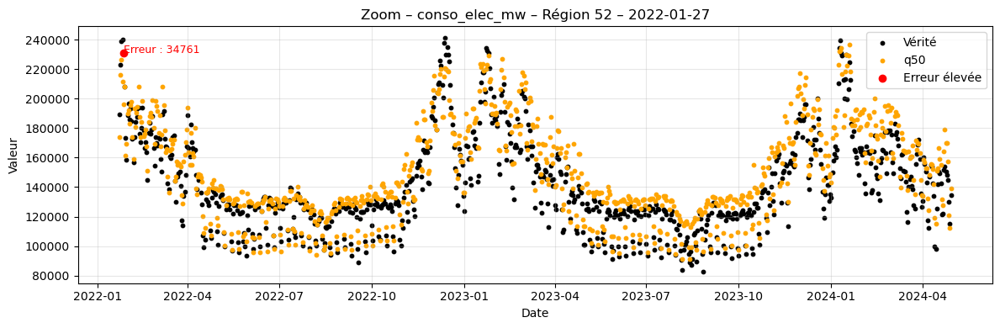


🔥 Top 5 erreurs – conso_elec_mw – Région 93
           date  conso_elec_mw            q50        erreur
8129 2023-12-02       245763.0  307021.473156  61258.473156
8045 2023-11-25       228789.0  273835.330941  45046.330941
8033 2023-11-24       232221.0  277019.930635  44798.930635
5158 2023-03-29       203073.0  247372.684329  44299.684329
8022 2023-11-23       229884.0  272800.327088  42916.327088


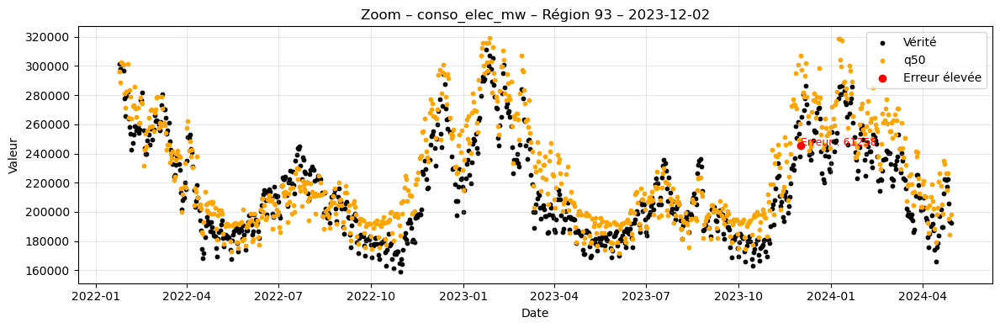

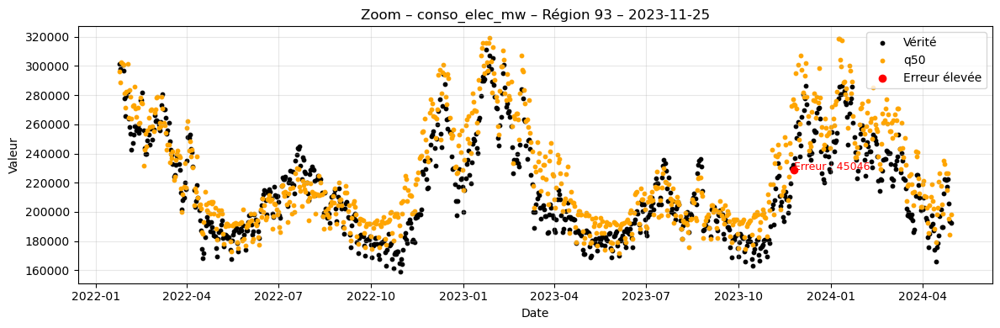

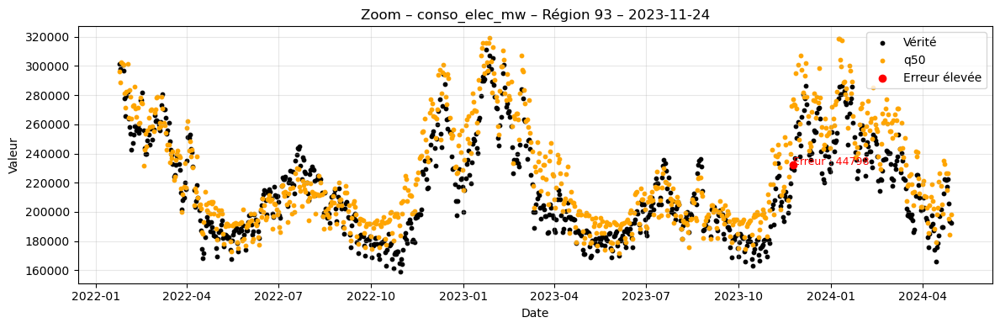

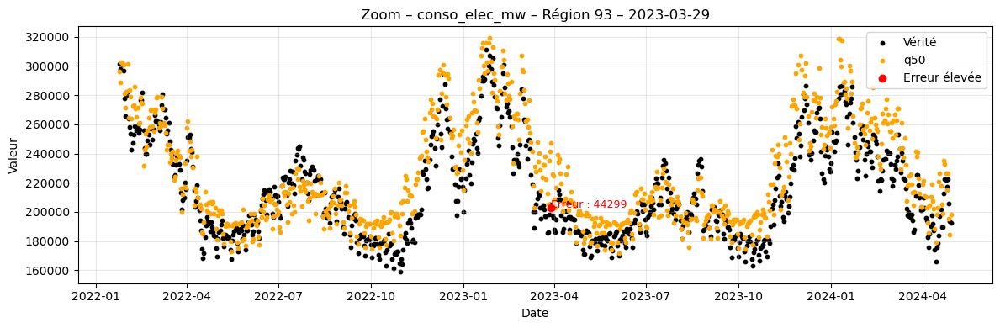

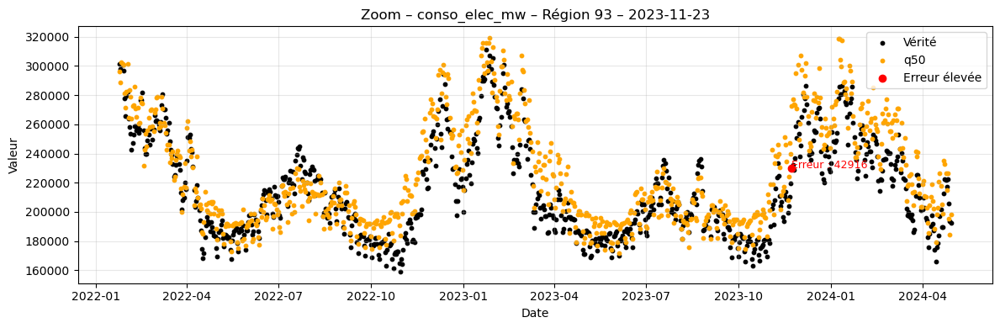


🔥 Top 5 erreurs – conso_elec_mw – Région 84
           date  conso_elec_mw            q50        erreur
4890 2023-03-07       413802.0  494936.966439  81134.966439
4135 2023-01-03       363213.0  440683.664995  77470.664995
4782 2023-02-26       386357.0  463467.031518  77110.031518
4051 2022-12-27       343784.0  418737.238424  74953.238424
4986 2023-03-15       365773.0  437790.056861  72017.056861


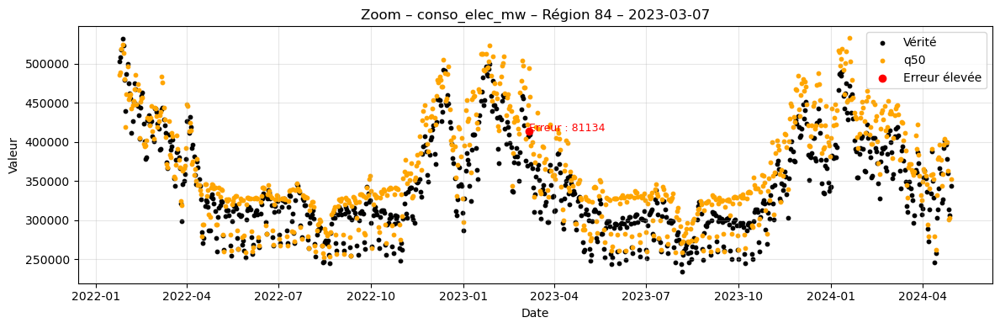

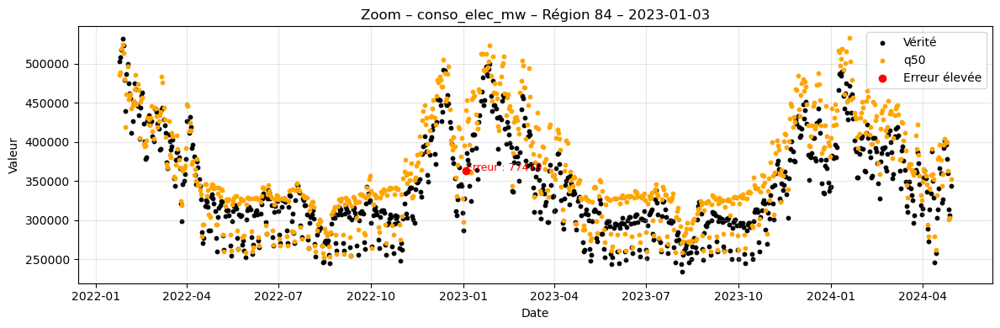

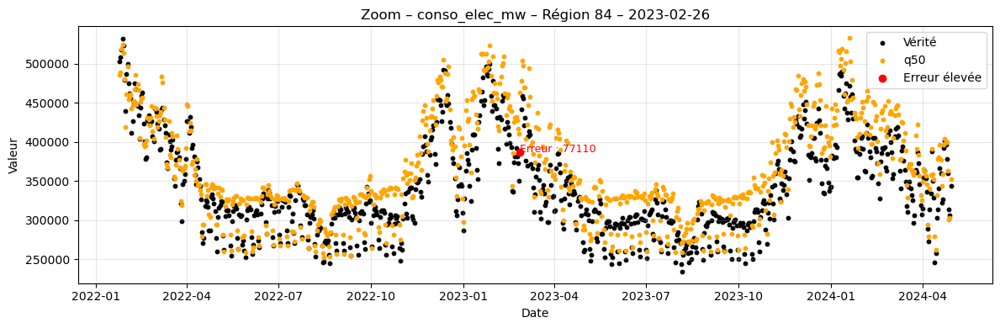

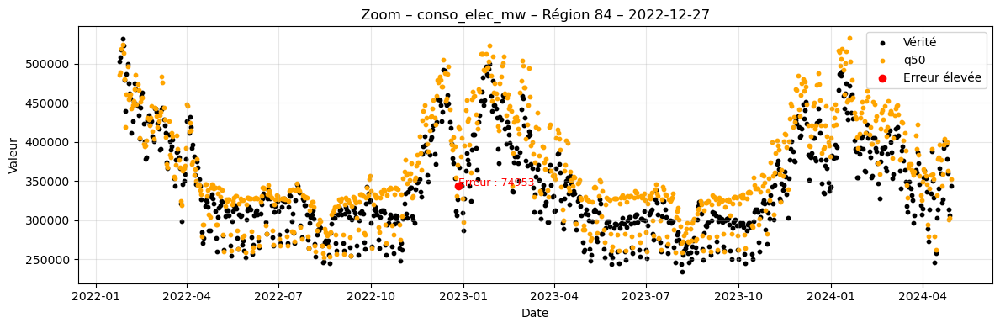

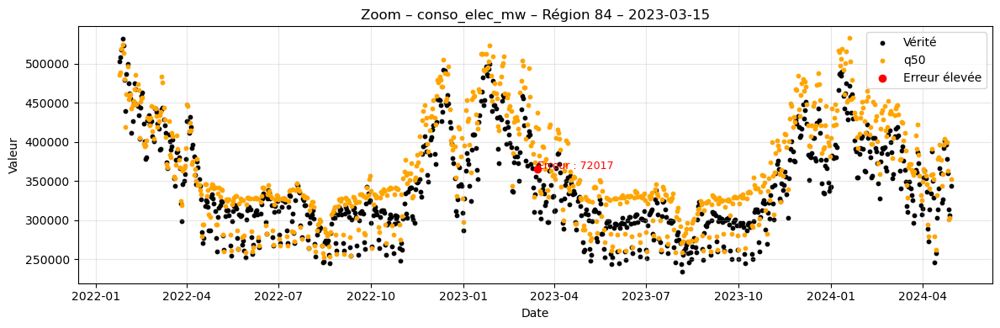


🔥 Top 5 erreurs – conso_elec_mw – Région 76
           date  conso_elec_mw            q50        erreur
8706 2024-01-19       270820.0  321947.959711  51127.959711
3584 2022-11-18       190713.0  238214.897990  47501.897990
7782 2023-11-03       201259.0  247474.892573  46215.892573
8911 2024-02-05       232916.0  278721.028293  45805.028293
7771 2023-11-02       184364.0  229312.582468  44948.582468


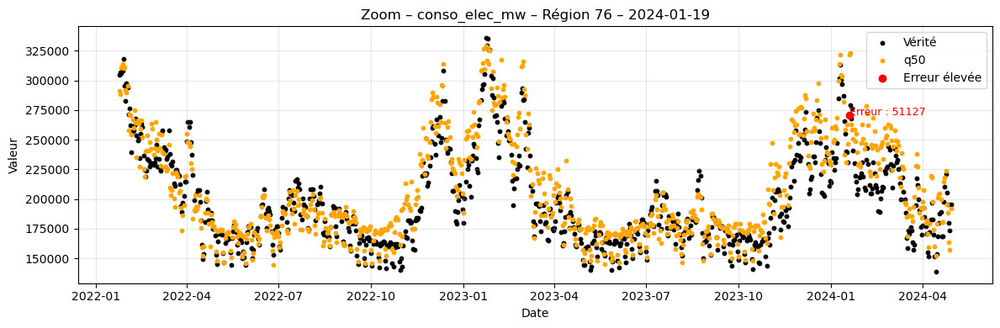

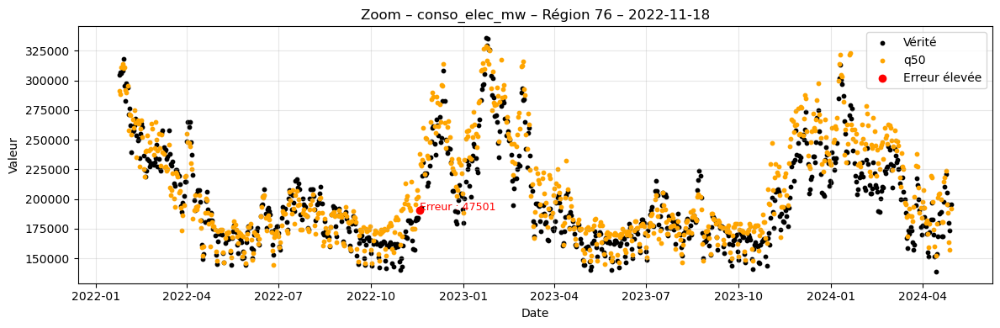

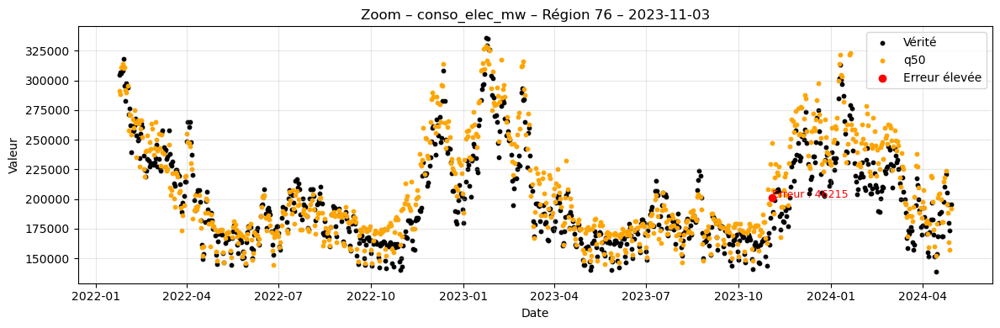

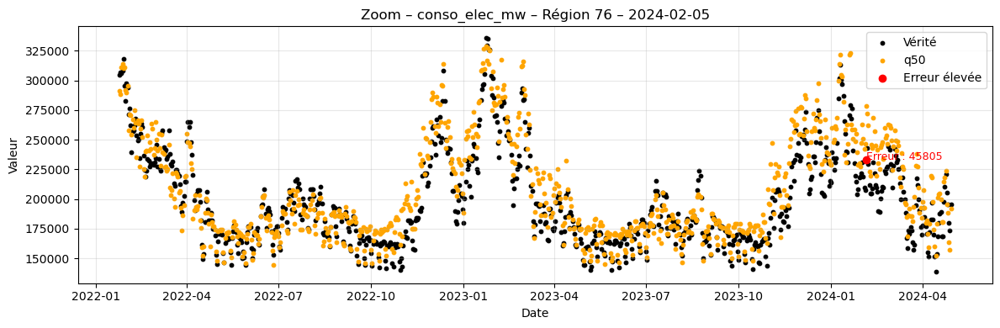

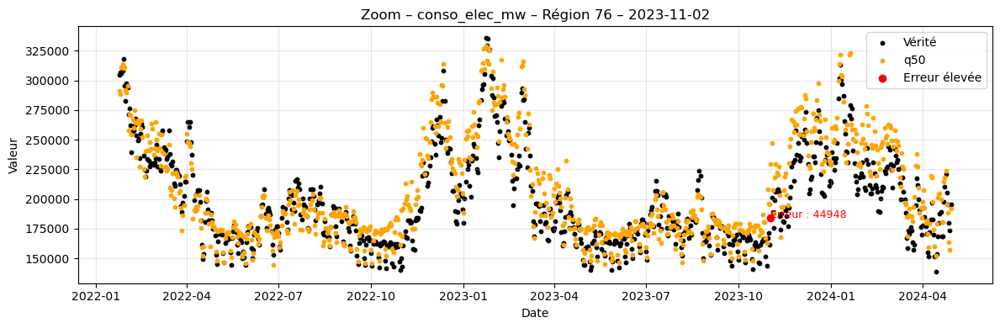


🔥 Top 5 erreurs – conso_elec_mw – Région 75
           date  conso_elec_mw            q50        erreur
4145 2023-01-04       241706.0  305566.151692  63860.151692
4124 2023-01-02       215701.0  273027.409758  57326.409758
4184 2023-01-07       221047.0  277634.660839  56587.660839
4268 2023-01-14       215830.0  270292.081043  54462.081043
4196 2023-01-08       211269.0  265257.059149  53988.059149


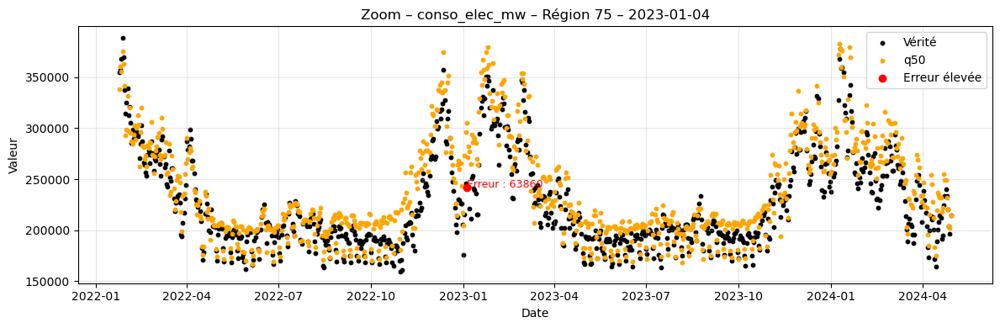

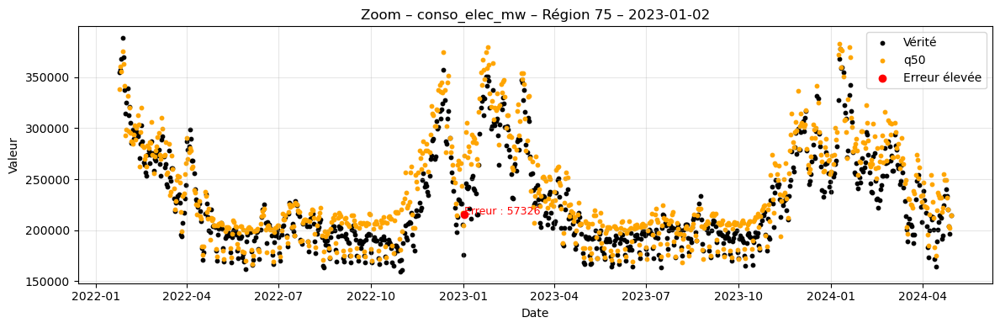

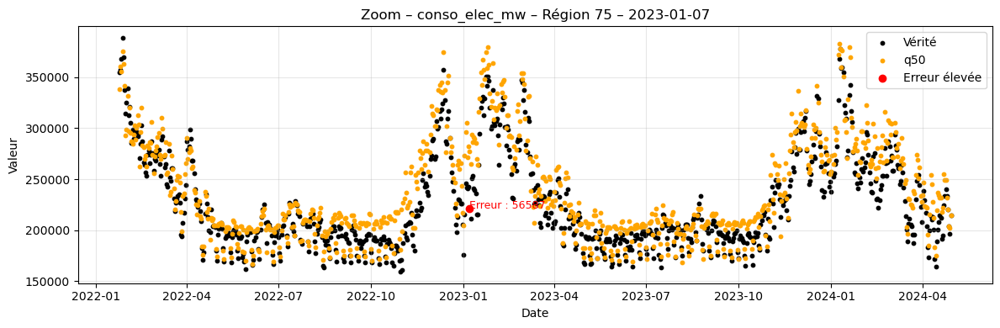

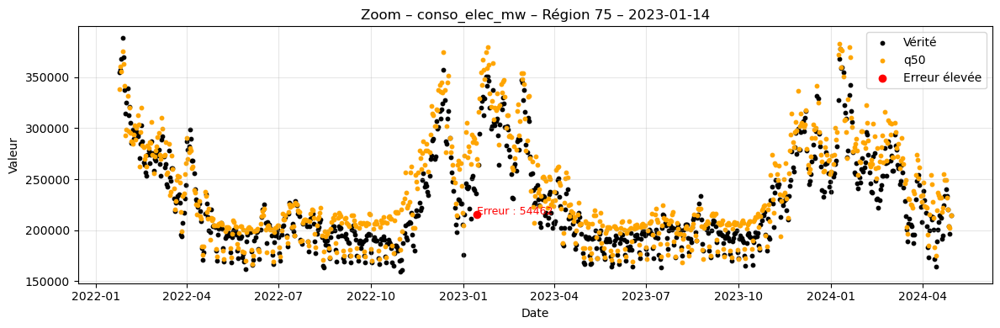

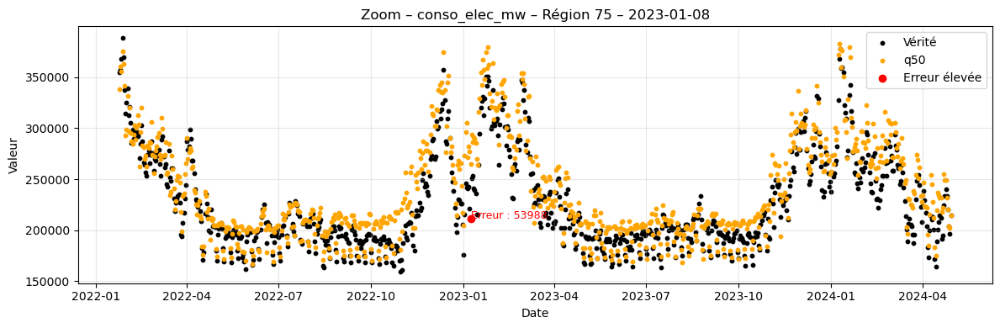


🔥 Top 5 erreurs – conso_elec_mw – Région 53
           date  conso_elec_mw            q50        erreur
3537 2022-11-14       108987.0  145722.316481  36735.316481
7773 2023-11-02        99027.0  135614.245883  36587.245883
3645 2022-11-23       128115.0  161839.971293  33724.971293
5422 2023-04-20       110027.0  142429.490369  32402.490369
3525 2022-11-13        84146.0  114825.783792  30679.783792


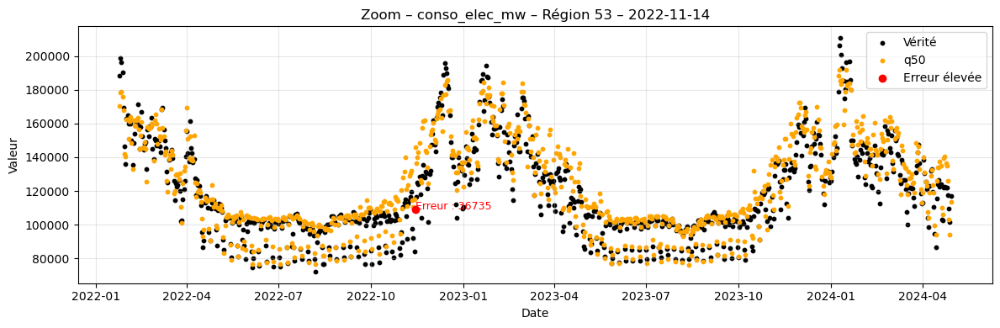

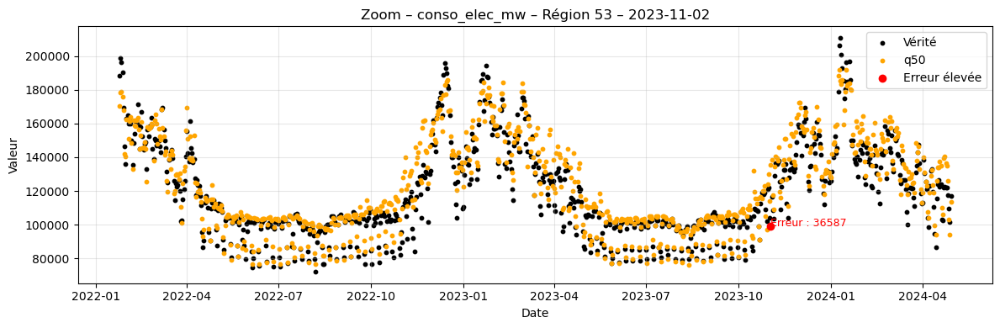

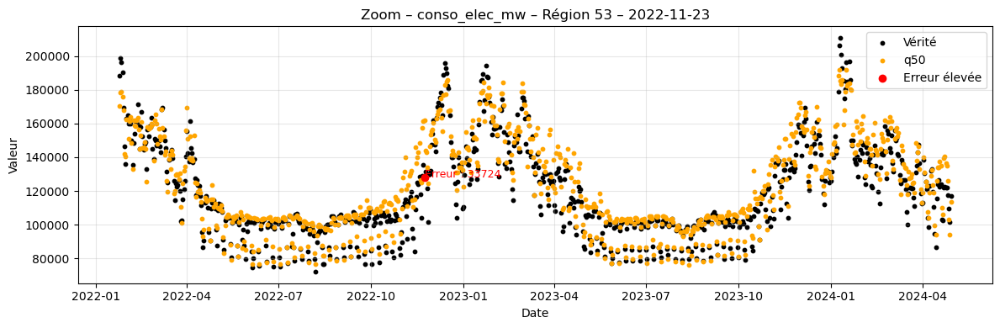

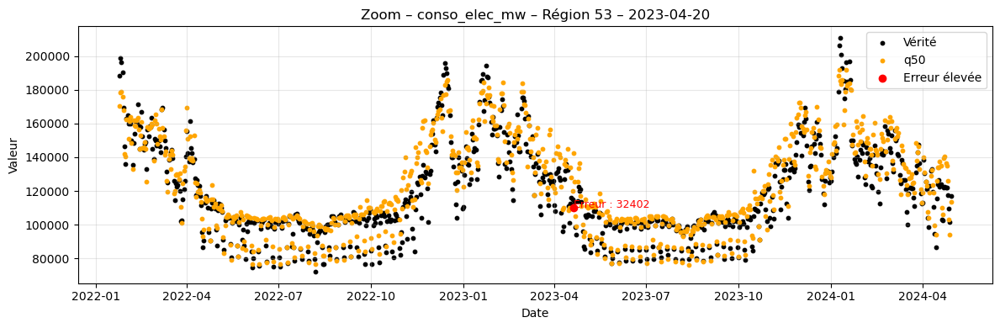

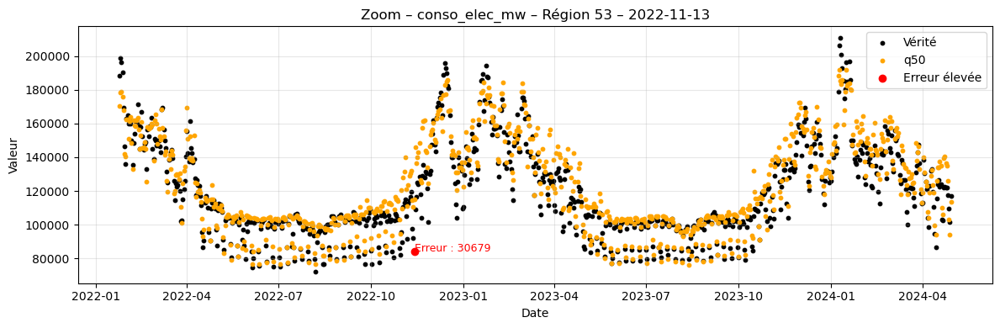


🔥 Top 5 erreurs – conso_elec_mw – Région 28
           date  conso_elec_mw            q50        erreur
1933 2022-07-03        65392.0  107696.790304  42304.790304
3373 2022-10-31       114729.0  153672.150350  38943.150350
4596 2023-02-10       179773.0  218286.673742  38513.673742
5137 2023-03-27       148853.0  186646.946590  37793.946590
7140 2023-09-10       146723.0  113076.023869  33646.976131


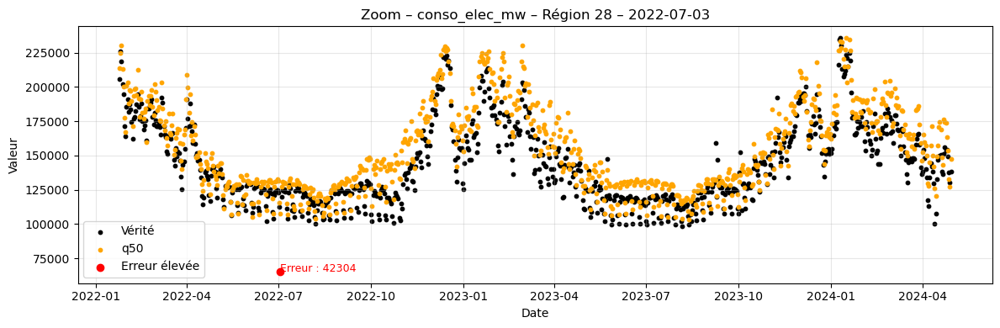

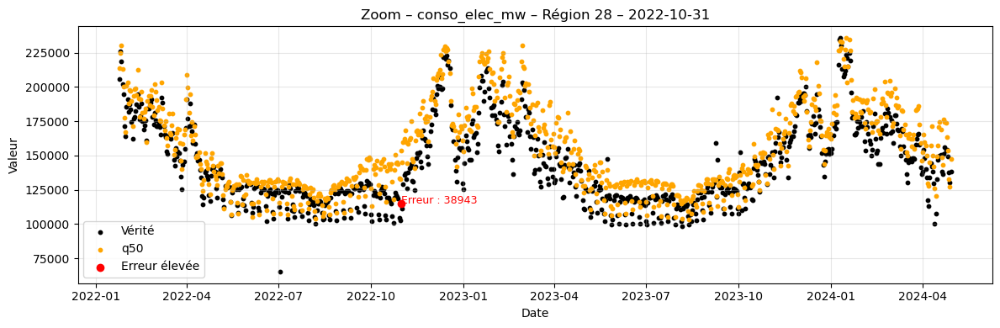

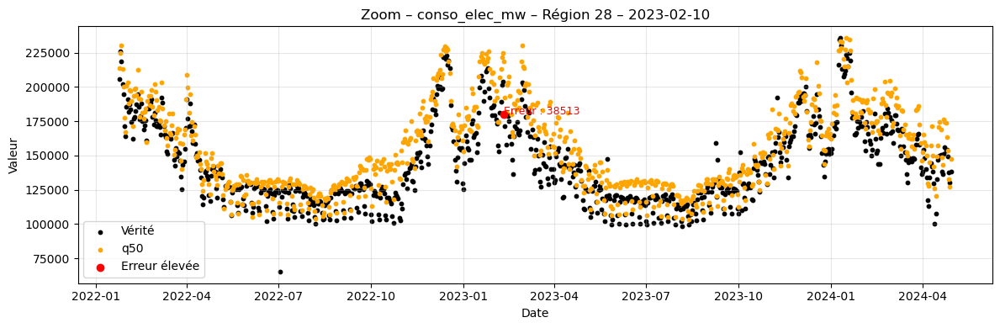

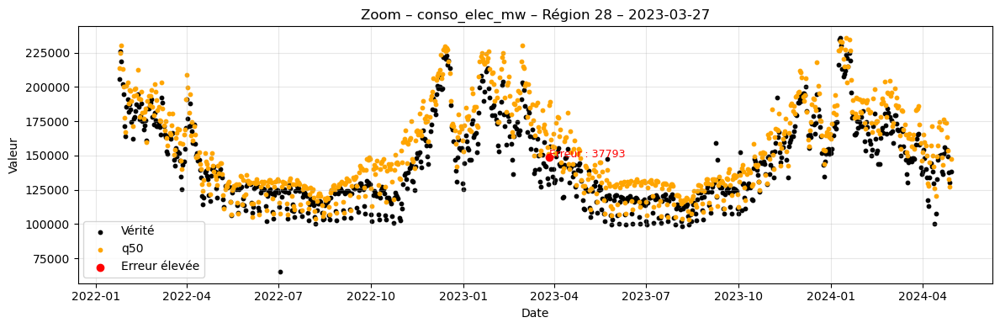

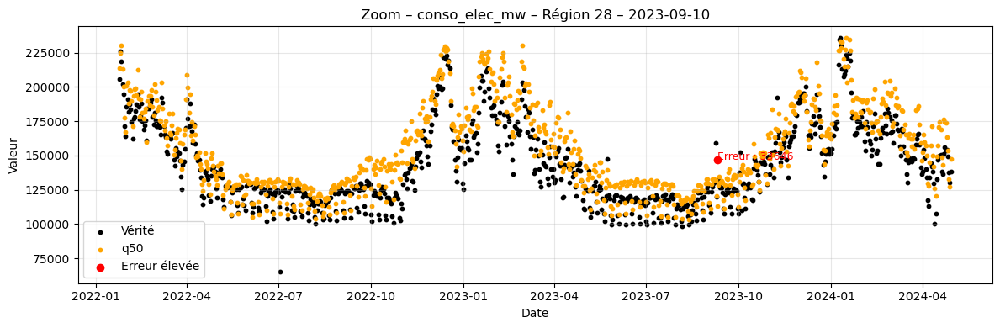


🔥 Top 5 erreurs – conso_elec_mw – Région 44
           date  conso_elec_mw            q50        erreur
8020 2023-11-22       259505.0  312624.895322  53119.895322
3371 2022-10-31       196540.0  249546.080033  53006.080033
4048 2022-12-26       197865.0  249878.839375  52013.839375
4132 2023-01-02       205488.0  257143.345065  51655.345065
7571 2023-10-16       218317.0  269548.581644  51231.581644


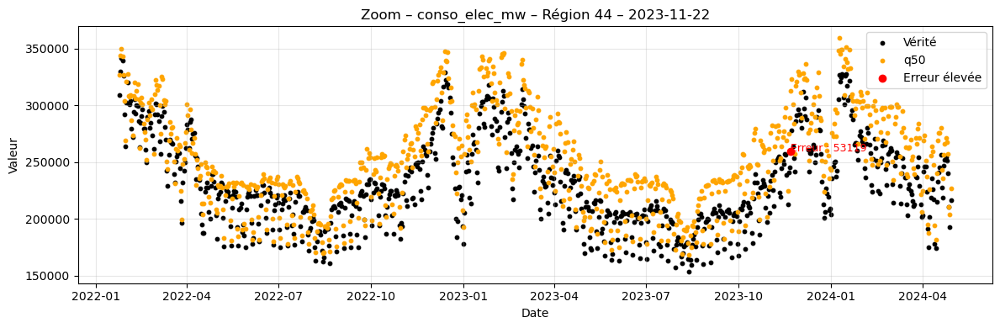

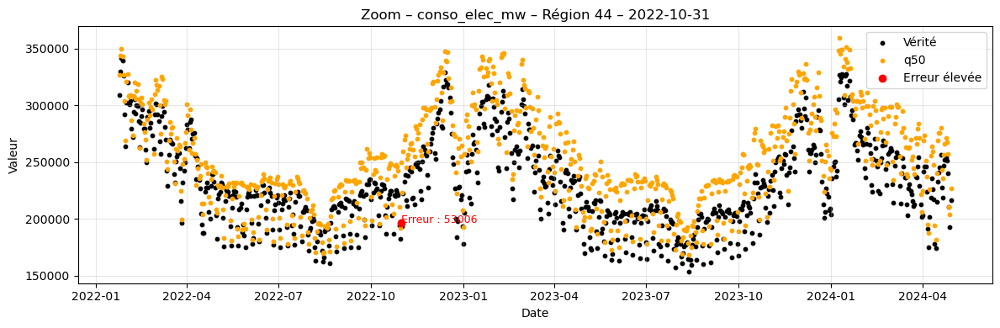

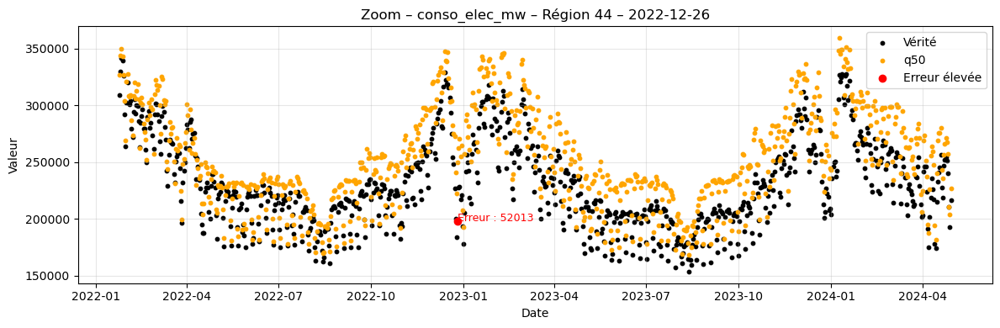

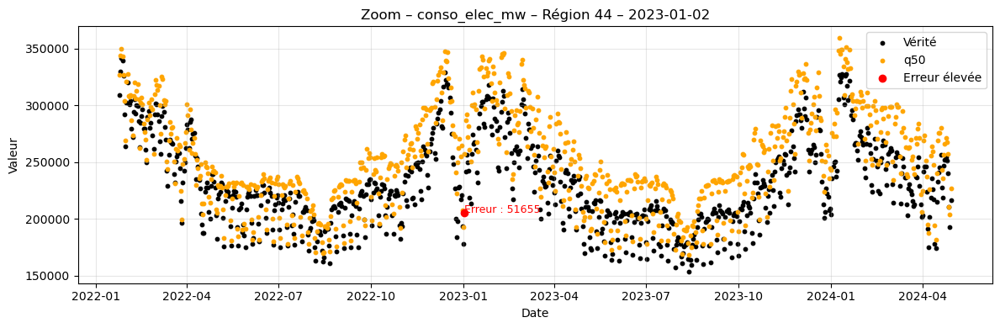

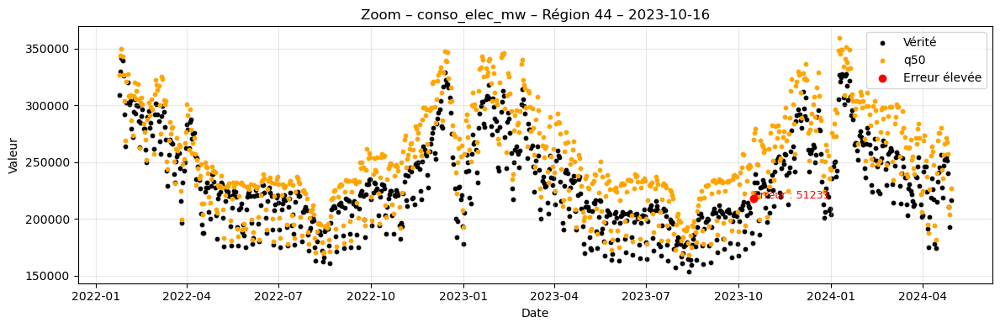


🔥 Top 5 erreurs – conso_gaz_mw – Région 32
           date  conso_gaz_mw            q50         erreur
4632 2023-02-13      105304.0  313546.301878  208242.301878
4548 2023-02-06       96211.0  304073.039482  207862.039482
4644 2023-02-14      112635.0  297588.819050  184953.819050
4512 2023-02-03      110366.0  275742.161941  165376.161941
4608 2023-02-11      123482.0  285338.920859  161856.920859


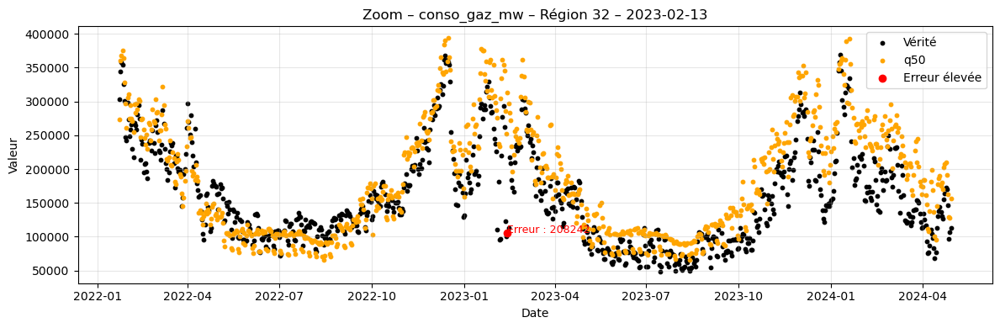

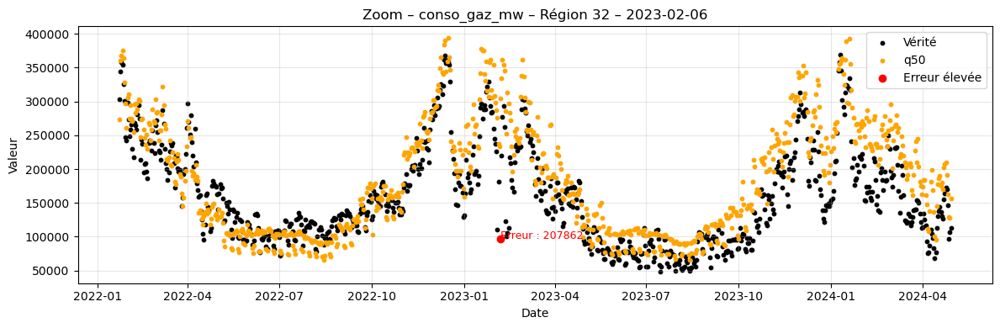

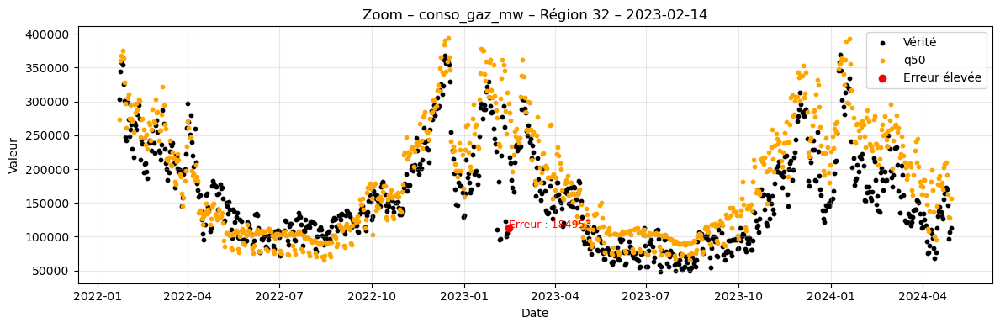

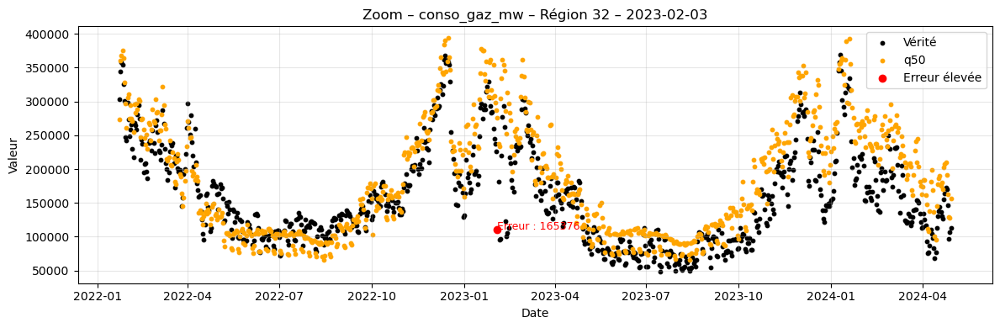

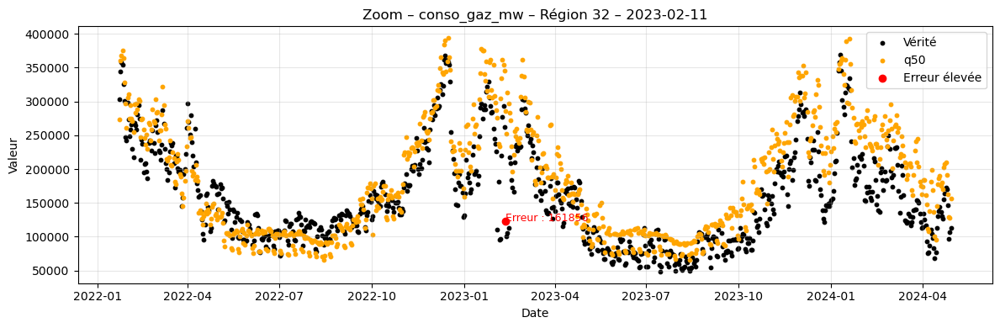


🔥 Top 5 erreurs – conso_gaz_mw – Région 27
           date  conso_gaz_mw            q50        erreur
4550 2023-02-06       15743.0  110380.062254  94637.062254
4646 2023-02-14       15901.0  108201.616005  92300.616005
4634 2023-02-13       16687.0   98166.806348  81479.806348
4622 2023-02-12       13334.0   83490.775431  70156.775431
4610 2023-02-11       32757.0   96059.089667  63302.089667


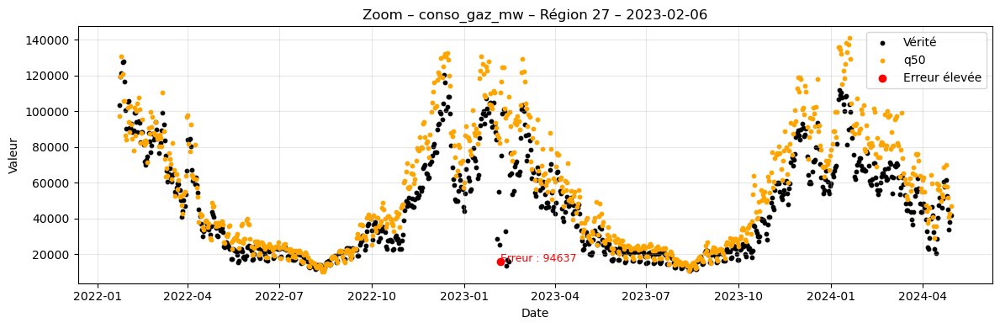

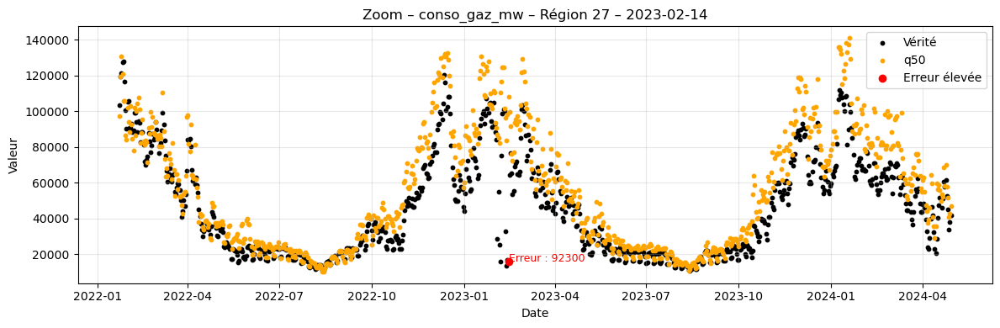

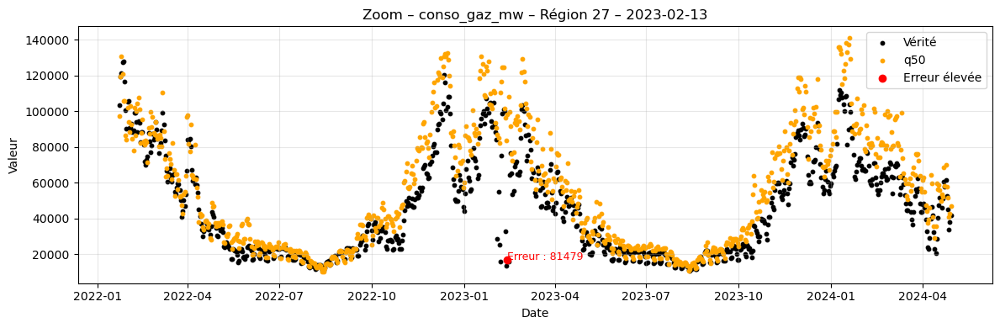

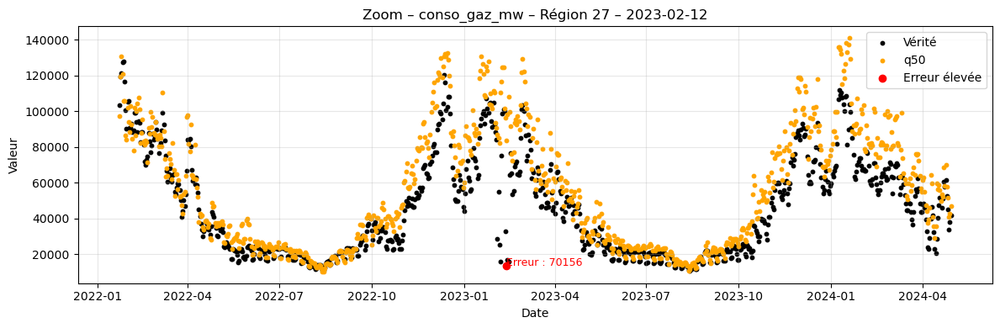

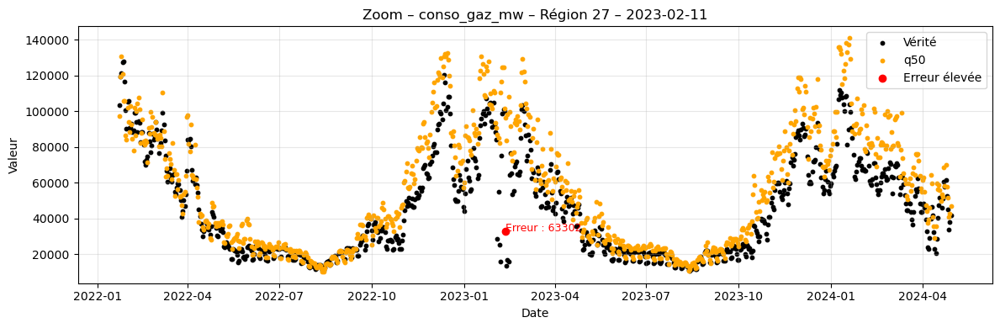


🔥 Top 5 erreurs – conso_gaz_mw – Région 24
           date  conso_gaz_mw           q50        erreur
4551 2023-02-06        5646.0  93591.173757  87945.173757
4635 2023-02-13        5810.0  68789.746876  62979.746876
4647 2023-02-14        6495.0  68277.879063  61782.879063
4623 2023-02-12        5106.0  60759.603159  55653.603159
4515 2023-02-03       15909.0  65258.248735  49349.248735


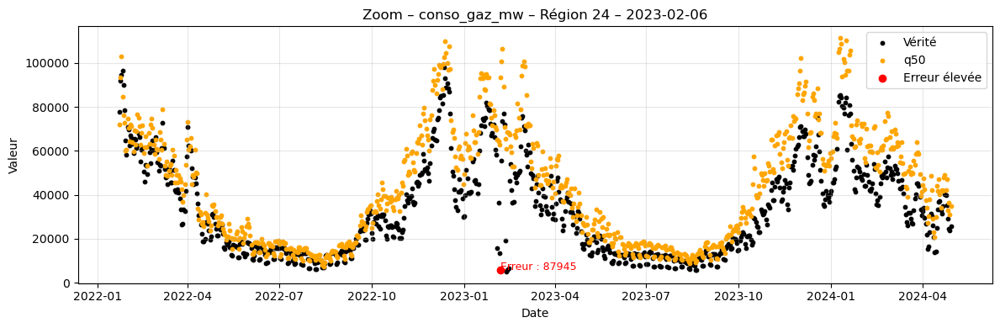

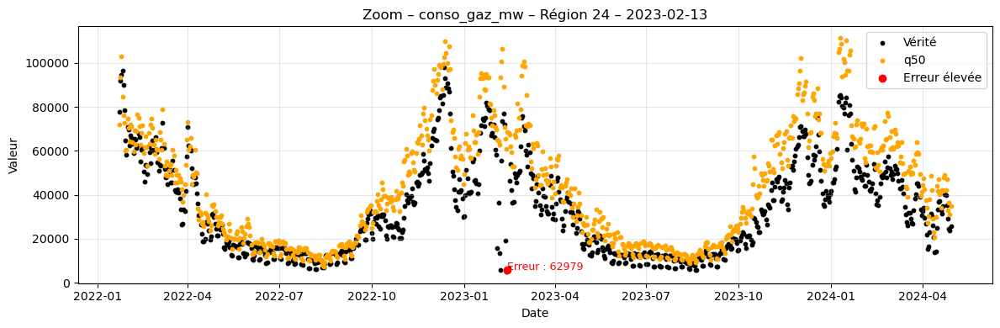

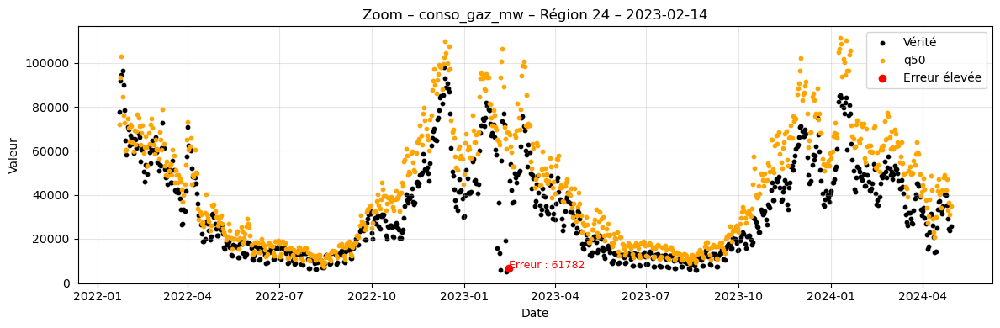

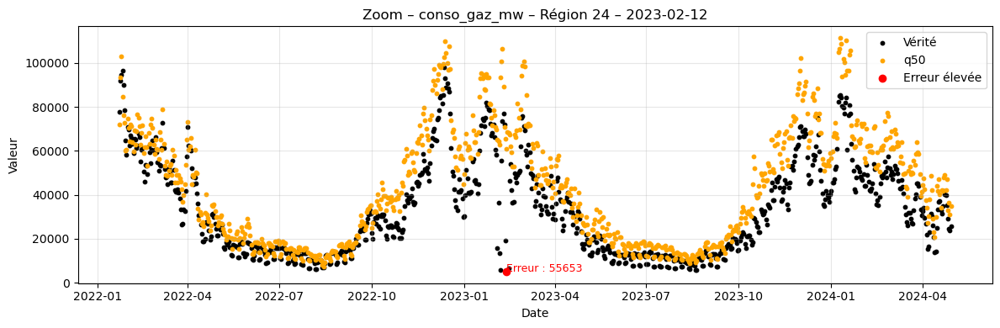

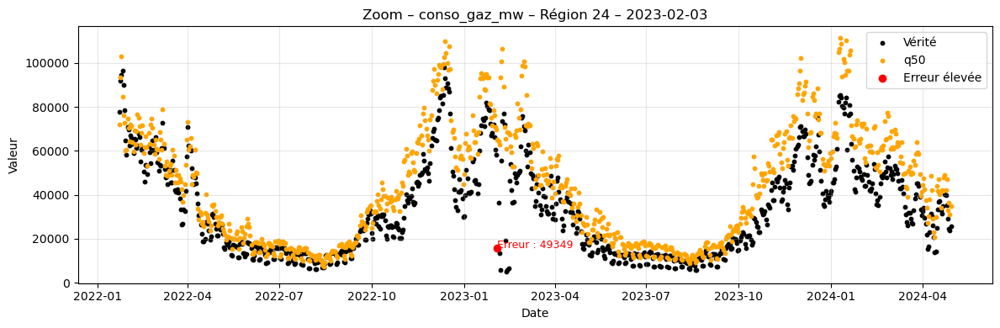


🔥 Top 5 erreurs – conso_gaz_mw – Région 11
          date  conso_gaz_mw            q50         erreur
52  2022-01-27      411449.0  197676.177182  213772.822818
820 2022-04-01      390571.0  180728.835450  209842.164550
28  2022-01-25      485560.0  289027.524597  196532.475403
520 2022-03-07      399689.0  207067.264633  192621.735367
99  2022-01-31      382528.0  191855.268610  190672.731390


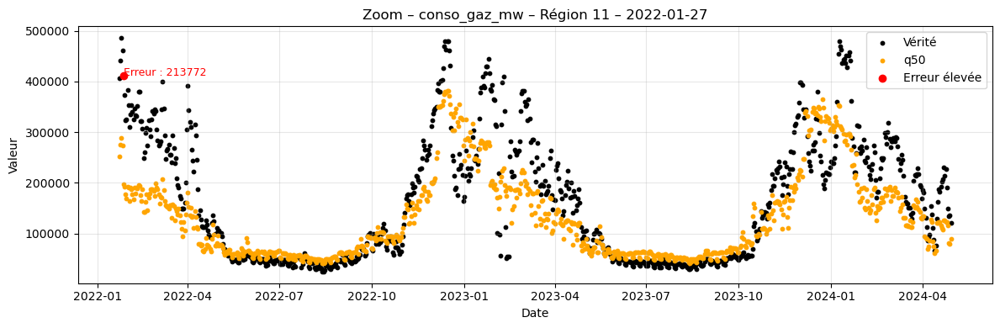

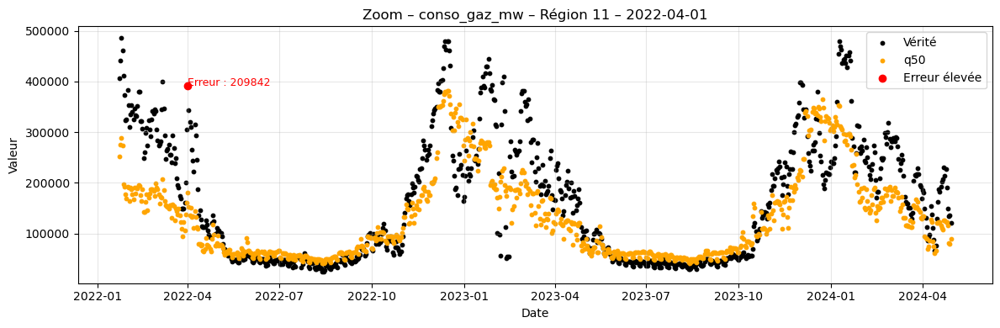

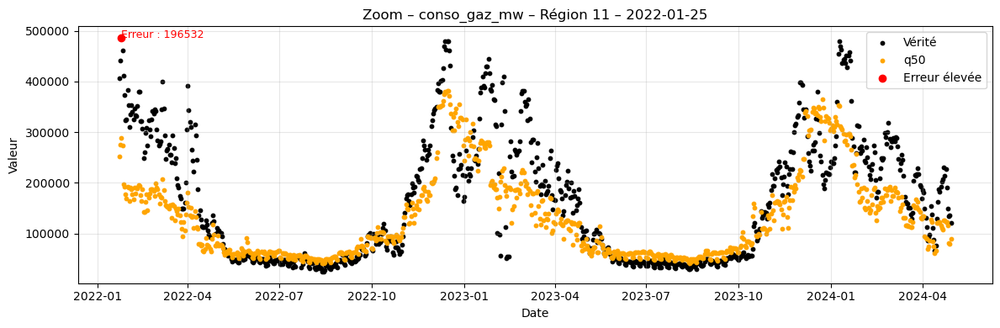

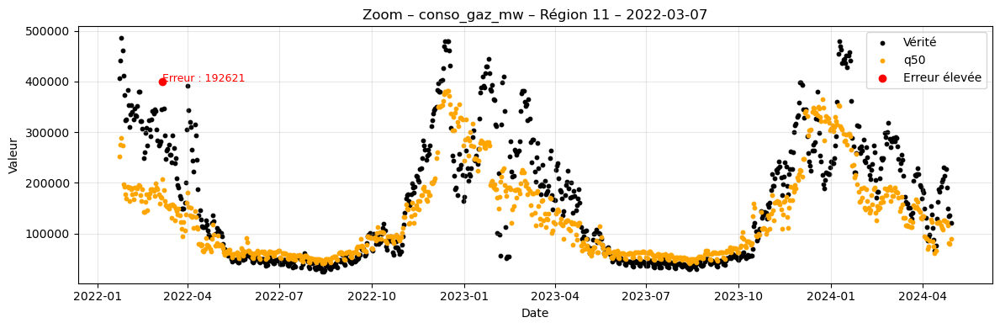

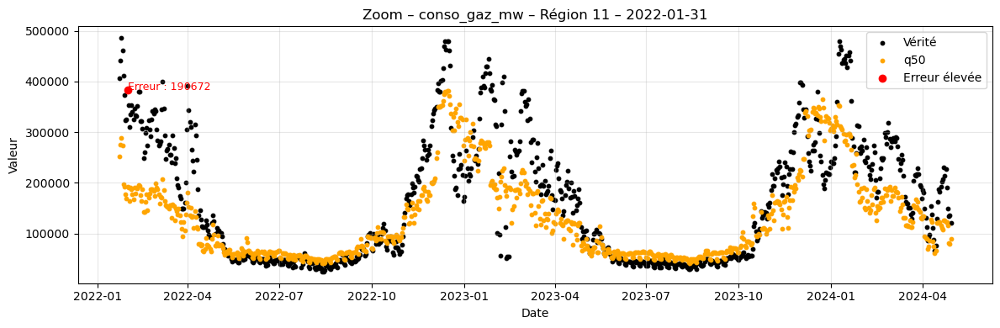


🔥 Top 5 erreurs – conso_gaz_mw – Région 52
           date  conso_gaz_mw            q50        erreur
4546 2023-02-06       25460.0  122411.990609  96951.990609
4642 2023-02-14       25183.0  111795.893920  86612.893920
4630 2023-02-13       29459.0  110227.132120  80768.132120
4534 2023-02-05       18854.0   83345.220721  64491.220721
4618 2023-02-12       24888.0   80083.081630  55195.081630


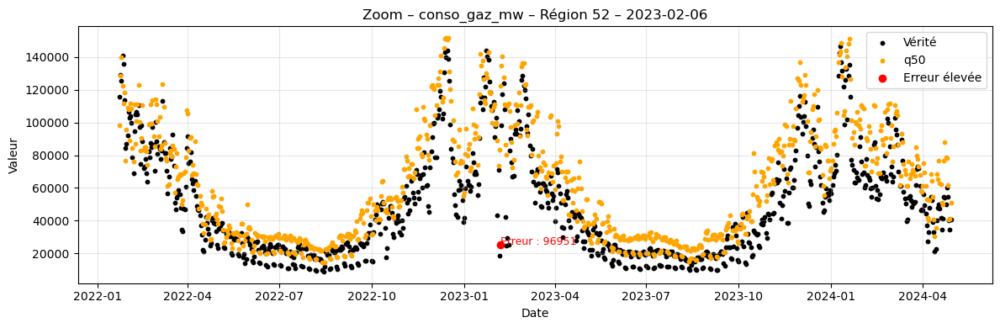

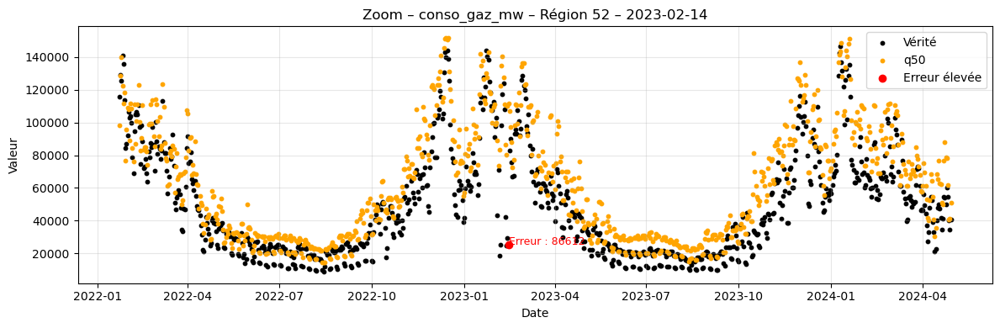

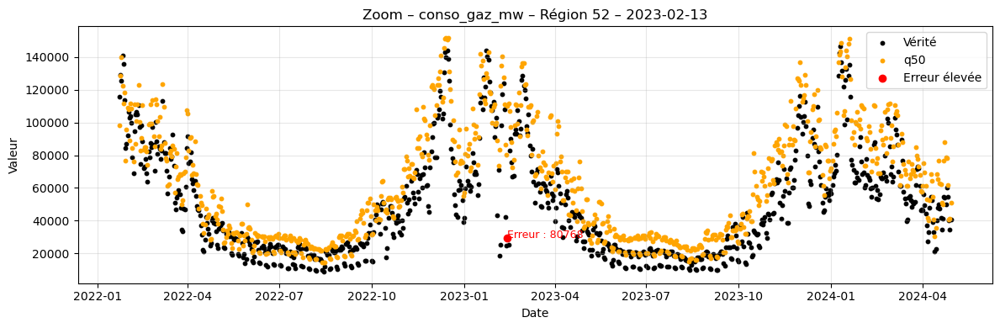

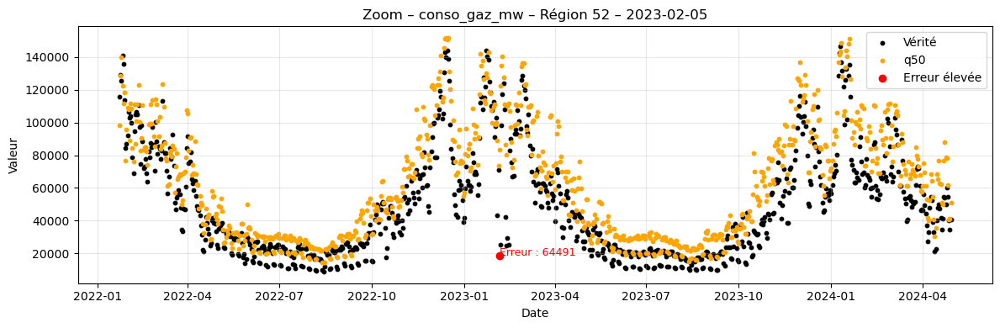

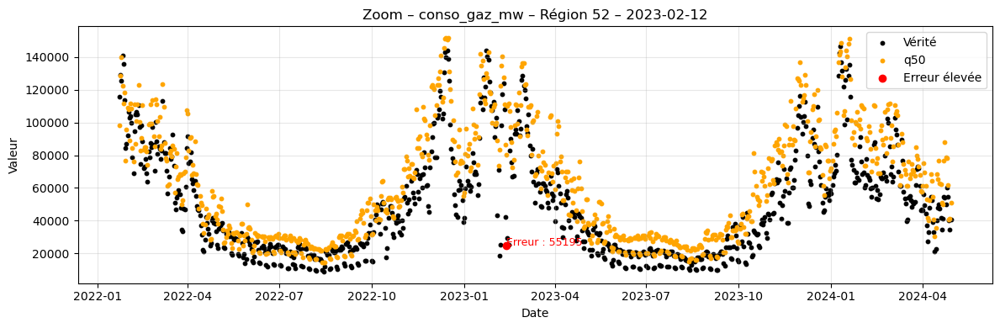


🔥 Top 5 erreurs – conso_gaz_mw – Région 93
           date  conso_gaz_mw            q50        erreur
8022 2023-11-23       91725.0  176664.744903  84939.744903
4553 2023-02-07       96068.0  178918.796355  82850.796355
7784 2023-11-03       67651.0  147501.636157  79850.636157
8350 2023-12-20      109321.0  186405.259396  77084.259396
4625 2023-02-13       94305.0  171087.571366  76782.571366


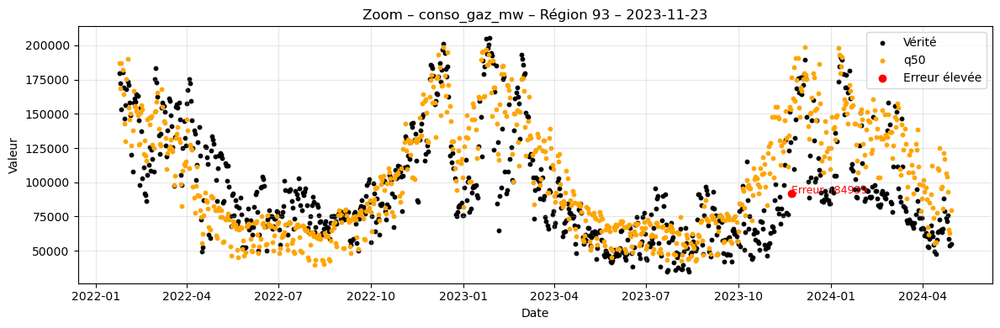

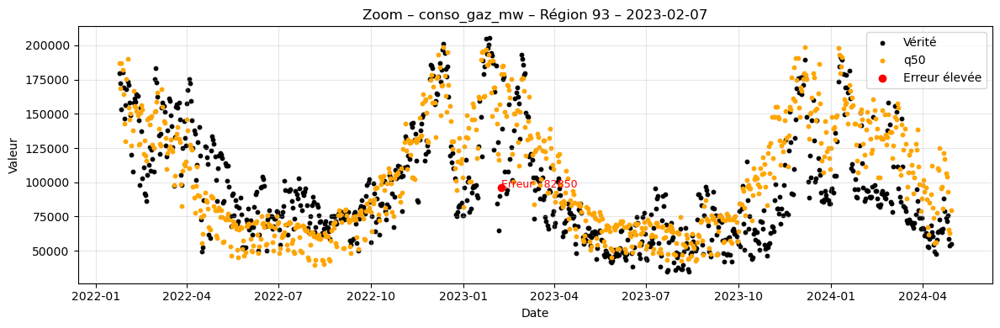

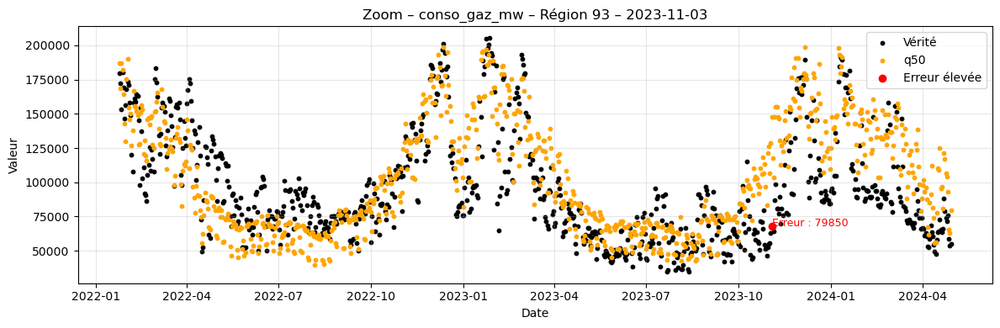

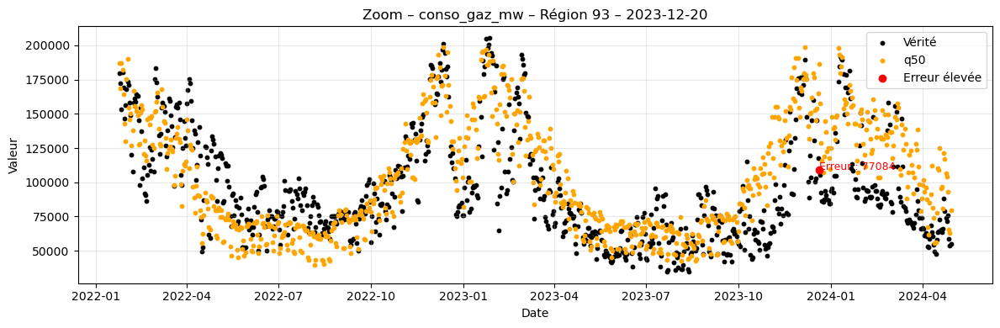

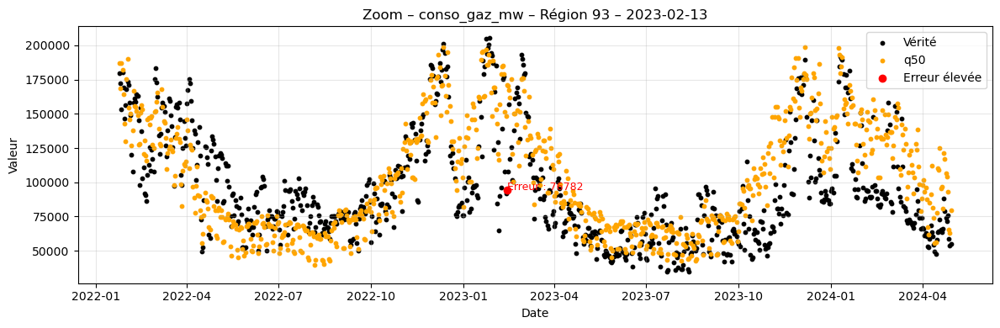


🔥 Top 5 erreurs – conso_gaz_mw – Région 84
           date  conso_gaz_mw            q50         erreur
4542 2023-02-06       53997.0  252279.418251  198282.418251
4626 2023-02-13       53288.0  246815.764154  193527.764154
4614 2023-02-12       40365.0  228022.950985  187657.950985
4638 2023-02-14       52951.0  238362.815683  185411.815683
4603 2023-02-11       93053.0  250462.896281  157409.896281


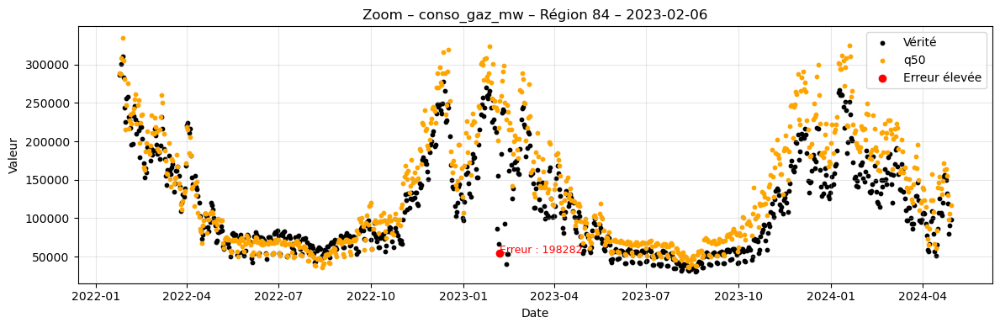

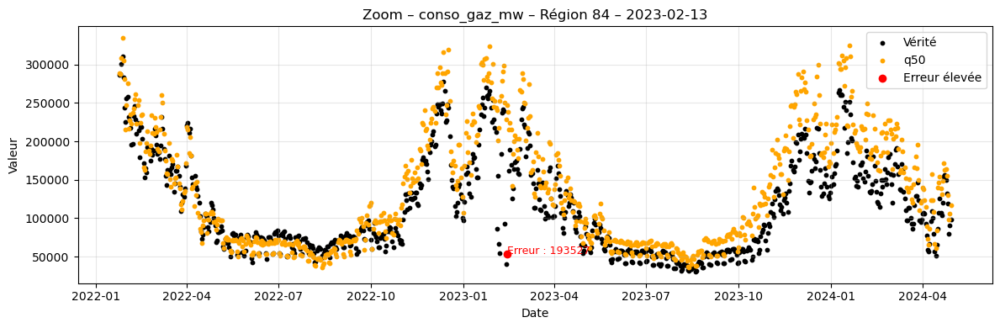

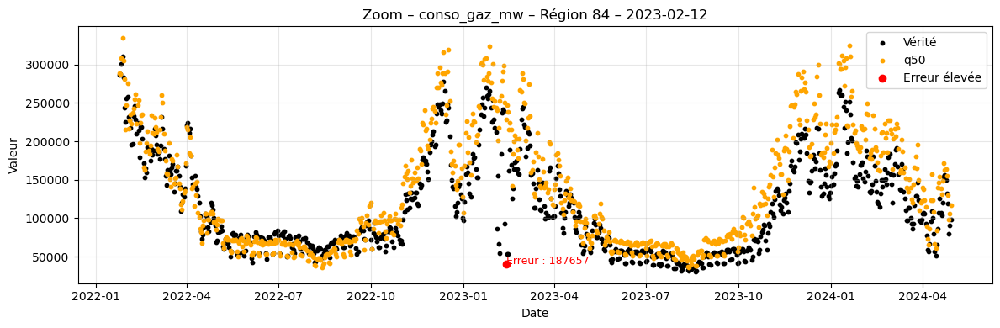

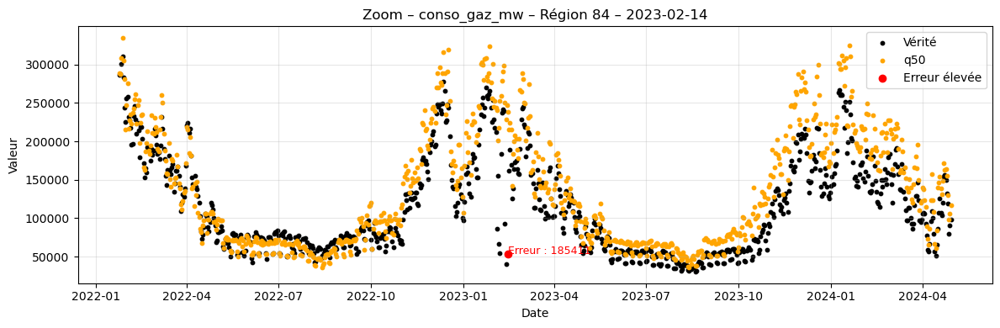

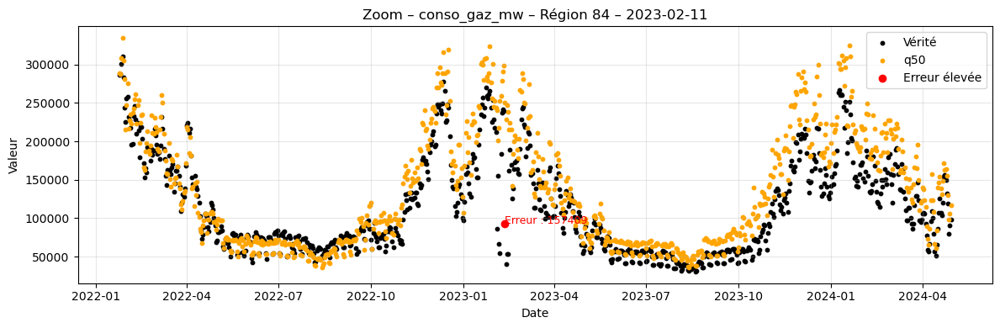


🔥 Top 5 erreurs – conso_gaz_mw – Région 76
           date  conso_gaz_mw           q50        erreur
1015 2022-04-18      100583.0  34017.383439  66565.616561
1003 2022-04-17       97517.0  31246.428176  66270.571824
1136 2022-04-28       97744.0  35794.496322  61949.503678
1147 2022-04-29       88233.0  28123.738738  60109.261262
1159 2022-04-30       85121.0  26715.706732  58405.293268


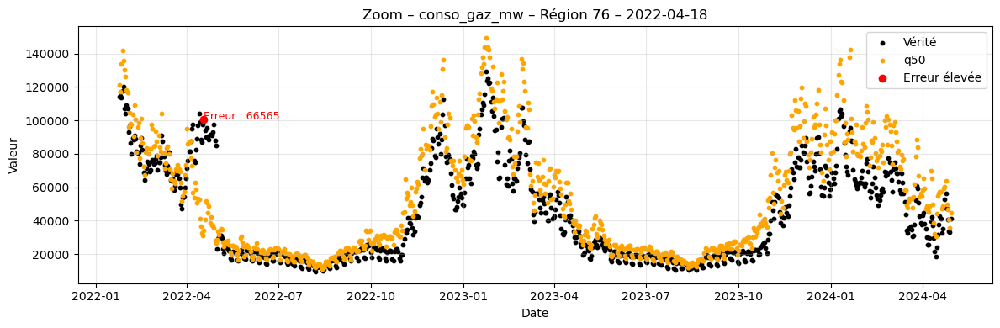

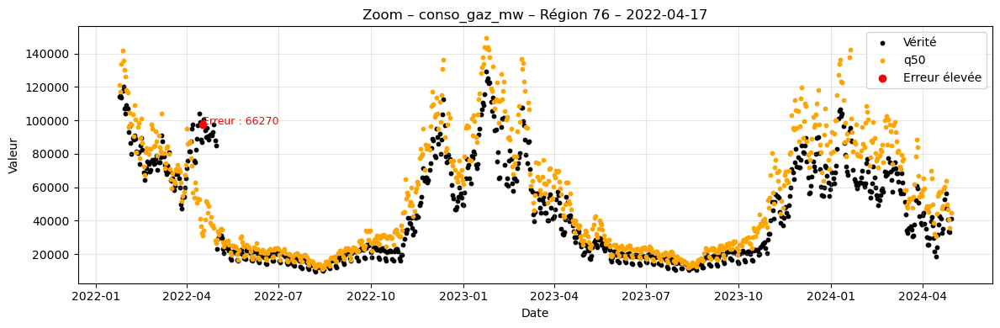

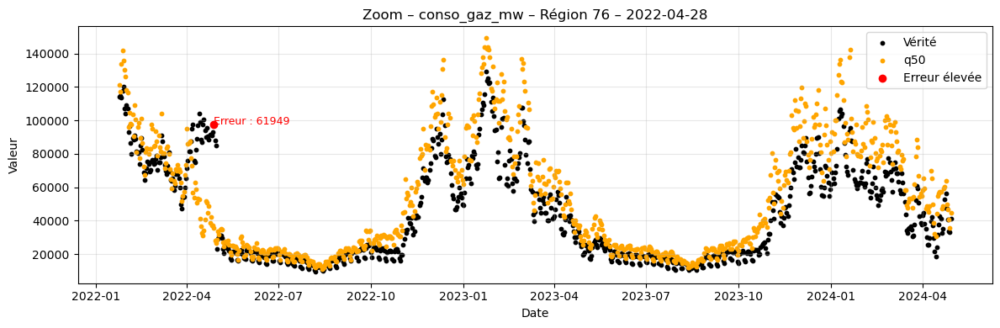

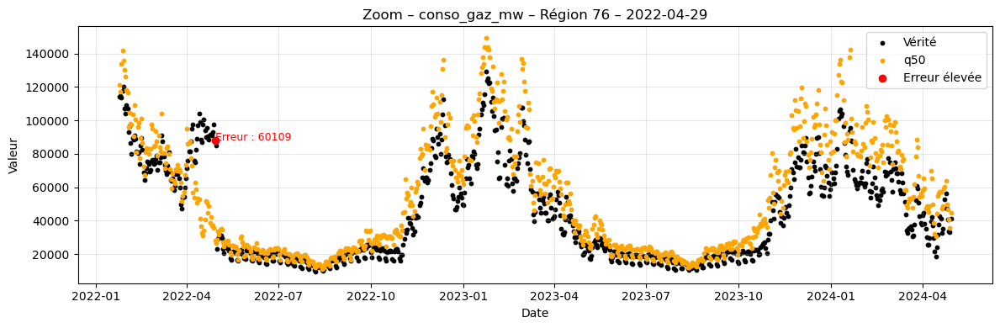

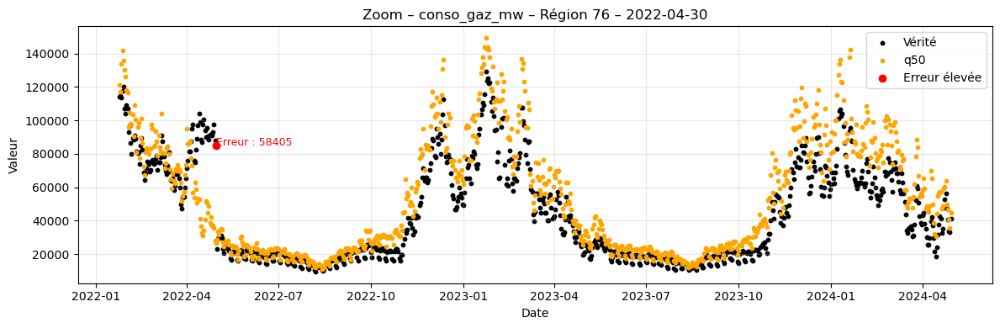


🔥 Top 5 erreurs – conso_gaz_mw – Région 75
           date  conso_gaz_mw            q50        erreur
4544 2023-02-06       73084.0  154634.206122  81550.206122
4605 2023-02-11       84658.0  165244.121981  80586.121981
4640 2023-02-14       70682.0  148152.415138  77470.415138
4628 2023-02-13       72582.0  147629.293955  75047.293955
1004 2022-04-17      115074.0   43949.627605  71124.372395


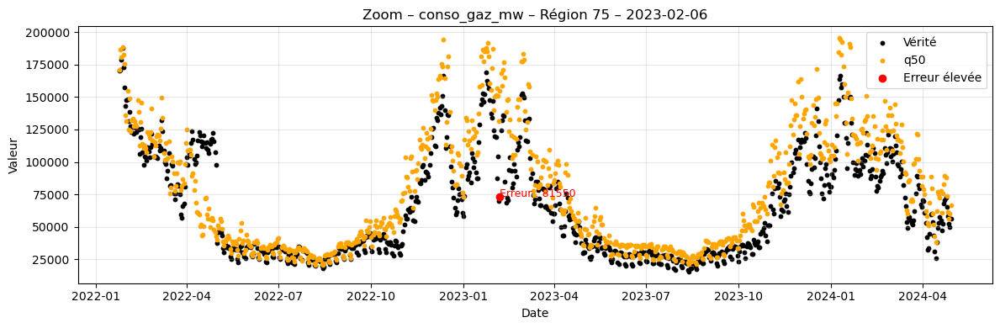

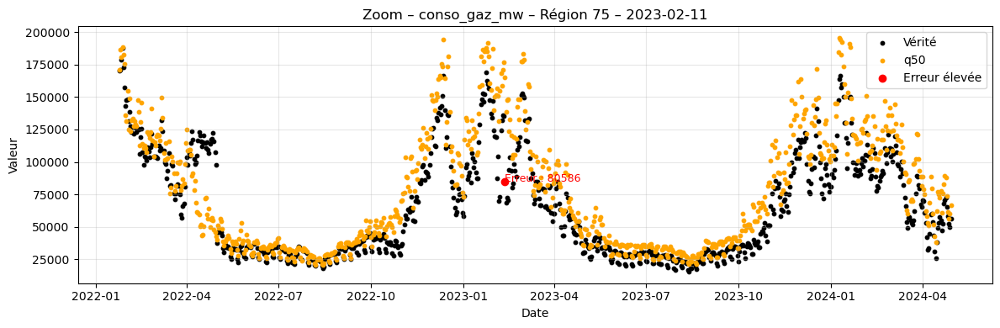

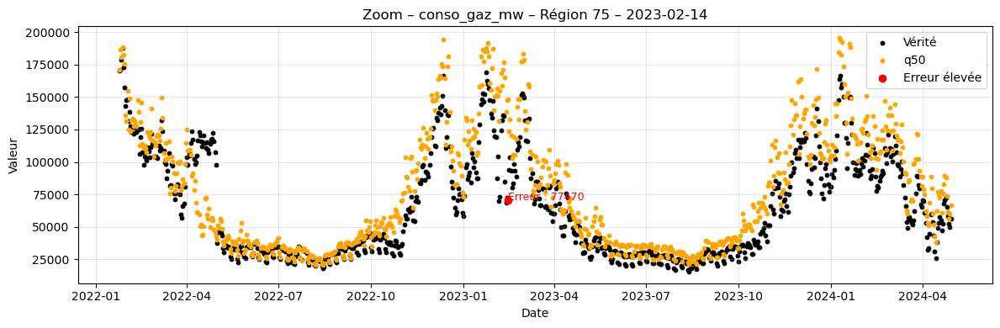

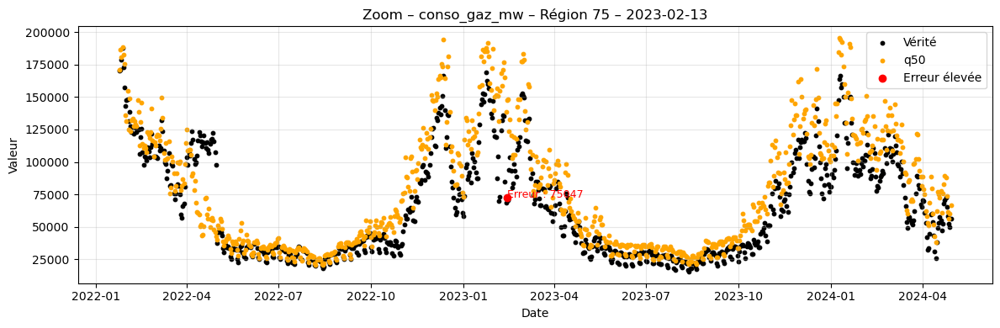

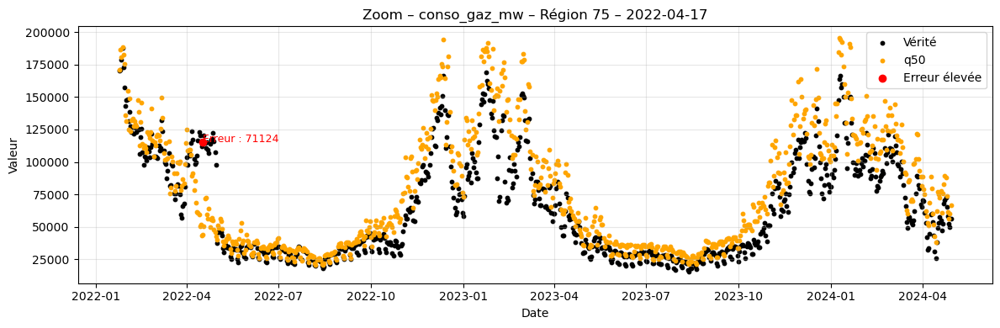


🔥 Top 5 erreurs – conso_gaz_mw – Région 53
           date  conso_gaz_mw           q50        erreur
4545 2023-02-06       24723.0  80013.362595  55290.362595
4641 2023-02-14       24778.0  73500.201287  48722.201287
4629 2023-02-13       24829.0  72303.204974  47474.204974
4529 2023-02-05       20183.0  58666.997791  38483.997791
4617 2023-02-12       19060.0  56891.021488  37831.021488


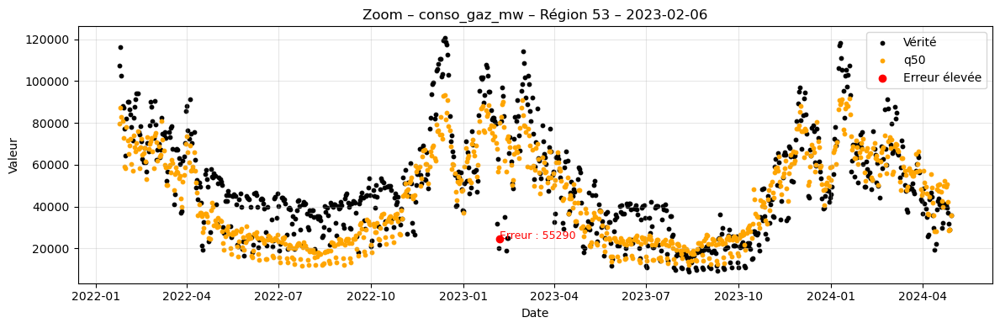

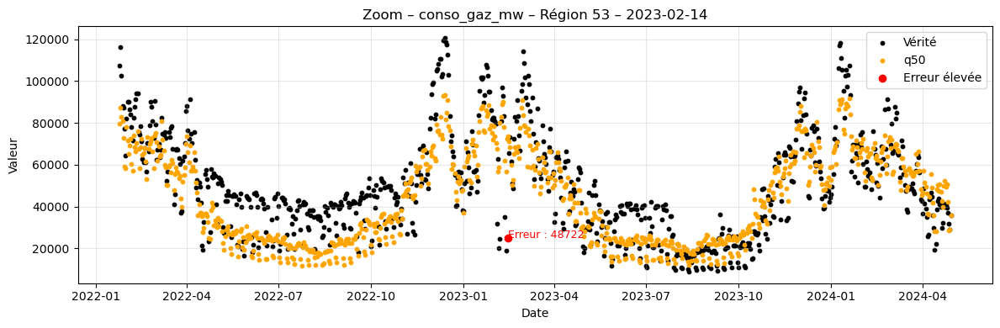

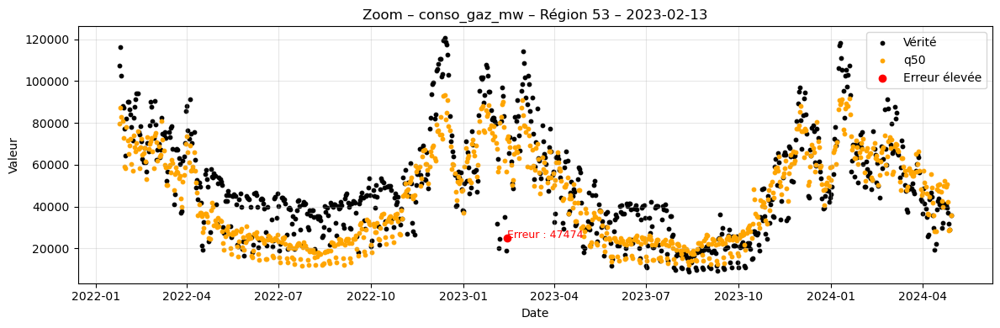

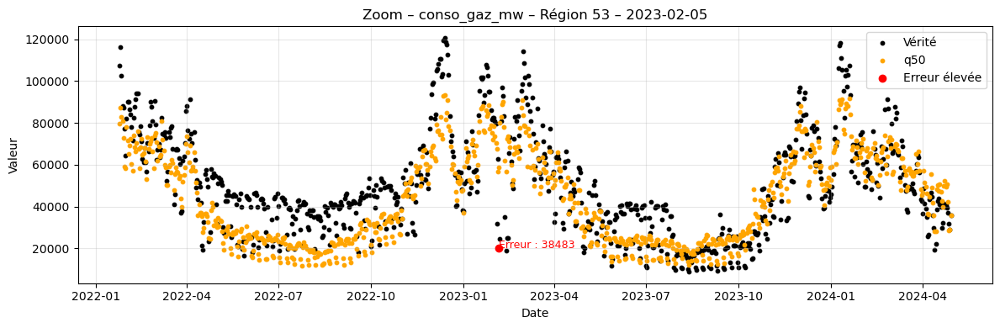

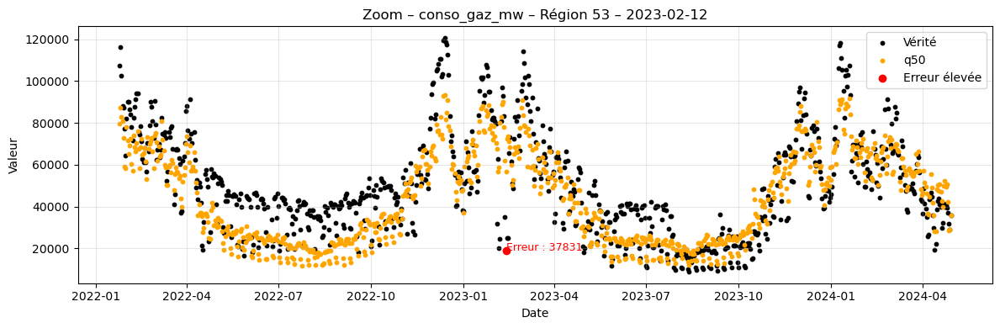


🔥 Top 5 erreurs – conso_gaz_mw – Région 28
           date  conso_gaz_mw            q50         erreur
4549 2023-02-06       72328.0  174826.668666  102498.668666
4645 2023-02-14       69717.0  168517.058115   98800.058115
4633 2023-02-13       69822.0  167165.990788   97343.990788
4621 2023-02-12       68802.0  156574.718434   87772.718434
4537 2023-02-05       77127.0  156477.143598   79350.143598


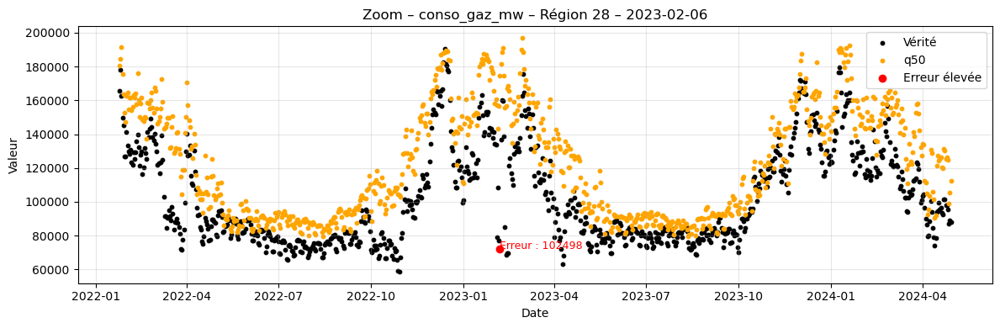

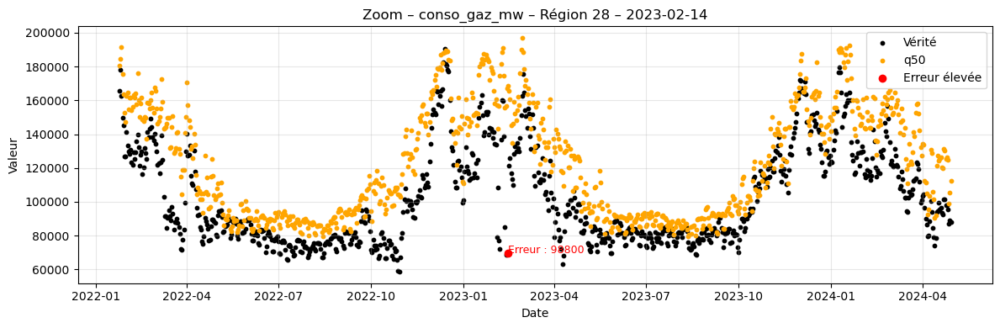

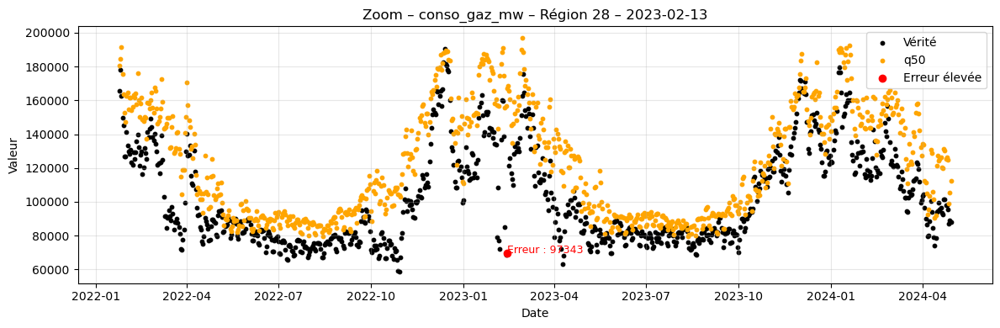

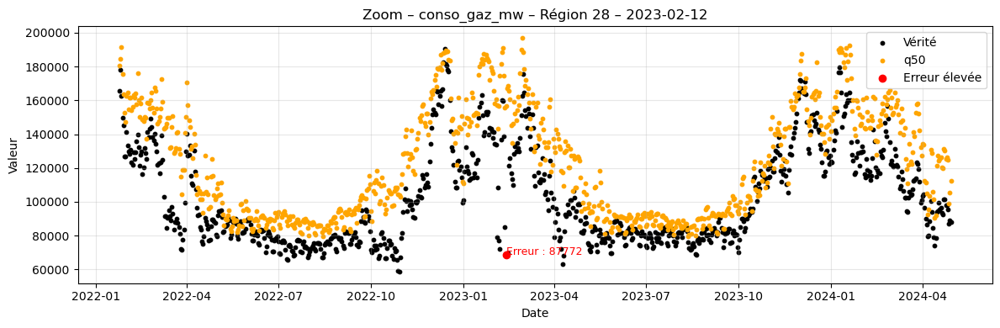

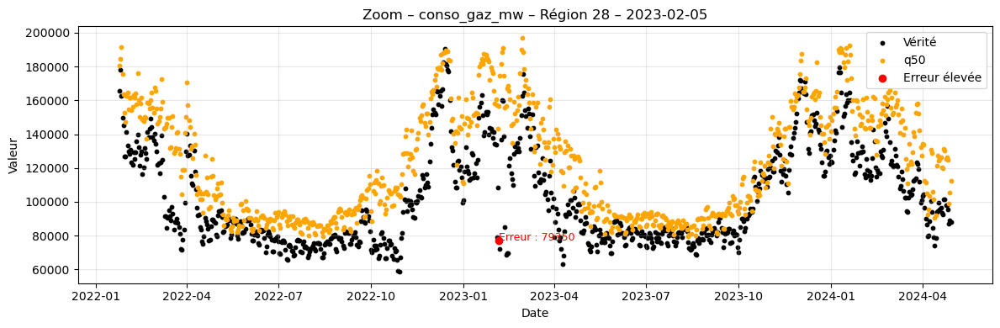


🔥 Top 5 erreurs – conso_gaz_mw – Région 44
           date  conso_gaz_mw            q50         erreur
4643 2023-02-14      144882.0  344771.839661  199889.839661
4547 2023-02-06      139959.0  337108.570154  197149.570154
4631 2023-02-13      143761.0  299583.850186  155822.850186
8027 2023-11-23      194372.0  334447.581658  140075.581658
4535 2023-02-05      112263.0  249571.258097  137308.258097


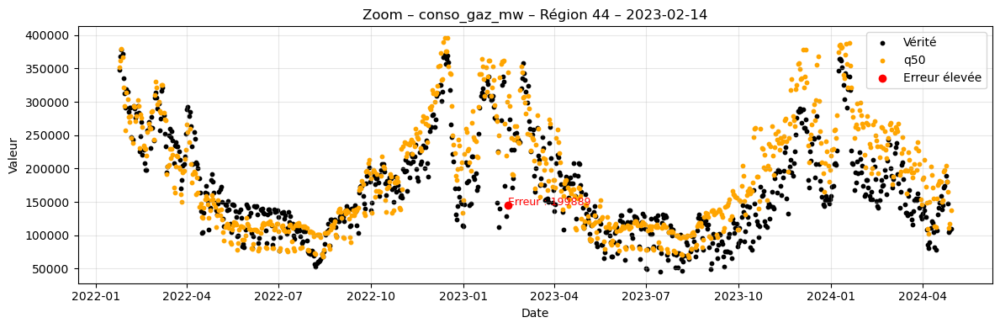

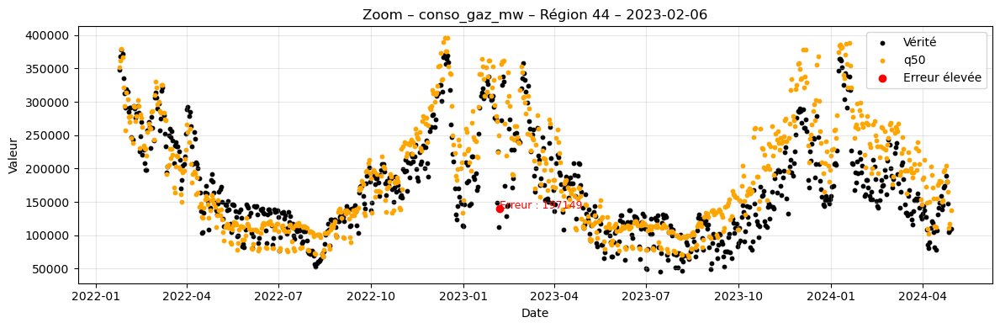

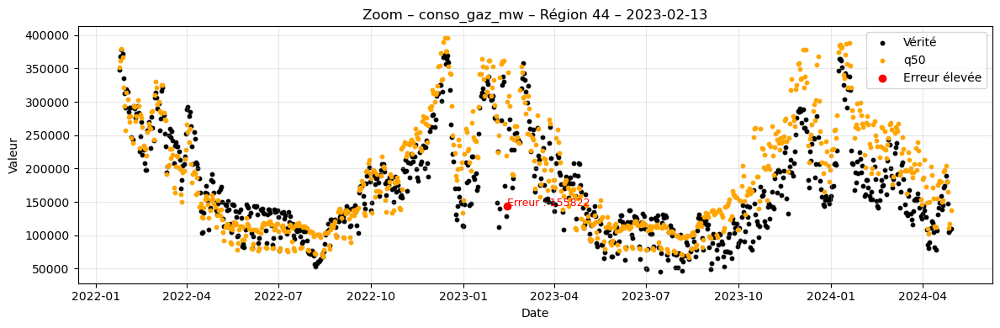

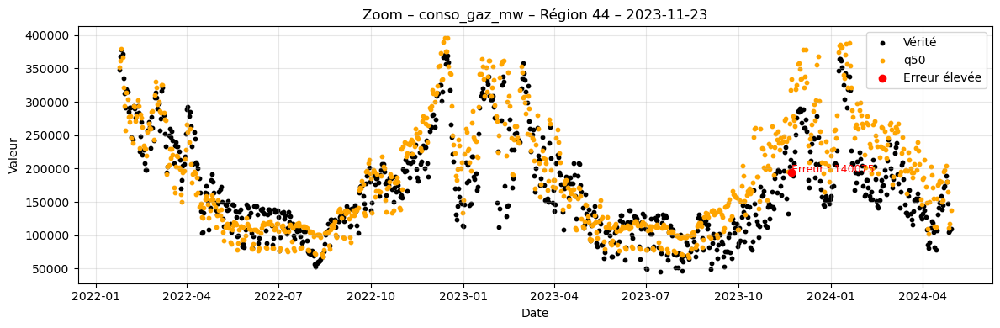

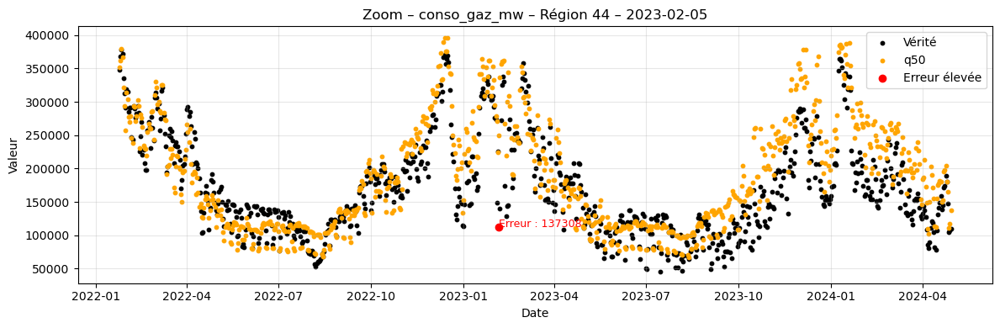

In [ ]:
for target in ["conso_elec_mw", "conso_gaz_mw"]:
    for region in df_visu["insee_region"].unique():
        df_region = df_visu[df_visu["insee_region"] == region].copy()

        try:
            y_true = df_region[target]
            y_pred = df_region[f"{target}_q50"]
            mae = np.abs(y_true - y_pred)

            #  Top 5 erreurs absolues
            top5_idx = mae.nlargest(5).index
            worst_days = df_region.loc[top5_idx, ["date", target]].assign(
                q50=y_pred[top5_idx], erreur=mae[top5_idx]
            )
            print(f"\n Top 5 erreurs – {target} – Région {region}")
            print(worst_days)

            #  Visualisation avec scatter
            for idx in top5_idx:
                day = df_region.loc[idx, "date"]
                fig, ax = plt.subplots(figsize=(12, 4))

                ax.scatter(df_region["date"], y_true, label="Vérité", color="black", s=10)
                ax.scatter(df_region["date"], y_pred, label="q50", color="orange", s=10)

                ax.scatter(day, y_true.loc[idx], color="red", label="Erreur élevée", zorder=5)
                ax.text(day, y_true.loc[idx], f"Erreur : {int(mae.loc[idx])}", color="red", fontsize=9)

                ax.set_title(f"Zoom – {target} – Région {region} – {day.date()}")
                ax.set_xlabel("Date")
                ax.set_ylabel("Valeur")
                ax.legend()
                ax.grid(alpha=0.3)
                plt.tight_layout()
                plt.show()

        except KeyError as e:
            print(f" Donnée manquante pour {target} dans la région {region} : {e}")